# <font color='#ff5748'>***dynamic_model***</font>
---

## <font color='#18A558'>***Libraries***</font>
---

In [ ]:
import random
import pickle
import hashlib
import seaborn as sns
from json import dumps
import lightgbm as ltb
from kafka import KafkaConsumer
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.metrics import f1_score
import pandas as pd, numpy as np ,re
from sklearn.metrics import accuracy_score
from matplotlib.colors import ListedColormap
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import mutual_info_classif

## <font color='#18A558'>***Functions***</font>
---

In [ ]:
# to read the data set
def readDataSet(DataSet_name, Sheet_Name):    # to read the of these files (csv, xls, xlsx) as a dataframe.
    Extension = re.findall('((.csv)|(.xls)|(.xlsx))', DataSet_name)
    Extension = str(Extension)
    if '.csv' in Extension:
        Extension = '.csv'
    elif '.xls' in Extension:
        Extension = '.xls'
    elif '.xlsx' in Extension:
        Extension = '.xlsx'
    if Extension == ('.xls' or '.xlsx'):
        DataFrame = pd.read_excel(DataSet_name, sheet_name = Sheet_Name)
    elif Extension == '.csv':
        DataFrame = pd.read_csv(DataSet_name)
    return DataFrame

# to plot lines
def Plot(X,Y,Label,Color, Marker , S , Xlabel , Ylabel , Title):
    plt.plot(X, Y, label = Label, c = Color)
    plt.scatter(X,Y, c=Color, marker = Marker , s=S)
    plt.xlabel(Xlabel)
    plt.ylabel(Ylabel)
    plt.title(Title)
    plt.legend()
    return plt

# cm
def ConfusionMatrix(Y_Actual, Y_Pred):
    CF = confusion_matrix(Y_Actual, Y_Pred)
    return CF

# Plot confusion matrix
def PLOT_ConfusionMatrix(CF,Title):
    sns.heatmap(CF, annot=True, fmt='d')
    plt.title(Title, fontsize = 15)
    plt.xlabel('Predicted', fontsize = 15)
    plt.ylabel('Actual', fontsize = 15)
    return plt.show()

# Plot Decision Boundary
def Boundaries(X, Classifier, Title , numberOfClasses):
        colorsOptions = ['#FF00AE','blue','#8941FF','#00FF0F','#FF0000','#000000','#0B9397','#1B49CD','#11AF29','#560078','#ED036A']
        colors = colorsOptions[0:numberOfClasses]
        
        plt.figure(figsize=(8, 8), dpi=80)
        X_Axis = X.values
        X1, Y1 = np.meshgrid(np.arange(start = X_Axis[: ,0].min() - 0.1, stop = X_Axis.max() + 0.1, step = 0.01),
                             np.arange(start = X_Axis[: ,1].min() - 0.1, stop = X_Axis.max() + 0.1, step = 0.01))
        
        plt.contourf(X1, Y1, Classifier.predict(np.array([X1.ravel(), Y1.ravel()]).T).reshape(X1.shape),
                     alpha = 0.2, cmap =  ListedColormap(colors))
        plt.xlim(X1.min(), X1.max())
        plt.ylim(Y1.min(), Y1.max())
        
        plt.title(Title, fontsize = 15)
        return plt

# Plot Data Points
def PlotDataPoints(numberOfClasses,colorsOpt ,ListOFClasses, XLabel, Ylabel ,labels ,S, Title):
    MarkersOptions = ['o']
    
    for i in range(numberOfClasses):
        plt.scatter(x = ListOFClasses[i].iloc[:, 0:1], y = ListOFClasses[i].iloc[:, 1:2], c=colorsOpt[i], marker = MarkersOptions[0], s=S, label = labels[i])

    plt.xlabel(XLabel, fontsize = 15)
    plt.ylabel(Ylabel, fontsize = 15)
    plt.title(Title)
    #plt.legend()
    return plt

# get the each class records in list of lists
def GetListOfClasses(numberOfClasses, x, y):
        ls = [None] * numberOfClasses
        df = pd.DataFrame()
        df = pd.concat([pd.DataFrame(x), pd.DataFrame(y)],axis=1 , ignore_index = True).astype(float)
        
        ls_names = []
        
        for i in range(len(df.columns)):
            name = "column" + str(i)
            ls_names.append(name)
            
        df.columns = ls_names
        
        for i in range(0,numberOfClasses):
            ls[i] = df.loc[df["column2"] == i]
        return ls
    
# generate colors
colorsOptions = ['#FF00AE','blue']
# Labels = []
# letters = ["0","1","2","3","4","5","6","7","8","9","a","b","c","d","e","f"]
# for j in range(2):
#     Labels.append(j)
#     colorsOptions.append(''.join(random.choice(letters) for i in range(6)))
#     colorsOptions[j] = '#' + colorsOptions[j]

## <font color='#18A558'>***Static Dataset Preprocessing***</font>
---

In [ ]:
Static_dataset = readDataSet('Static_dataset.csv', 'Static_dataset')
columns_names = Static_dataset.columns

# Null Values
Static_dataset = Static_dataset.dropna()
print(len(Static_dataset))
Static_dataset = Static_dataset.reset_index(drop=True)

268066


In [ ]:
# since i will not use time series model i will drop the timestamp column
Static_dataset = Static_dataset.iloc[:, 1:]

In [ ]:
# Hashing
Static_dataset['longest_word_hash'] = Static_dataset['longest_word'].apply(
    lambda variable: 
        hashlib.md5(variable.encode()).hexdigest()
)

Static_dataset['sld_hash'] = Static_dataset['sld'].apply(
    lambda variable:
        hashlib.md5(variable.encode()).hexdigest()
)

Static_dataset['longest_word_hash'] = Static_dataset['longest_word_hash'].apply(
    lambda variable: 
        int(variable, base=16)
)

Static_dataset['sld_hash'] = Static_dataset['sld_hash'].apply(
    lambda variable: 
        int(variable, base=16)
)

Static_dataset['longest_word_hash'] = Static_dataset['longest_word_hash'].astype(float)
Static_dataset['sld_hash'] = Static_dataset['sld_hash'].astype(float)

Static_dataset = Static_dataset.drop(['longest_word', 'sld'], axis=1)

Static_dataset.dtypes

FQDN_count             int64
subdomain_length       int64
upper                  int64
lower                  int64
numeric                int64
entropy              float64
special                int64
labels                 int64
labels_max             int64
labels_average       float64
len                    int64
subdomain              int64
Target Attack          int64
longest_word_hash    float64
sld_hash             float64
dtype: object

In [ ]:
# X and Y
y = Static_dataset.iloc[:, [12]]
x = Static_dataset.drop(['Target Attack'], axis=1)

y = y.to_numpy().ravel()
x = x.to_numpy()

In [ ]:
# Feature Selection (Matual Information)
INFO_obj = SelectKBest(mutual_info_classif, k=5)
new_x = INFO_obj.fit_transform(x,y)

In [ ]:
# Normalization
normalizer = MinMaxScaler()
new_x = normalizer.fit_transform(new_x)

In [ ]:
preprocessed_static_dataset = pd.DataFrame()
preprocessed_static_dataset = pd.concat([pd.DataFrame(new_x), pd.DataFrame(y)],axis=1 , ignore_index = True).astype(float)

In [ ]:
preprocessed_static_dataset

,0,1,2,3,4,5
0,0.588151,0.857143,0.833333,0.781875,0.346122,1.0
1,0.637374,0.857143,0.833333,0.781875,0.346122,1.0
2,0.631156,0.857143,0.833333,0.781875,0.346122,0.0
3,0.588151,0.857143,0.833333,0.781875,0.346122,1.0
4,0.677959,0.571429,0.333333,0.960614,0.960429,1.0
...,...,...,...,...,...,...
268061,0.530168,0.285714,0.333333,0.921032,0.012725,0.0
268062,0.637374,0.857143,0.833333,0.781875,0.346122,0.0
268063,0.637374,0.857143,0.833333,0.781875,0.346122,1.0
268064,0.758068,0.285714,0.166667,0.639183,0.163253,0.0


In [ ]:
copy_preprocessed_static_dataset = preprocessed_static_dataset.copy()

## <font color='#18A558'>***Loading the Champion Model***</font>
---

In [ ]:
static_model = pickle.load(open("Champion_Model.pkl", 'rb'))
dynamic_model = pickle.load(open("Champion_Model.pkl", 'rb'))

C:\Users\mm\anaconda3\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator LabelEncoder from version 1.1.3 when using version 1.1.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [ ]:
print(static_model.score(new_x,y))

0.8261062574142188


## <font color='#18A558'>***consumer’s code***</font>
---

In [ ]:
consumer = KafkaConsumer(
    'ml-raw-dns',
    bootstrap_servers="localhost:9092",
    auto_offset_reset='earliest',
    enable_auto_commit=False
)

In [ ]:
for m in consumer:
    x=m.value
    break

In [ ]:
type(x)

bytes

In [ ]:
x

b'"\\u00ef\\u00bb\\u00bftimestamp,FQDN_count,subdomain_length,upper,lower,numeric,entropy,special,labels,labels_max,labels_average,longest_word,sld,len,subdomain,Target Attack\\n"'

## <font color='#18A558'>***Fucntion to append 1000 observations of data streaming***</font>
---

In [ ]:
def append_1000_observations(iteration):
    ls_of_1000_records = []
    i=0
    for m in consumer:
        if i <1000:
            ls_of_1000_records.append(m.value)
            i=i+1
        else:
            break
    print(f"windows number {iteration}")
    return ls_of_1000_records        

## <font color='#18A558'>***Convert the bytes to dataframe records***</font>
---

In [ ]:
def bytes_to_df(streams):
    temp_df = pd.DataFrame()
    rows = []
    for data in streams:
        string_row = eval(data.decode("UTF-8"))
        string_row = string_row.strip()
        row = string_row.split(",")
        rows.append(row)
    temp_df=pd.DataFrame(rows)
    return temp_df

## <font color='#18A558'>***Records Preprocessing Pipeline***</font>
---

In [ ]:
def Preprocessing_Pipeline(dataframe):
    
    # null values
    dataframe = dataframe.dropna()
    dataframe = dataframe.reset_index(drop=True)
    
    # drop timeStamp column
    dataframe = dataframe.iloc[:, 1:]
    
    # Hashing
    dataframe['longest_word_hash'] = dataframe.iloc[:,11].apply(
        lambda variable: 
            hashlib.md5(variable.encode()).hexdigest()
    )

    dataframe['sld_hash'] = dataframe.iloc[:,12].apply(
        lambda variable:
            hashlib.md5(variable.encode()).hexdigest()
    )

    dataframe['longest_word_hash'] = dataframe['longest_word_hash'].apply(
        lambda variable: 
            int(variable, base=16)
    )

    dataframe['sld_hash'] = dataframe['sld_hash'].apply(
        lambda variable: 
            int(variable, base=16)
    )

    dataframe['longest_word_hash'] = dataframe['longest_word_hash'].astype(float)
    dataframe['sld_hash'] = dataframe['sld_hash'].astype(float)

    dataframe = dataframe.drop([11, 12], axis=1)
    
    # X and Y
    y = dataframe.iloc[:, [12]]

    x = dataframe.drop([15], axis=1)

    y = y.to_numpy().ravel()
    x = x.to_numpy()
    
    # Feature Selection (Matual Information)
    INFO_obj = SelectKBest(mutual_info_classif, k=5)
    new_x = INFO_obj.fit_transform(x,y)
    
    # Feature Selection (Matual Information)
    normalizer = MinMaxScaler()
    new_x = normalizer.fit_transform(new_x)
    
    dataframe = pd.DataFrame()
    dataframe = pd.concat([pd.DataFrame(new_x), pd.DataFrame(y)],axis=1 , ignore_index = True).astype(float)
    # print(dataframe)
    return dataframe 

## <font color='#18A558'>***Dynamic model predict 1000 records for each window***</font>
---

In [ ]:
Dynamic_accurices = []
Dynamic_f1_scores = []

for iteration in range(265):
    new1000_records = append_1000_observations(iteration + 1)
    
    df_1000 =  bytes_to_df(new1000_records)
    
    preprocessed_df = Preprocessing_Pipeline(df_1000)
    
    x = preprocessed_df.iloc[:,0:5]
    y = preprocessed_df.iloc[:,5]

    dynamic_preds = dynamic_model.predict(x)
    
    Dynamic_accurices.append(accuracy_score(y,dynamic_preds))
    Dynamic_f1_scores.append(f1_score(y, dynamic_preds, average="macro"))

windows number 1
windows number 2
windows number 3
windows number 4
windows number 5
windows number 6
windows number 7
windows number 8
windows number 9
windows number 10
windows number 11
windows number 12
windows number 13
windows number 14
windows number 15
windows number 16
windows number 17
windows number 18
windows number 19
windows number 20
windows number 21
windows number 22
windows number 23
windows number 24
windows number 25
windows number 26
windows number 27
windows number 28
windows number 29
windows number 30
windows number 31
windows number 32
windows number 33
windows number 34
windows number 35
windows number 36
windows number 37
windows number 38
windows number 39
windows number 40
windows number 41
windows number 42
windows number 43
windows number 44
windows number 45
windows number 46
windows number 47
windows number 48
windows number 49
windows number 50
windows number 51
windows number 52
windows number 53
windows number 54
windows number 55
windows number 56
w

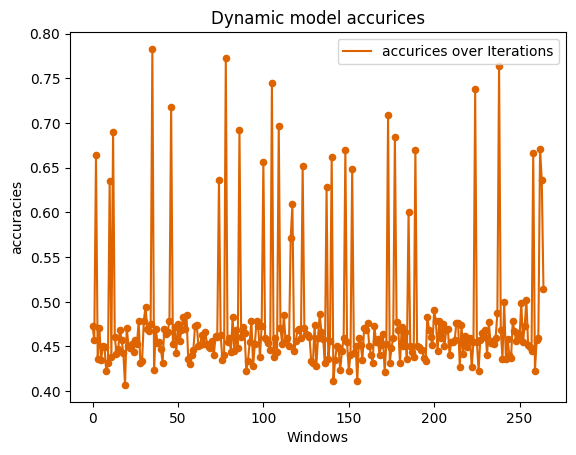

In [ ]:
Plot(range(265),Dynamic_accurices,"accurices over Iterations", "#DD6400", "o", 20, "Windows", "accuracies", "Dynamic model accurices")
plt.show()

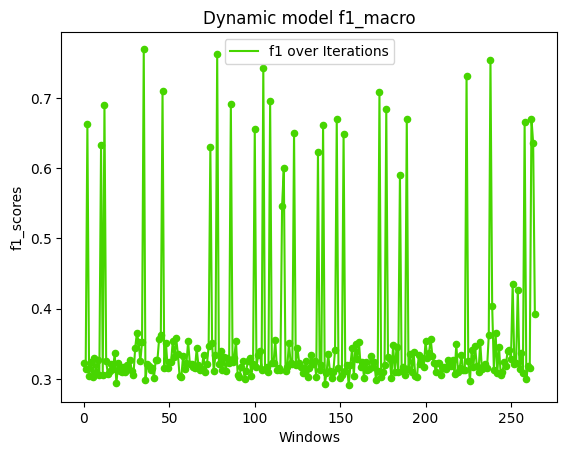

In [ ]:
Plot(range(265),Dynamic_f1_scores,"f1 over Iterations", "#47D500", "o", 20, "Windows", "f1_scores", "Dynamic model f1_macro")
plt.show()

In [ ]:
consumer = KafkaConsumer(
    'ml-raw-dns',
    bootstrap_servers="localhost:9092",
    auto_offset_reset='earliest',
    enable_auto_commit=False
)

## <font color='#18A558'>***Dynamic model predict 1000 records appended to static dataset for each window***</font>
---

In [ ]:
Dynamic_accurices = []
Dynamic_f1_scores = []

for iteration in range(265):
    new1000_records = append_1000_observations(iteration + 1)
    
    df_1000 =  bytes_to_df(new1000_records)
    
    preprocessed_df = Preprocessing_Pipeline(df_1000)
    
    copy_preprocessed_static_dataset = pd.concat([copy_preprocessed_static_dataset, preprocessed_df])
    print("the len of 1000 new records appended to static data set is ",len(copy_preprocessed_static_dataset), "\n")
    
    x = copy_preprocessed_static_dataset.iloc[:,0:5]
    y = copy_preprocessed_static_dataset.iloc[:,5]
    
    dynamic_preds = dynamic_model.predict(x)
    
    Dynamic_accurices.append(accuracy_score(y,dynamic_preds))
    Dynamic_f1_scores.append(f1_score(y, dynamic_preds, average="macro"))

windows number 1
the len of 1000 new records appended to static data set is  269066 

windows number 2
the len of 1000 new records appended to static data set is  270066 

windows number 3
the len of 1000 new records appended to static data set is  271066 

windows number 4
the len of 1000 new records appended to static data set is  272066 

windows number 5
the len of 1000 new records appended to static data set is  273066 

windows number 6
the len of 1000 new records appended to static data set is  274066 

windows number 7
the len of 1000 new records appended to static data set is  275066 

windows number 8
the len of 1000 new records appended to static data set is  276066 

windows number 9
the len of 1000 new records appended to static data set is  277066 

windows number 10
the len of 1000 new records appended to static data set is  278066 

windows number 11
the len of 1000 new records appended to static data set is  279066 

windows number 12
the len of 1000 new records append

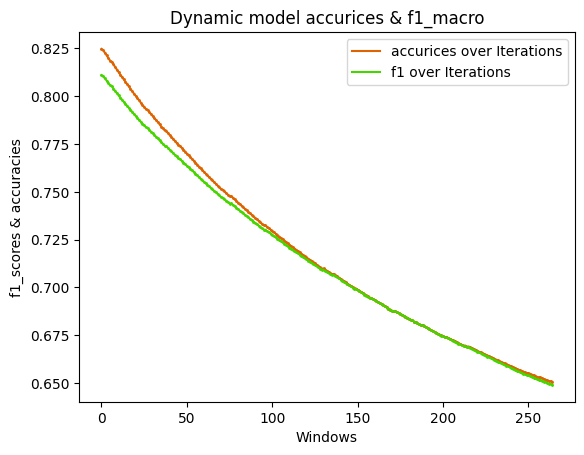

In [ ]:
Plot(range(265),Dynamic_accurices,"accurices over Iterations", "#DD6400", "o", 1, "Windows", "f1_scores & accuracies", "Dynamic model accurices & f1_macro")
Plot(range(265),Dynamic_f1_scores,"f1 over Iterations", "#47D500", "o", 1, "Windows", "f1_scores & accuracies", "Dynamic model accurices & f1_macro")
plt.show()

In [ ]:
consumer = KafkaConsumer(
    'ml-raw-dns',
    bootstrap_servers="localhost:9092",
    auto_offset_reset='earliest',
    enable_auto_commit=False
)

## <font color='#18A558'>***Retraining Dynamic model on 2 the first features of static and kafka dataset (to be able to plot Decision boundary)***</font>
---

windows number 1
the len of 1000 new records appended to static data set is  269066 



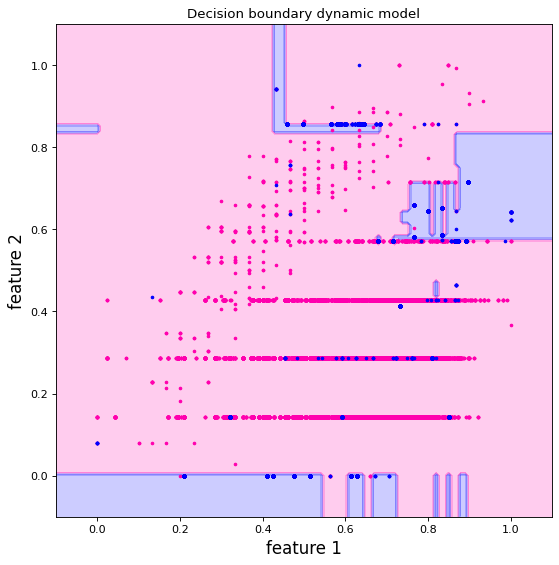

windows number 2
the len of 1000 new records appended to static data set is  270066 



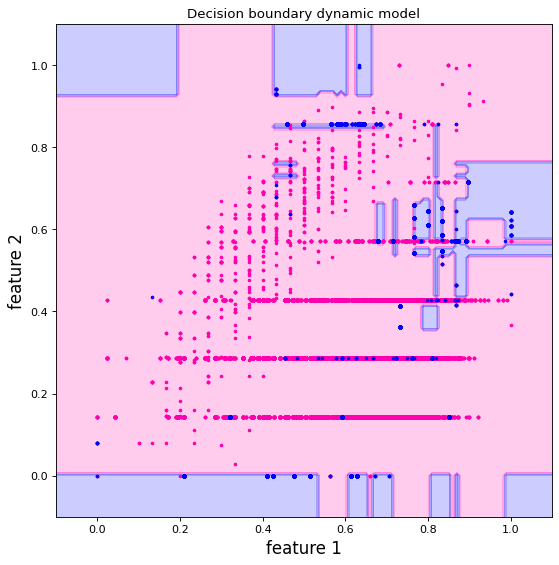

windows number 3
the len of 1000 new records appended to static data set is  271066 



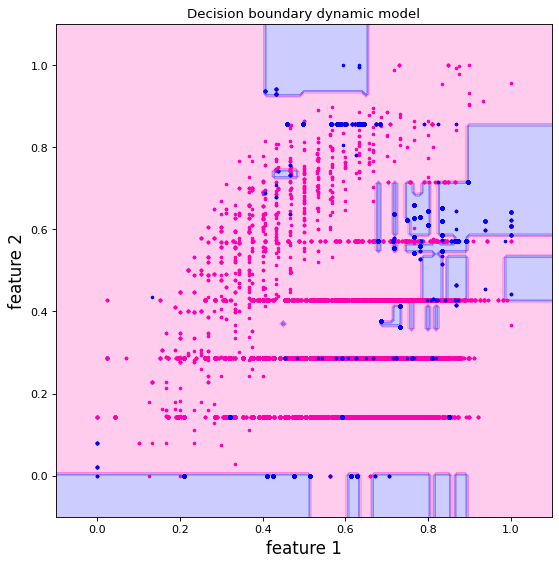

windows number 4
the len of 1000 new records appended to static data set is  272066 



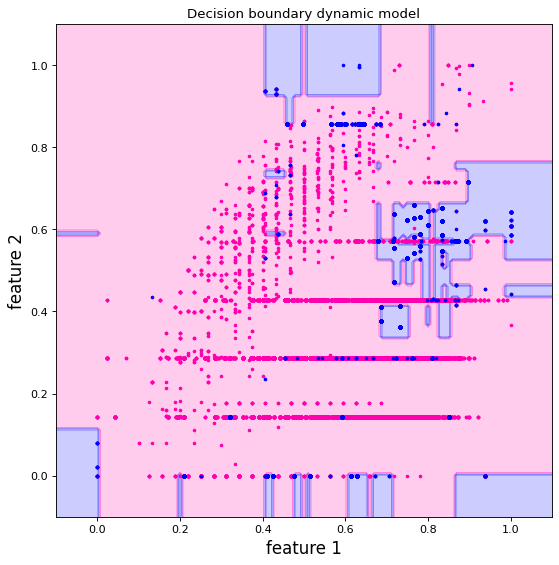

windows number 5
the len of 1000 new records appended to static data set is  273066 



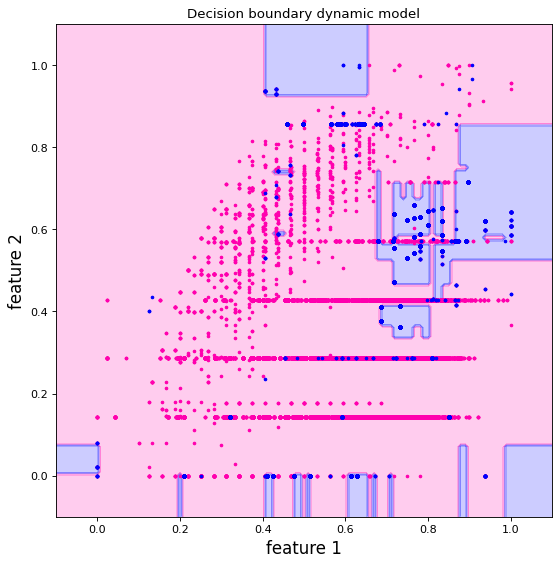

windows number 6
the len of 1000 new records appended to static data set is  274066 



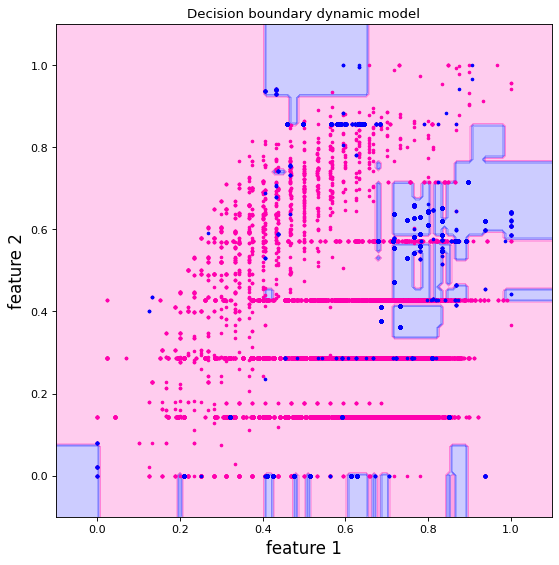

windows number 7
the len of 1000 new records appended to static data set is  275066 



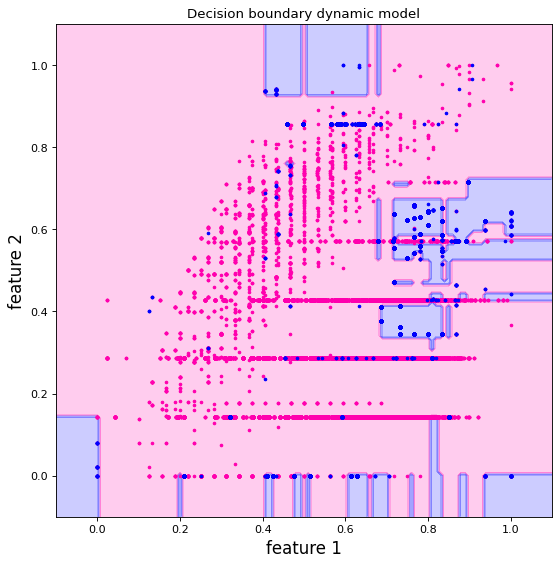

windows number 8
the len of 1000 new records appended to static data set is  276066 



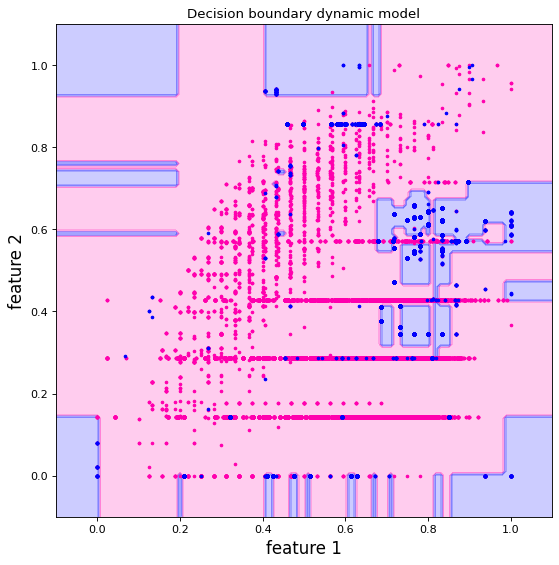

windows number 9
the len of 1000 new records appended to static data set is  277066 



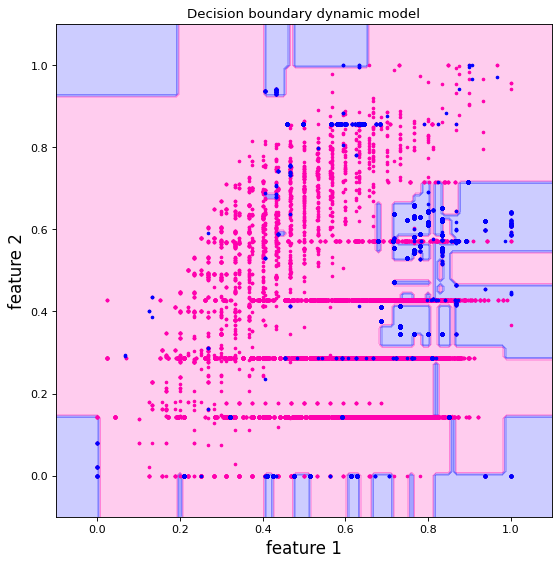

windows number 10
the len of 1000 new records appended to static data set is  278066 



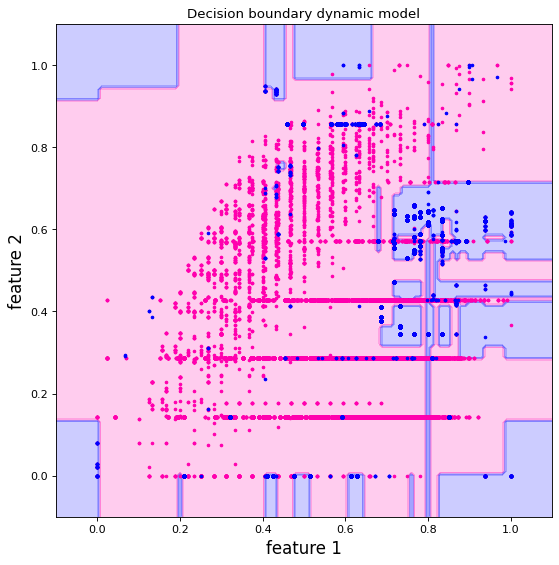

windows number 11
the len of 1000 new records appended to static data set is  279066 



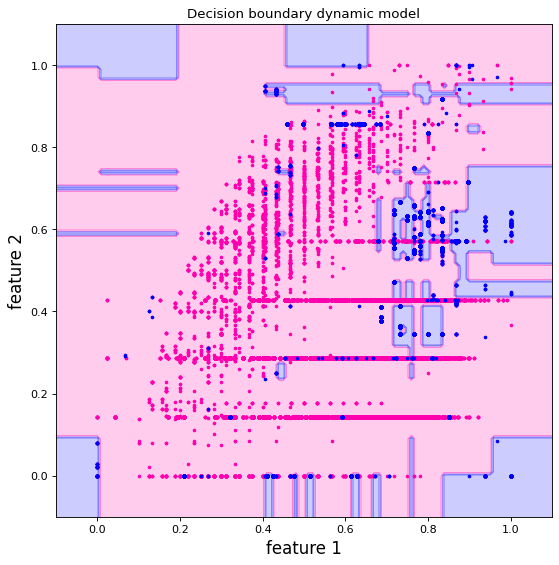

windows number 12
the len of 1000 new records appended to static data set is  280066 



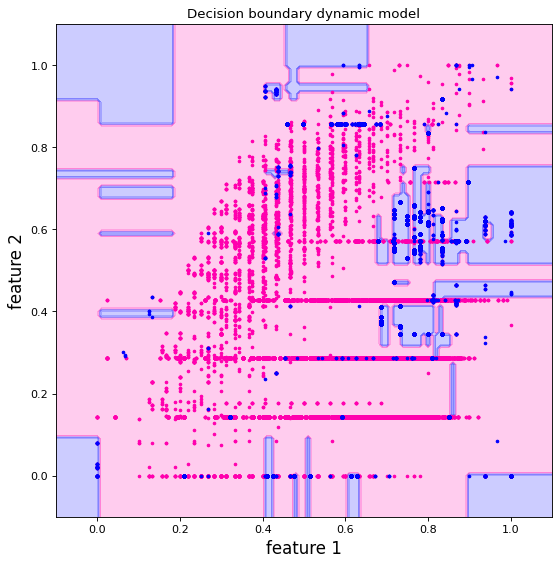

windows number 13
the len of 1000 new records appended to static data set is  281066 



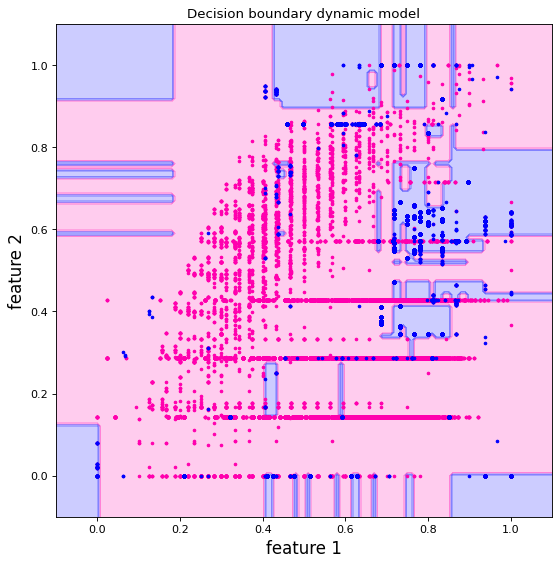

windows number 14
the len of 1000 new records appended to static data set is  282066 



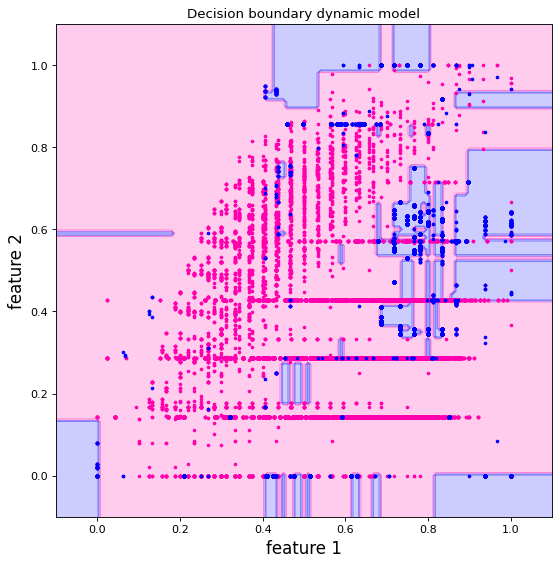

windows number 15
the len of 1000 new records appended to static data set is  283066 



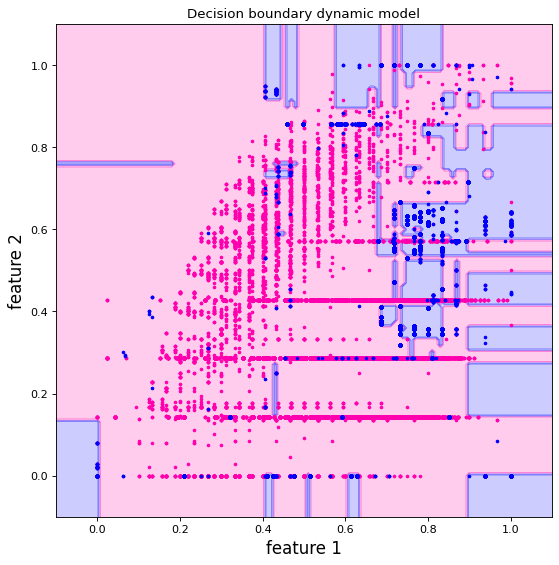

windows number 16
the len of 1000 new records appended to static data set is  284066 



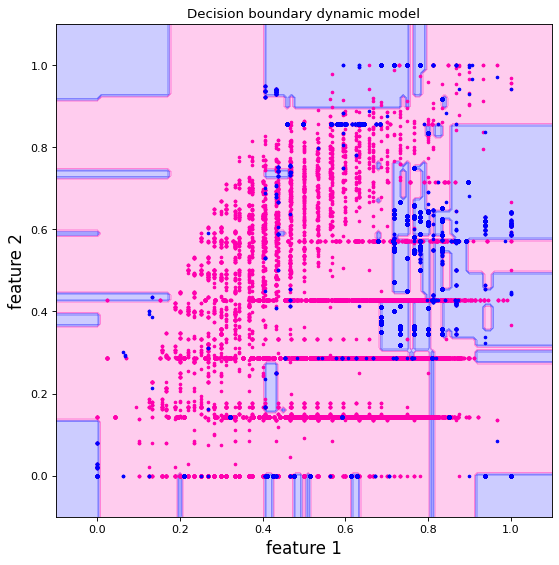

windows number 17
the len of 1000 new records appended to static data set is  285066 



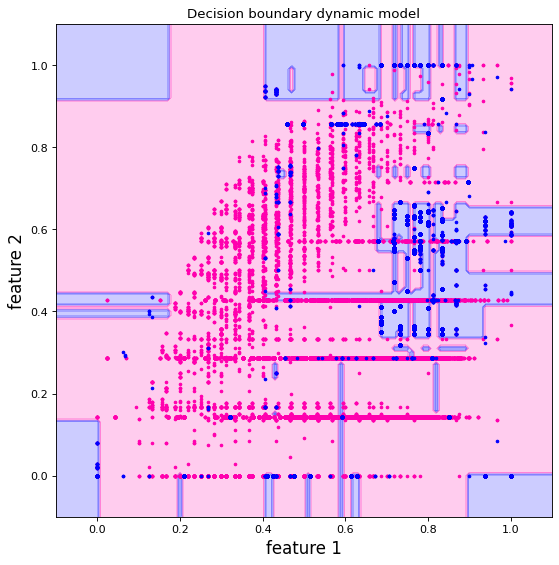

windows number 18
the len of 1000 new records appended to static data set is  286066 



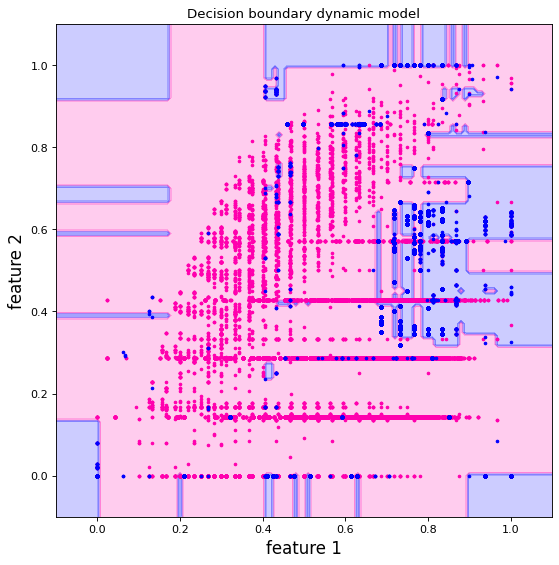

windows number 19
the len of 1000 new records appended to static data set is  287066 



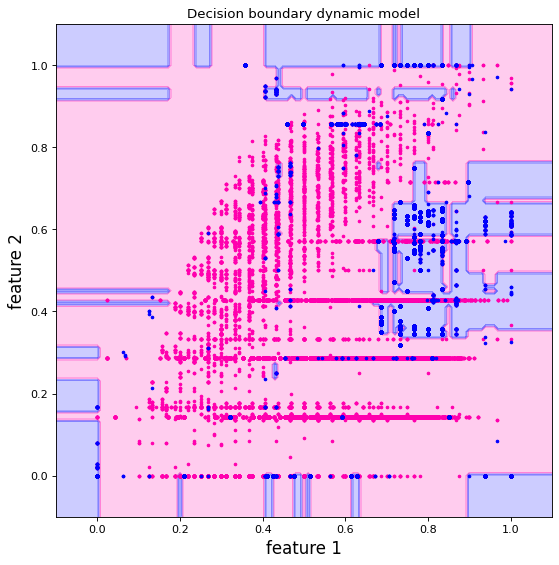

windows number 20
the len of 1000 new records appended to static data set is  288066 



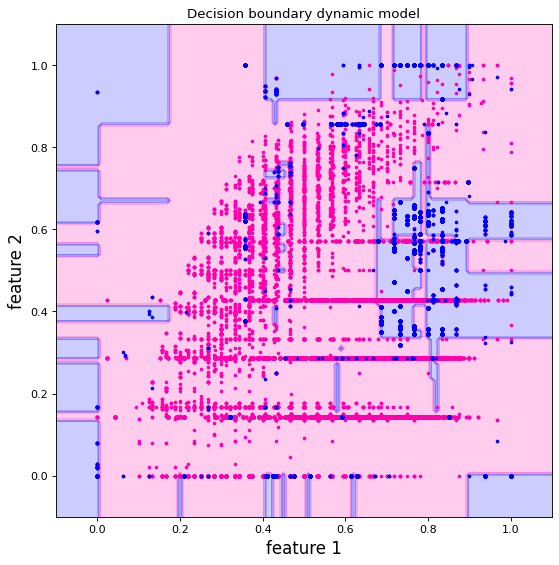

windows number 21
the len of 1000 new records appended to static data set is  289066 



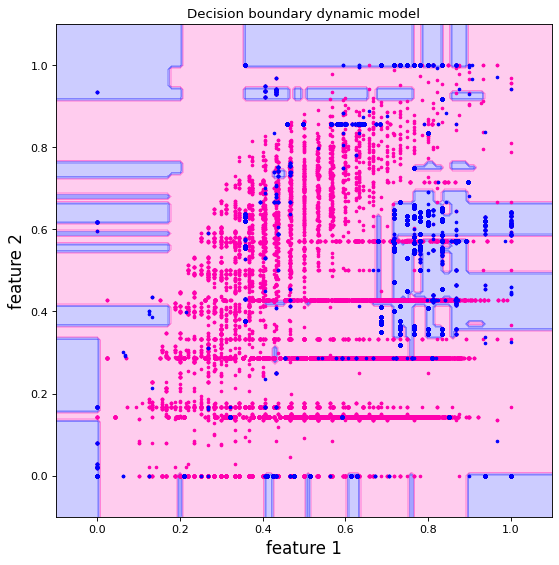

windows number 22
the len of 1000 new records appended to static data set is  290066 



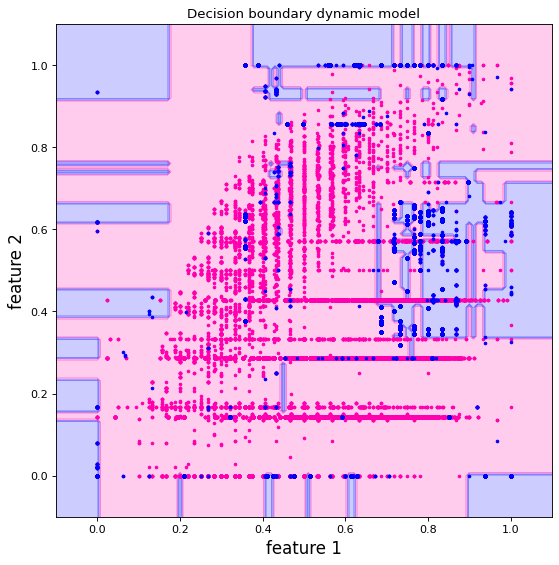

windows number 23
the len of 1000 new records appended to static data set is  291066 



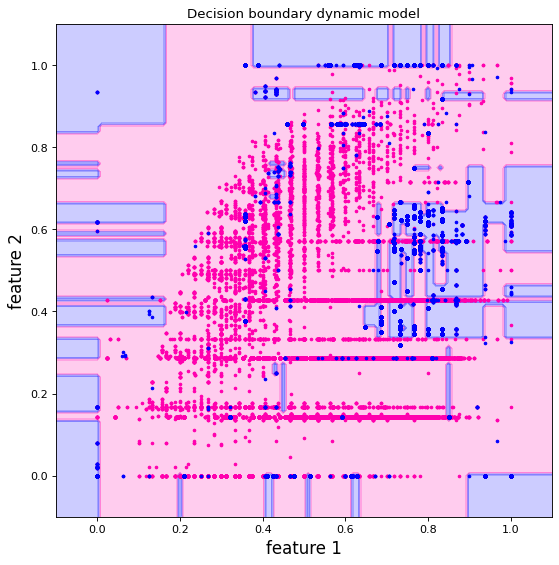

windows number 24
the len of 1000 new records appended to static data set is  292066 



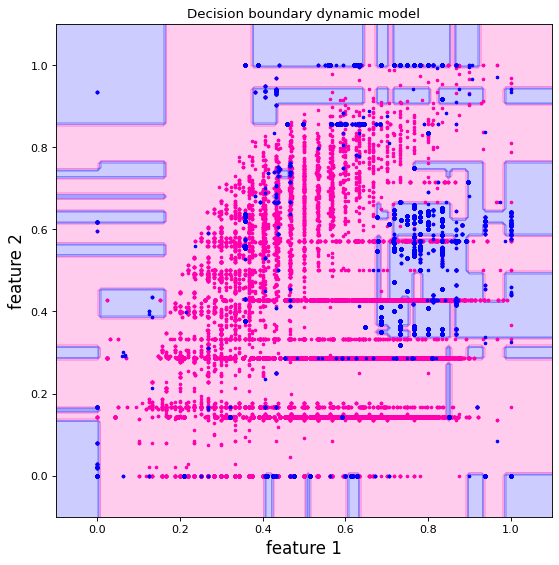

windows number 25
the len of 1000 new records appended to static data set is  293066 



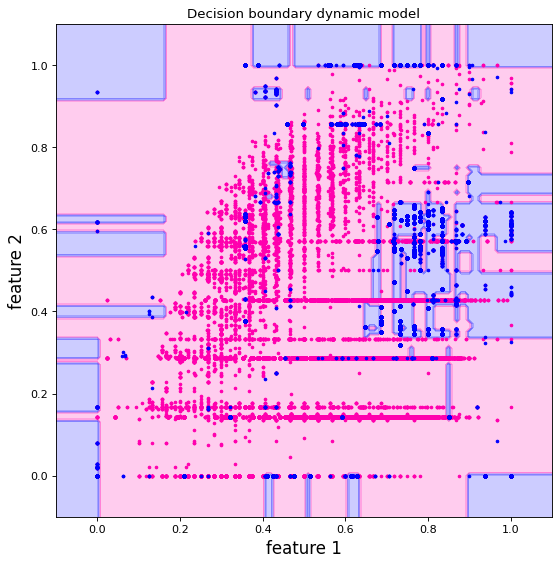

windows number 26
the len of 1000 new records appended to static data set is  294066 



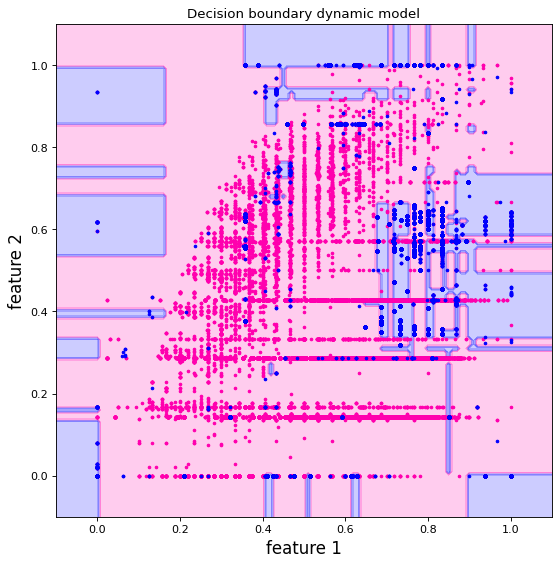

windows number 27
the len of 1000 new records appended to static data set is  295066 



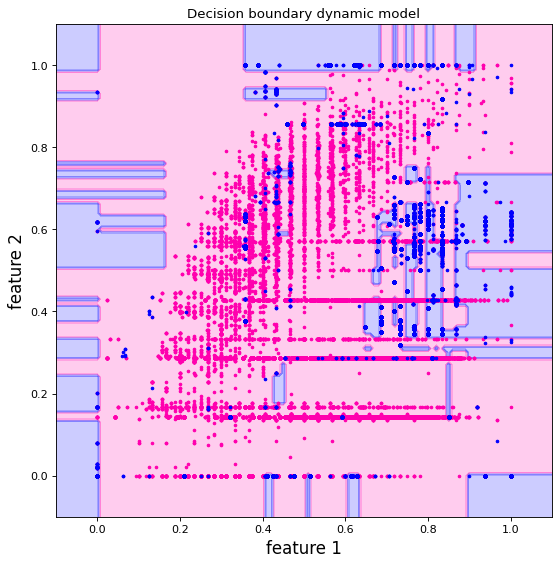

windows number 28
the len of 1000 new records appended to static data set is  296066 



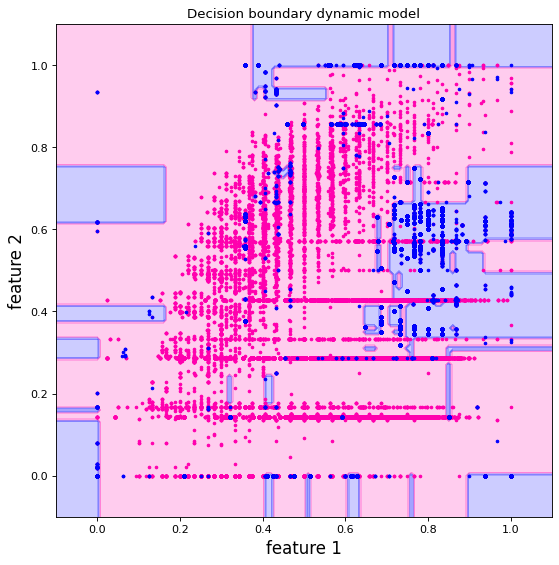

windows number 29
the len of 1000 new records appended to static data set is  297066 



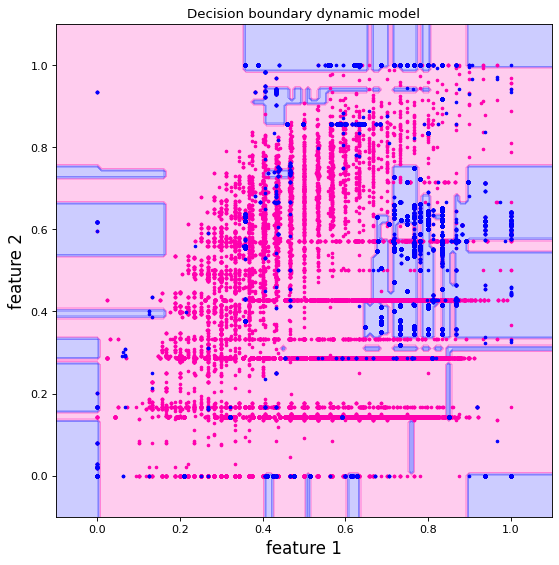

windows number 30
the len of 1000 new records appended to static data set is  298066 



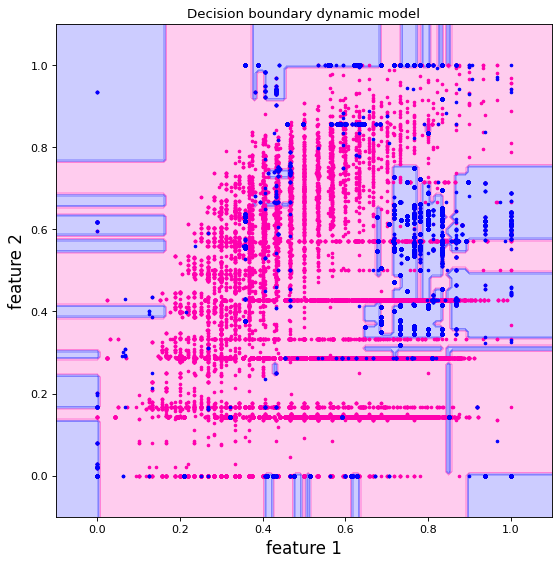

windows number 31
the len of 1000 new records appended to static data set is  299066 



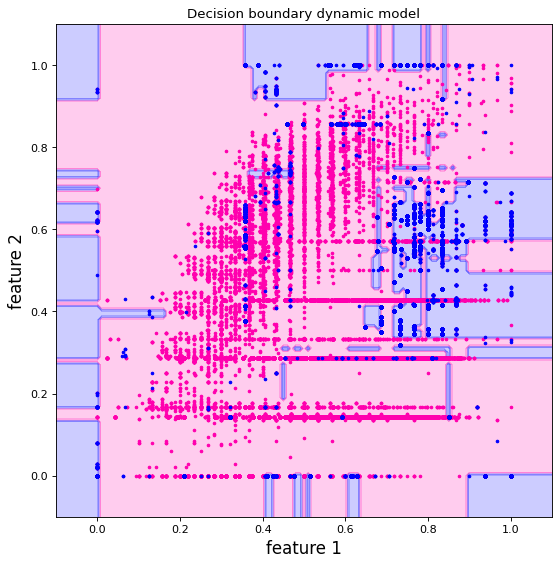

windows number 32
the len of 1000 new records appended to static data set is  300066 



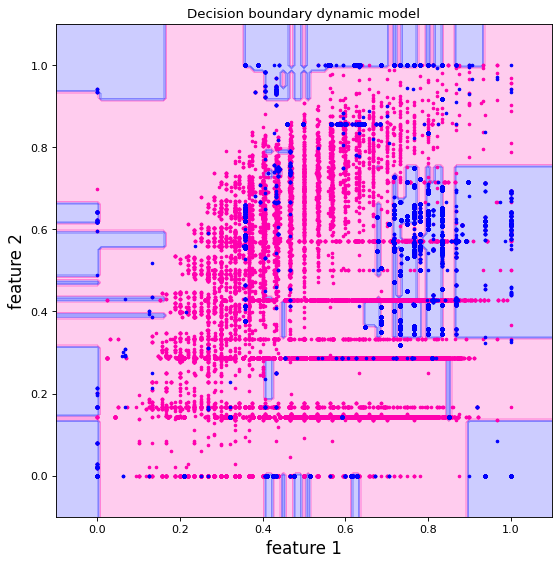

windows number 33
the len of 1000 new records appended to static data set is  301066 



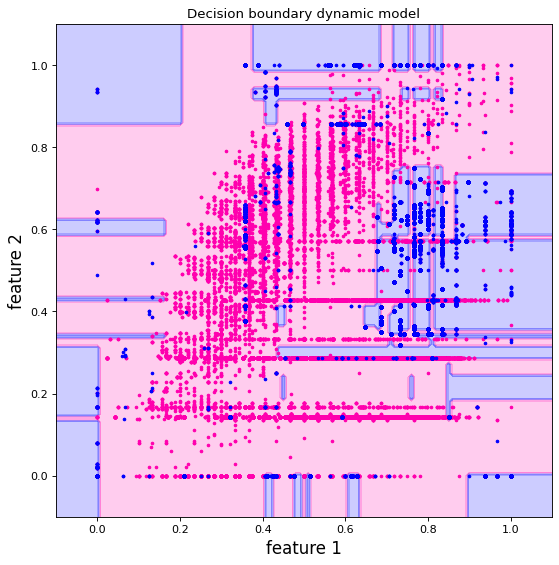

windows number 34
the len of 1000 new records appended to static data set is  302066 



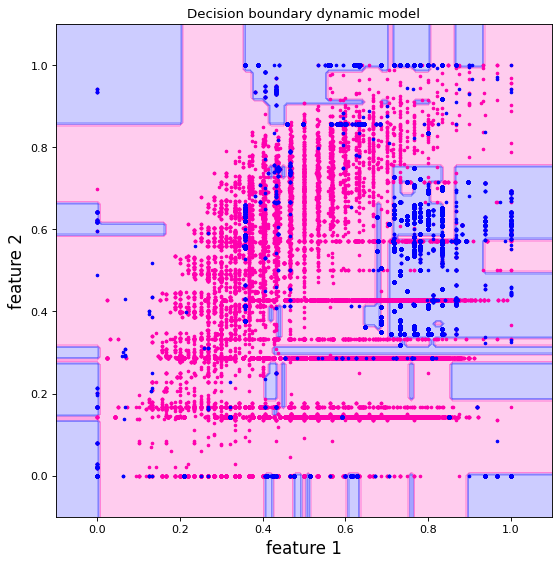

windows number 35
the len of 1000 new records appended to static data set is  303066 



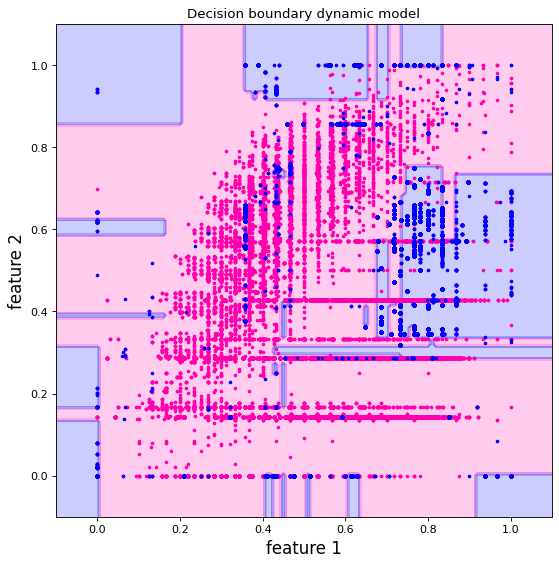

windows number 36
the len of 1000 new records appended to static data set is  304066 



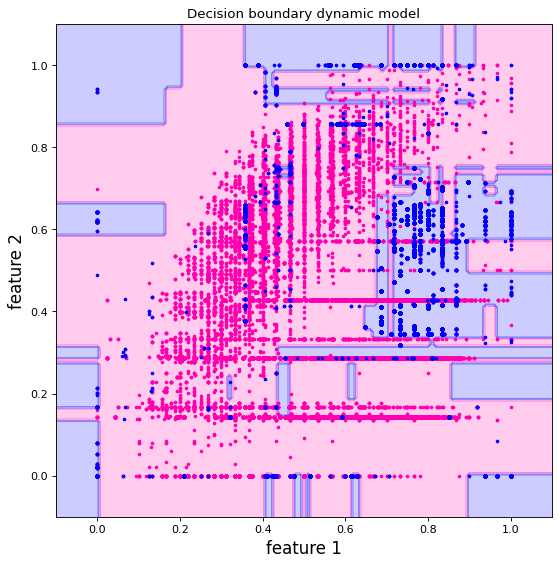

windows number 37
the len of 1000 new records appended to static data set is  305066 



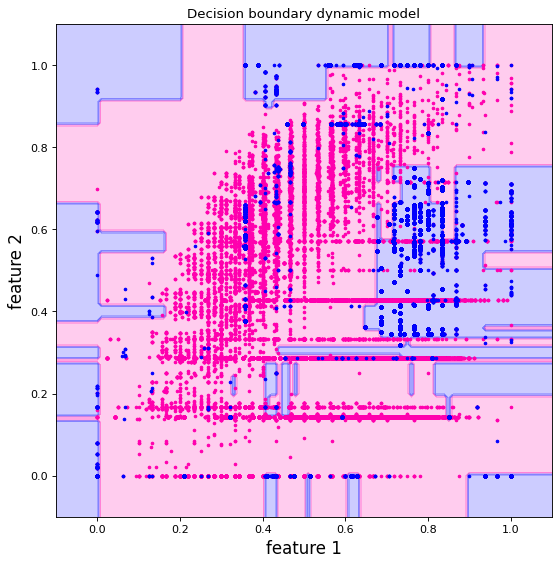

windows number 38
the len of 1000 new records appended to static data set is  306066 



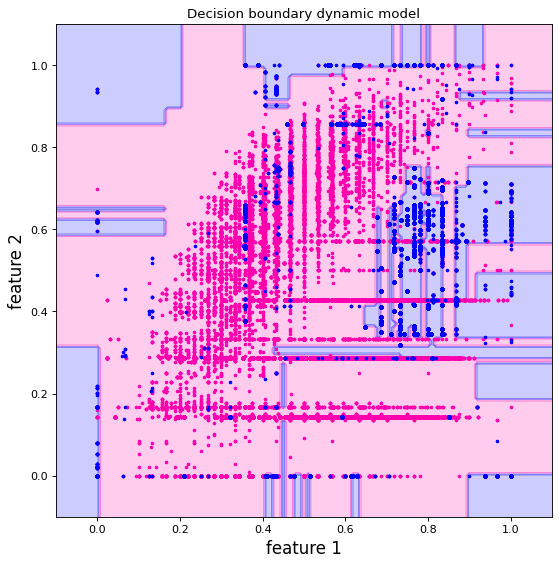

windows number 39
the len of 1000 new records appended to static data set is  307066 



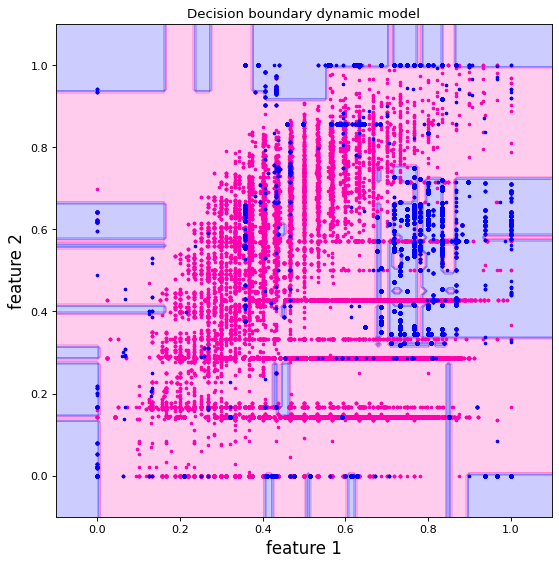

windows number 40
the len of 1000 new records appended to static data set is  308066 



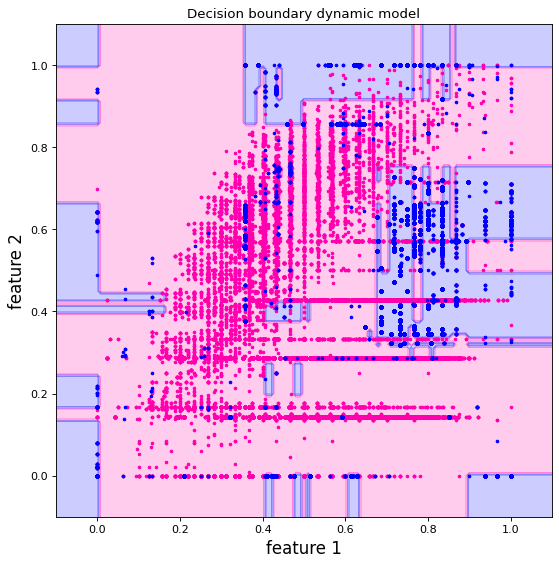

windows number 41
the len of 1000 new records appended to static data set is  309066 



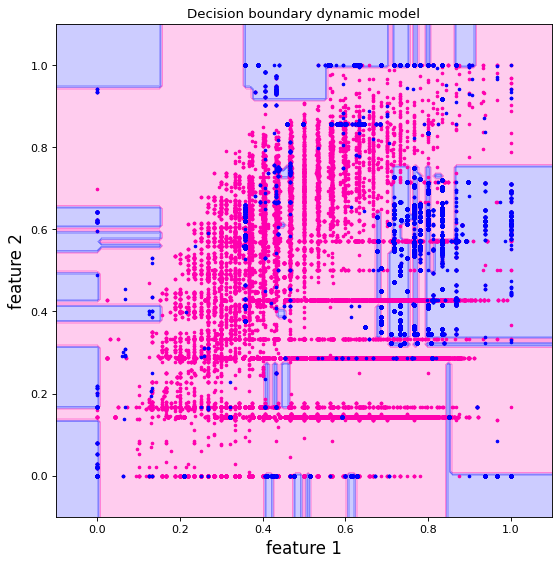

windows number 42
the len of 1000 new records appended to static data set is  310066 



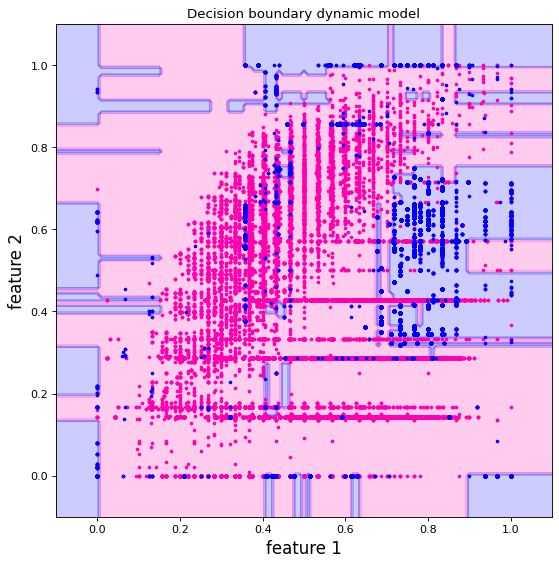

windows number 43
the len of 1000 new records appended to static data set is  311066 



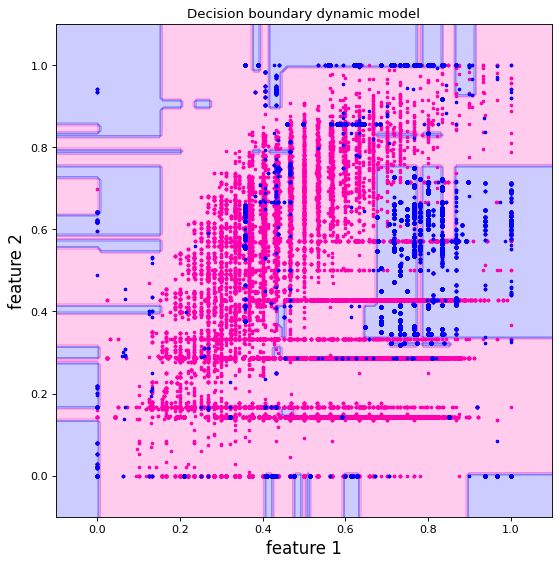

windows number 44
the len of 1000 new records appended to static data set is  312066 



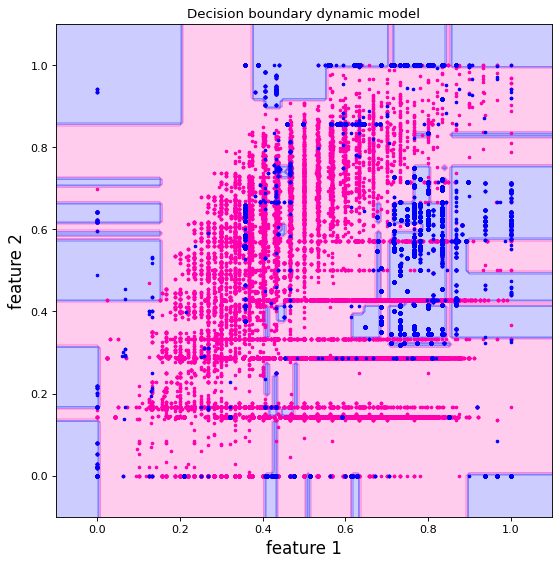

windows number 45
the len of 1000 new records appended to static data set is  313066 



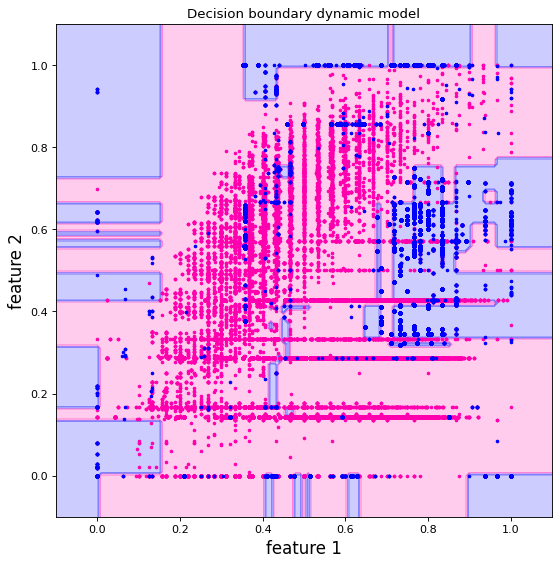

windows number 46
the len of 1000 new records appended to static data set is  314066 



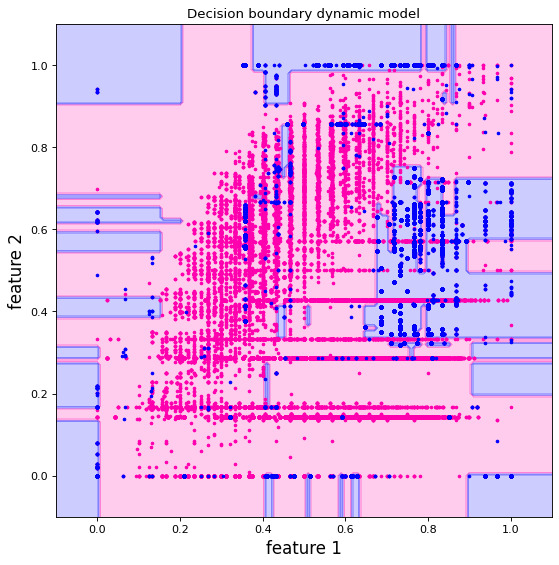

windows number 47
the len of 1000 new records appended to static data set is  315066 



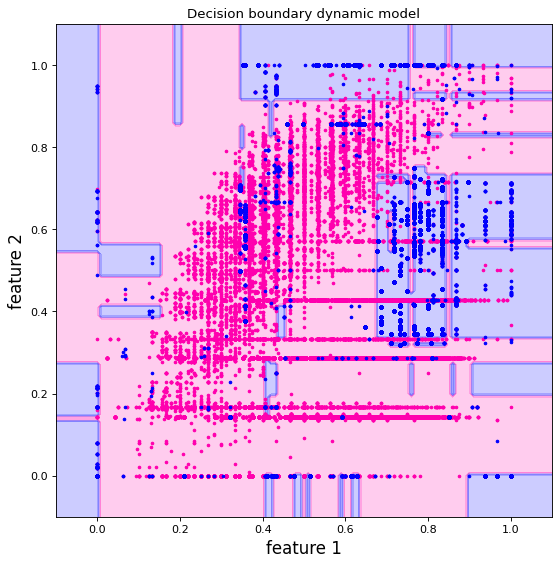

windows number 48
the len of 1000 new records appended to static data set is  316066 



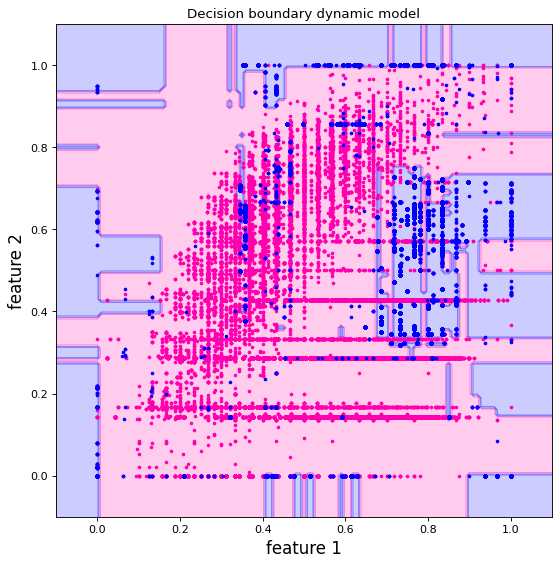

windows number 49
the len of 1000 new records appended to static data set is  317066 



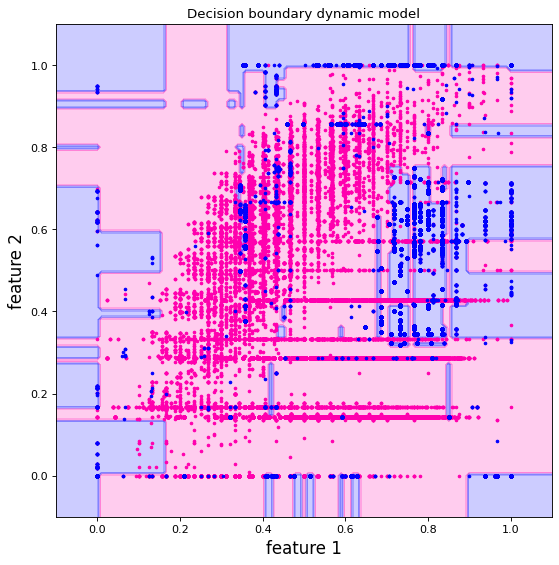

windows number 50
the len of 1000 new records appended to static data set is  318066 



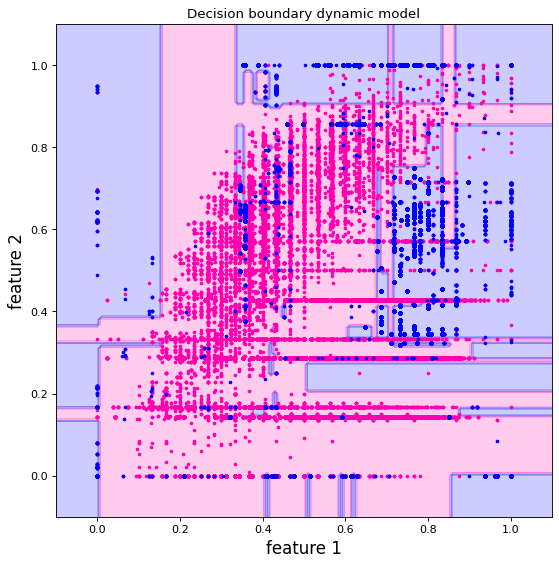

windows number 51
the len of 1000 new records appended to static data set is  319066 



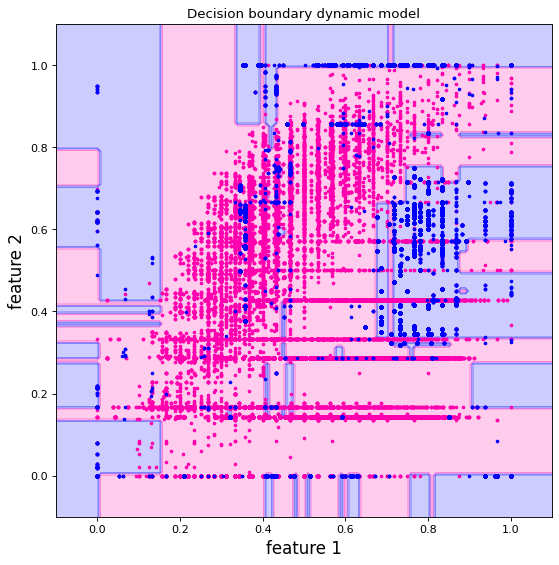

windows number 52
the len of 1000 new records appended to static data set is  320066 



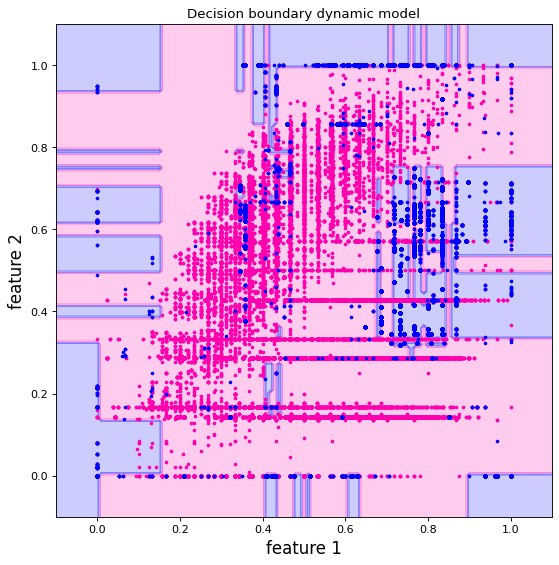

windows number 53
the len of 1000 new records appended to static data set is  321066 



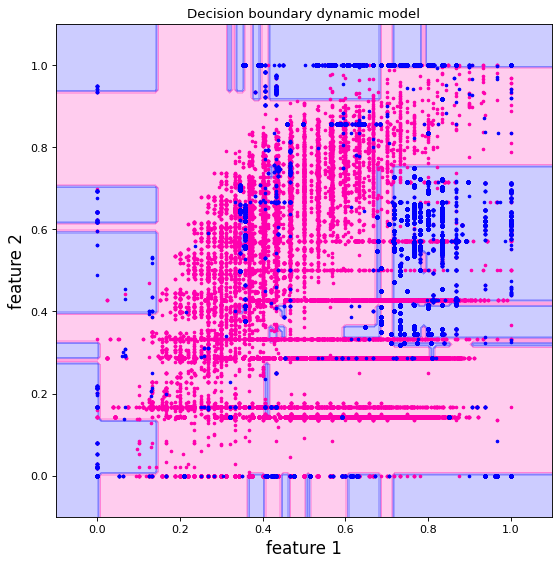

windows number 54
the len of 1000 new records appended to static data set is  322066 



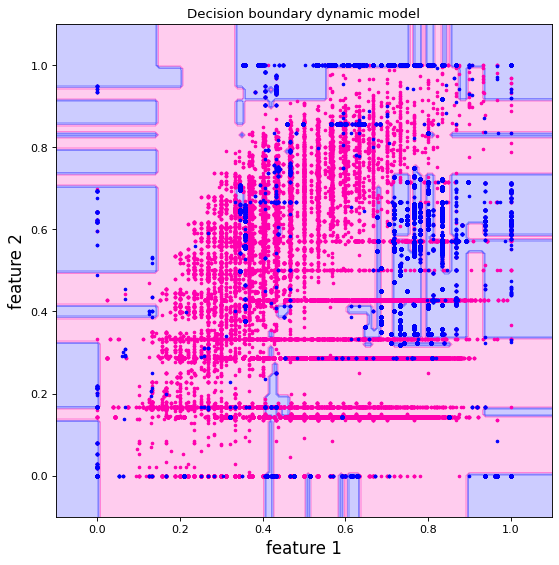

windows number 55
the len of 1000 new records appended to static data set is  323066 



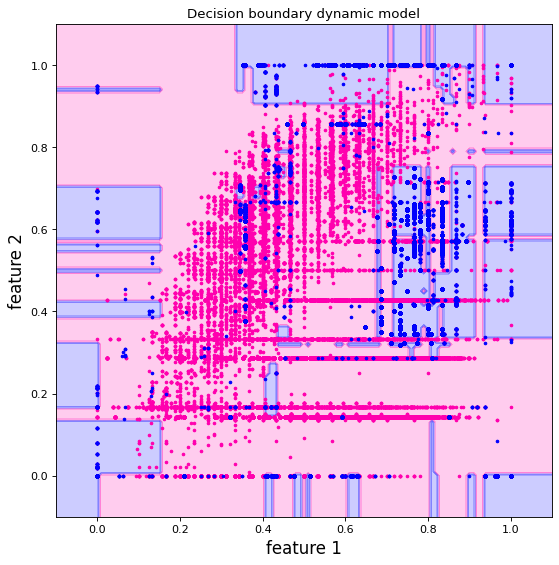

windows number 56
the len of 1000 new records appended to static data set is  324066 



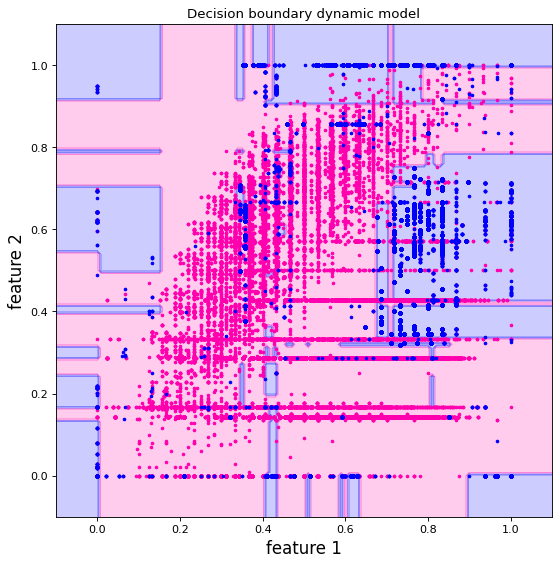

windows number 57
the len of 1000 new records appended to static data set is  325066 



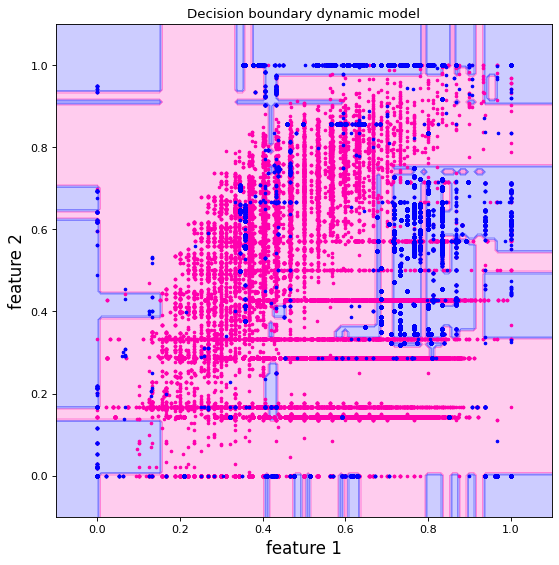

windows number 58
the len of 1000 new records appended to static data set is  326066 



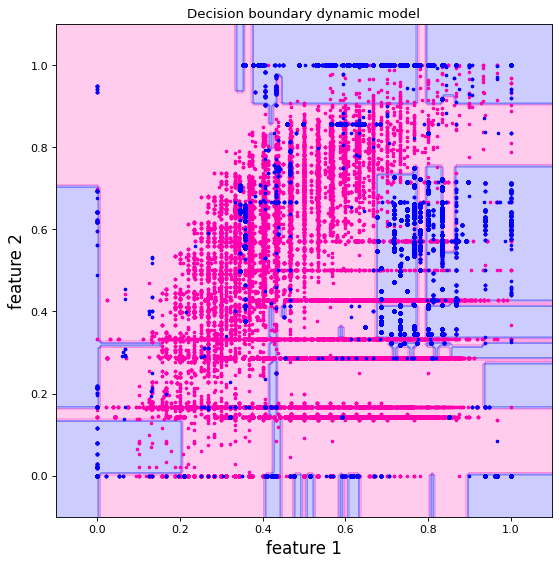

windows number 59
the len of 1000 new records appended to static data set is  327066 



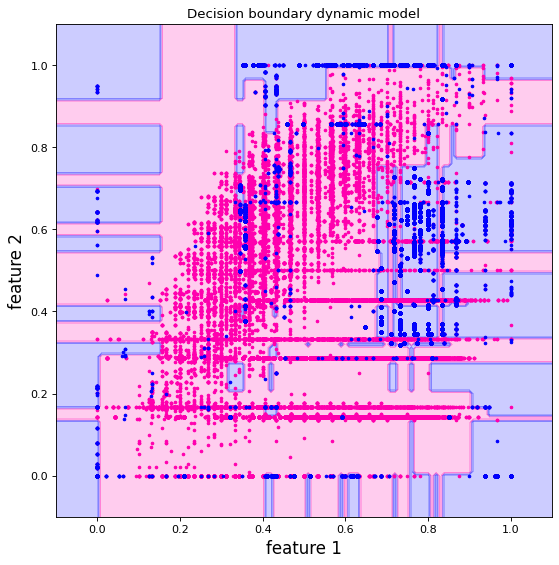

windows number 60
the len of 1000 new records appended to static data set is  328066 



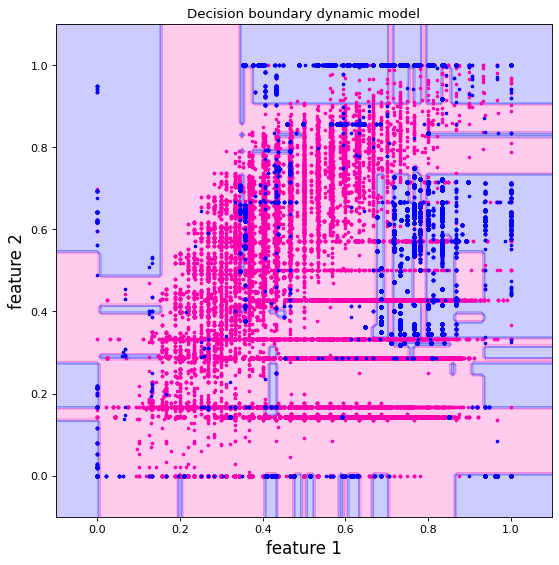

windows number 61
the len of 1000 new records appended to static data set is  329066 



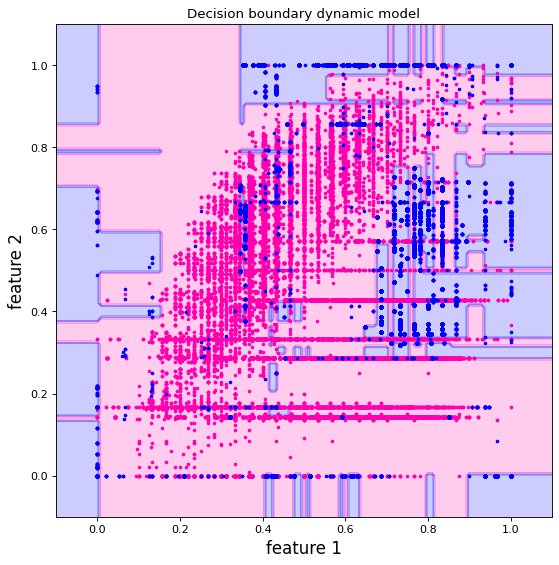

windows number 62
the len of 1000 new records appended to static data set is  330066 



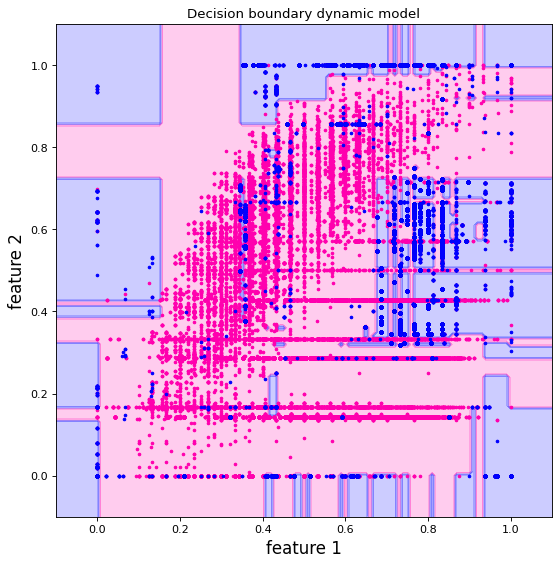

windows number 63
the len of 1000 new records appended to static data set is  331066 



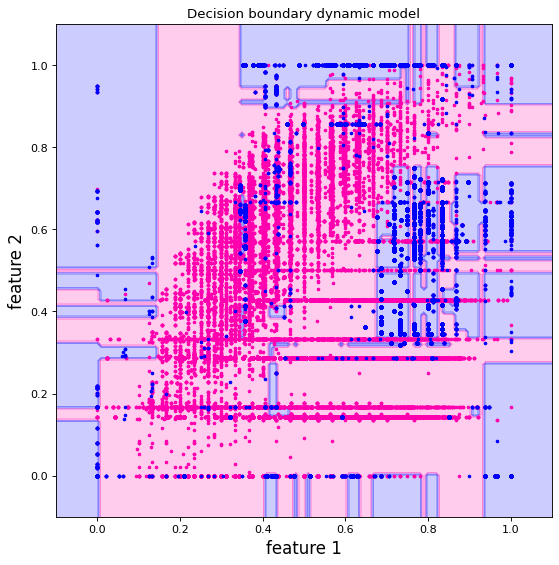

windows number 64
the len of 1000 new records appended to static data set is  332066 



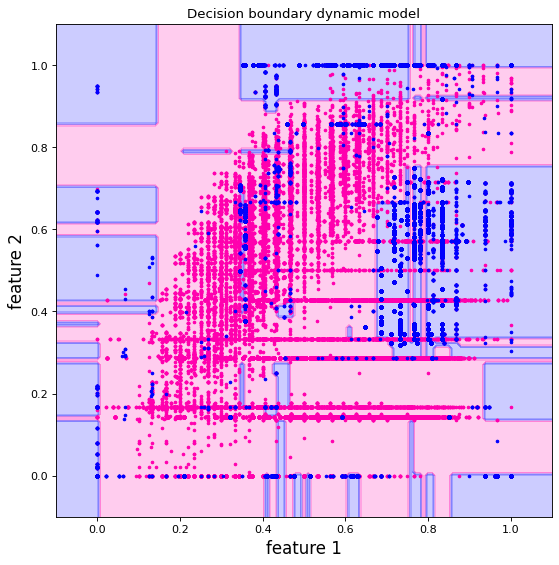

windows number 65
the len of 1000 new records appended to static data set is  333066 



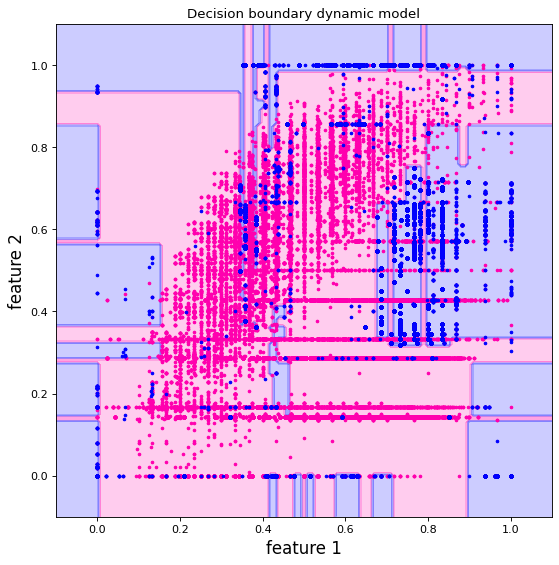

windows number 66
the len of 1000 new records appended to static data set is  334066 



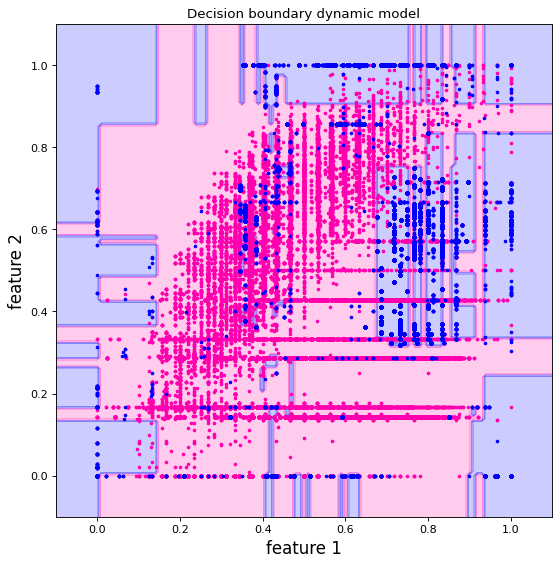

windows number 67
the len of 1000 new records appended to static data set is  335066 



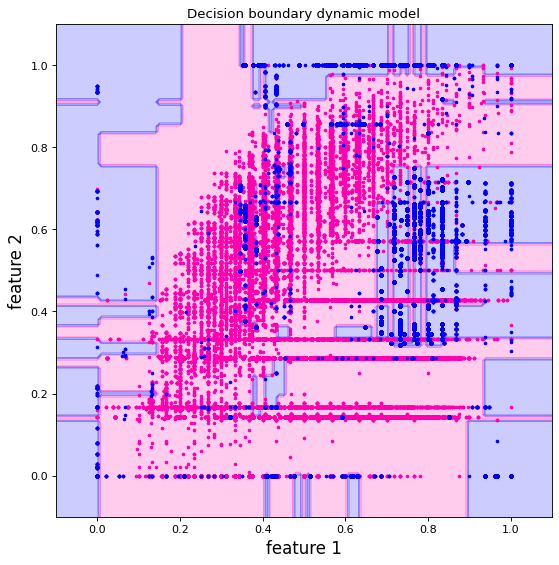

windows number 68
the len of 1000 new records appended to static data set is  336066 



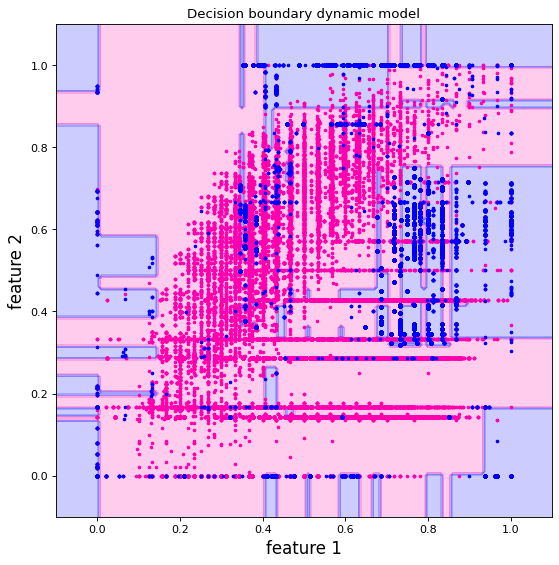

windows number 69
the len of 1000 new records appended to static data set is  337066 



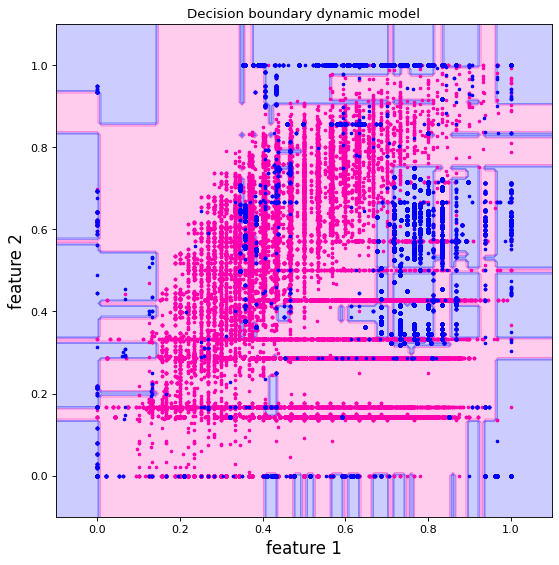

windows number 70
the len of 1000 new records appended to static data set is  338066 



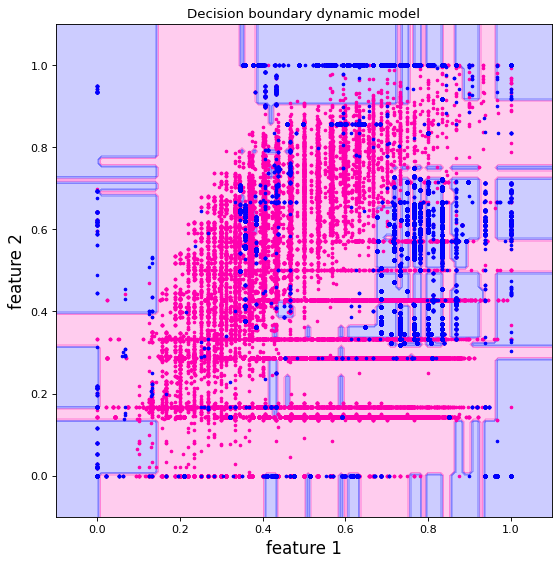

windows number 71
the len of 1000 new records appended to static data set is  339066 



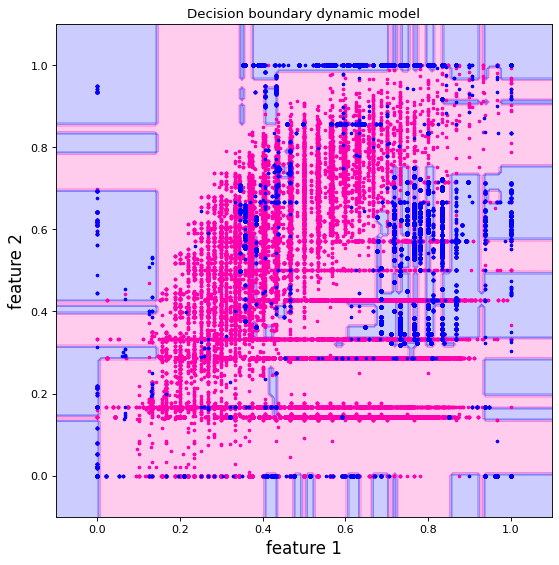

windows number 72
the len of 1000 new records appended to static data set is  340066 



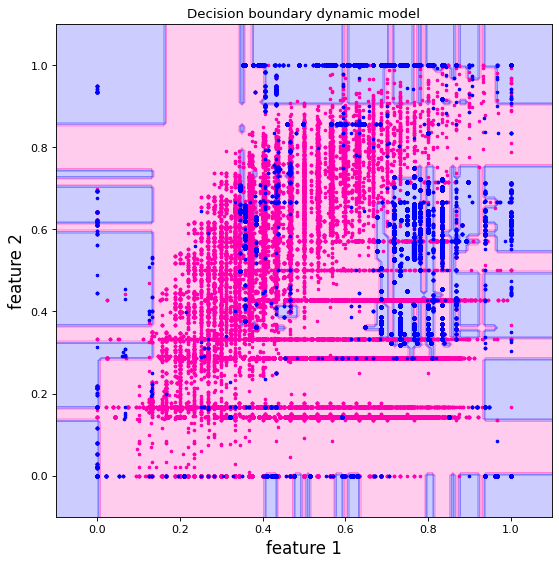

windows number 73
the len of 1000 new records appended to static data set is  341066 



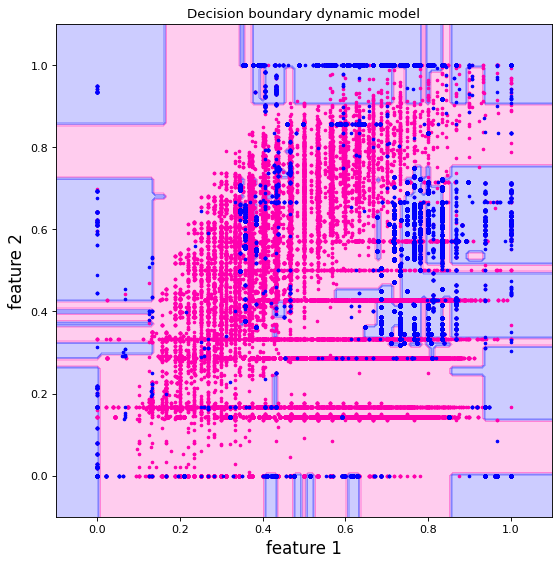

windows number 74
the len of 1000 new records appended to static data set is  342066 



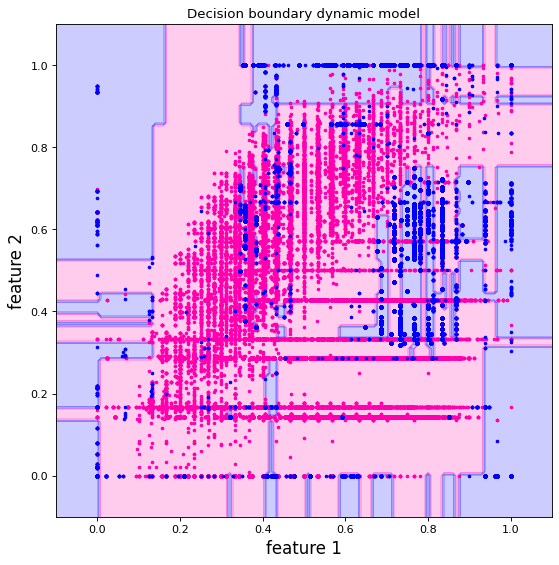

windows number 75
the len of 1000 new records appended to static data set is  343066 



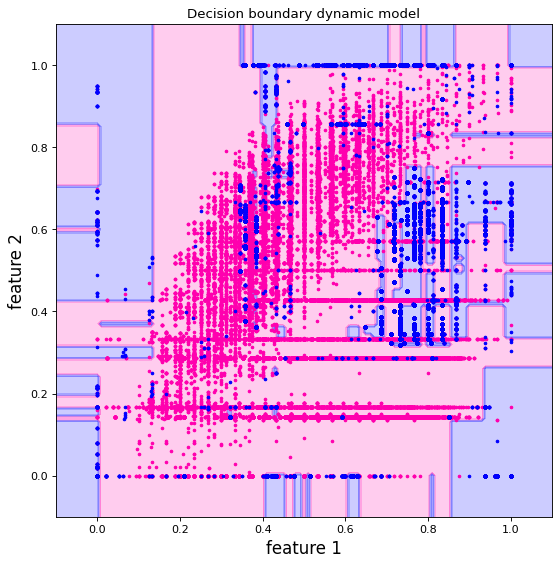

windows number 76
the len of 1000 new records appended to static data set is  344066 



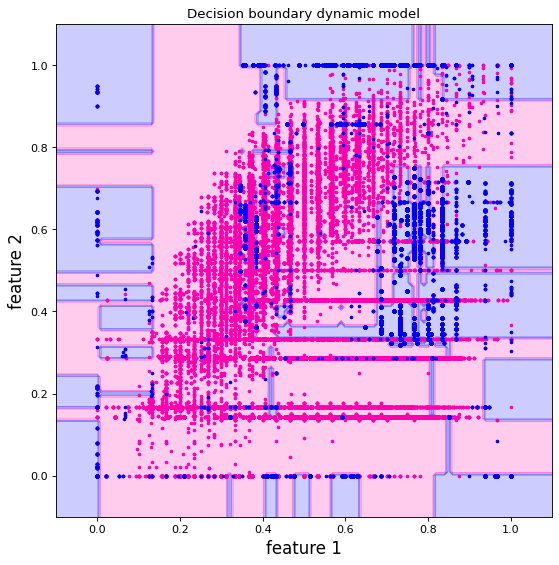

windows number 77
the len of 1000 new records appended to static data set is  345066 



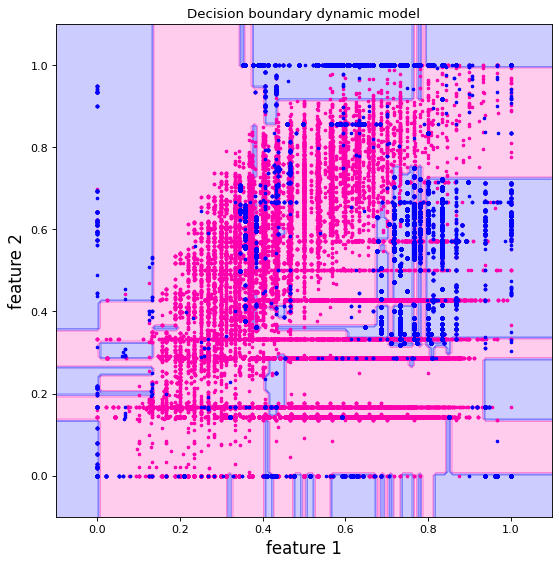

windows number 78
the len of 1000 new records appended to static data set is  346066 



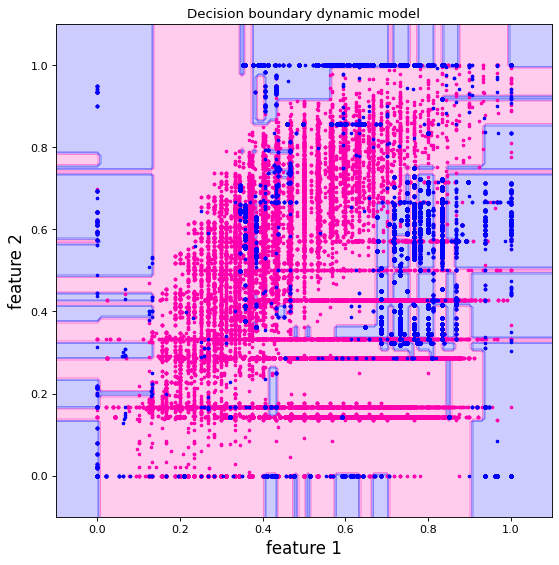

windows number 79
the len of 1000 new records appended to static data set is  347066 



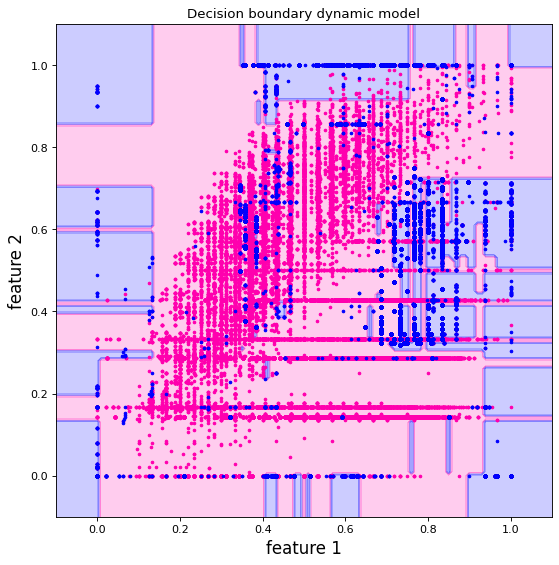

windows number 80
the len of 1000 new records appended to static data set is  348066 



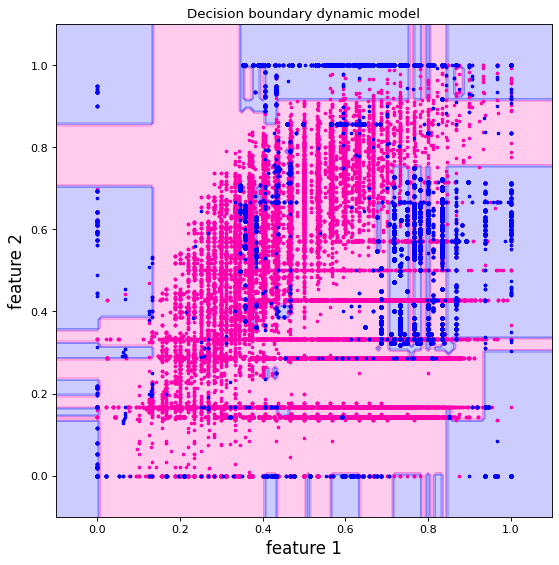

windows number 81
the len of 1000 new records appended to static data set is  349066 



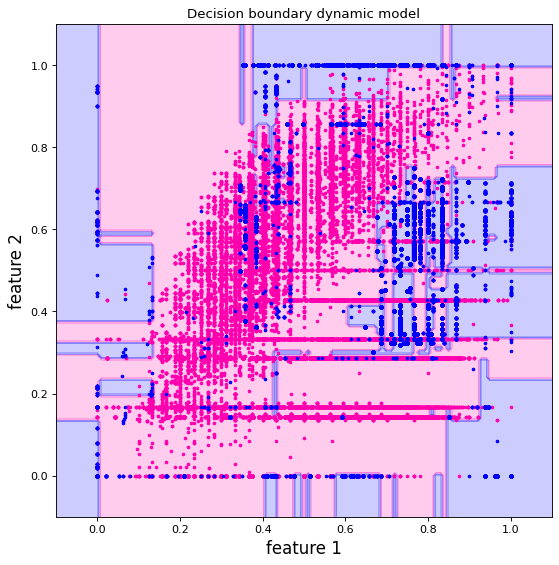

windows number 82
the len of 1000 new records appended to static data set is  350066 



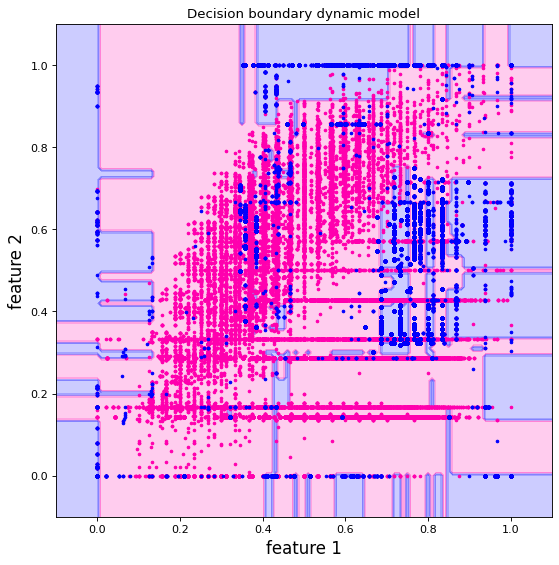

windows number 83
the len of 1000 new records appended to static data set is  351066 



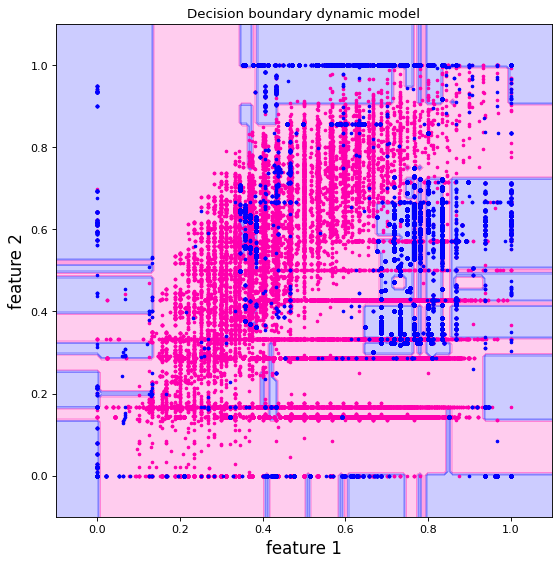

windows number 84
the len of 1000 new records appended to static data set is  352066 



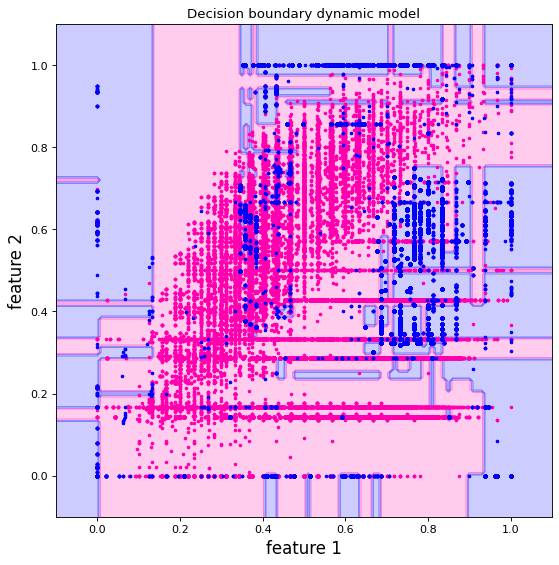

windows number 85
the len of 1000 new records appended to static data set is  353066 



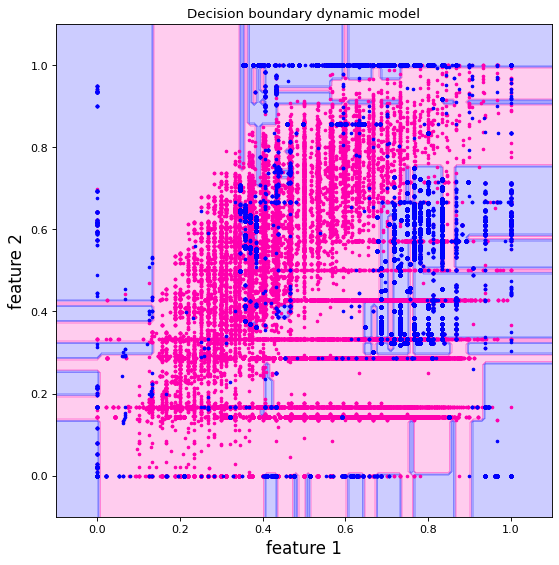

windows number 86
the len of 1000 new records appended to static data set is  354066 



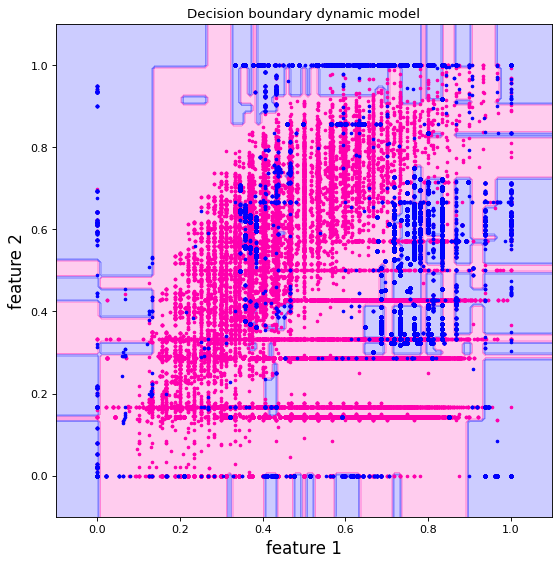

windows number 87
the len of 1000 new records appended to static data set is  355066 



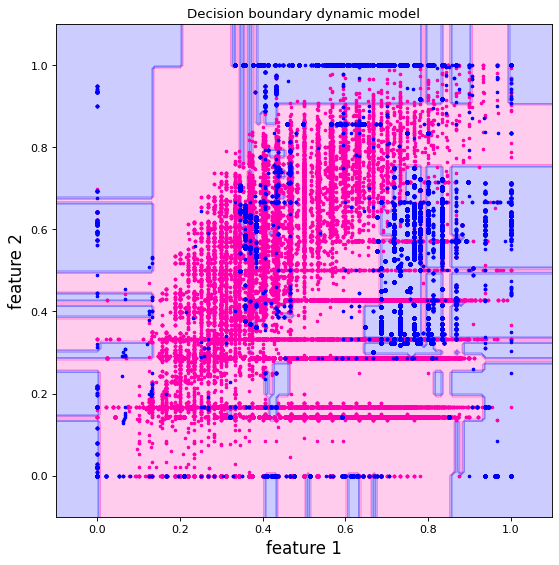

windows number 88
the len of 1000 new records appended to static data set is  356066 



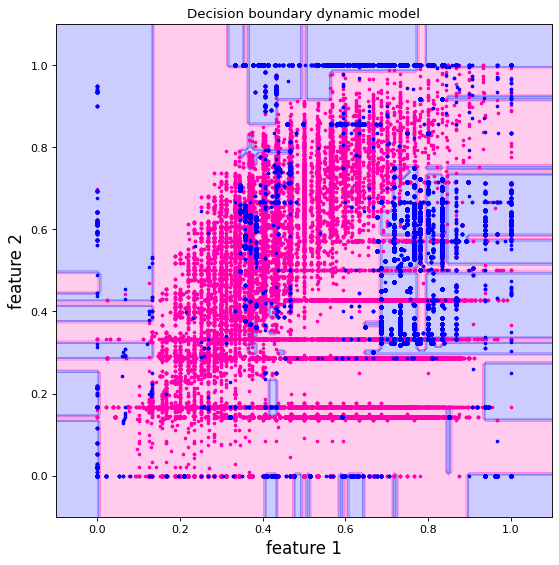

windows number 89
the len of 1000 new records appended to static data set is  357066 



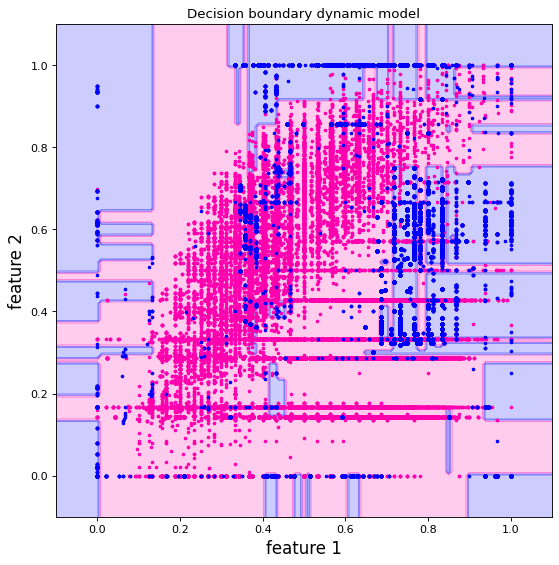

windows number 90
the len of 1000 new records appended to static data set is  358066 



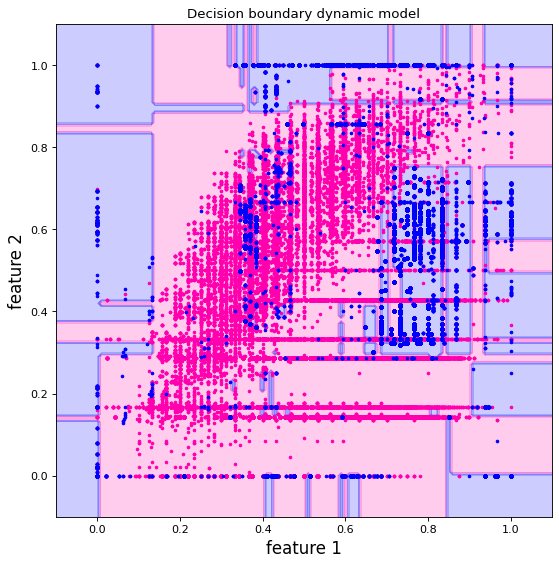

windows number 91
the len of 1000 new records appended to static data set is  359066 



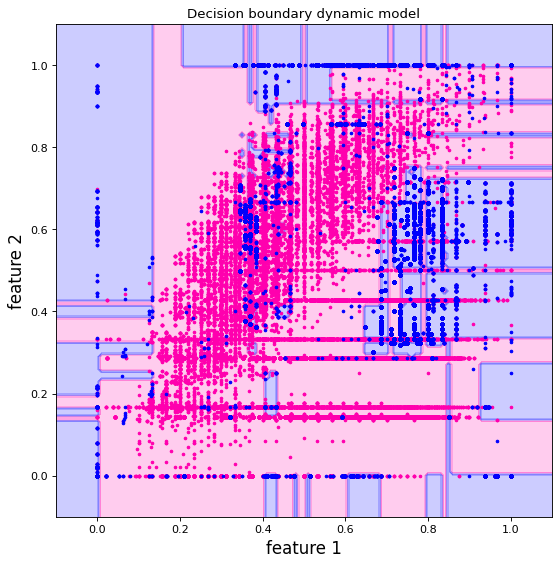

windows number 92
the len of 1000 new records appended to static data set is  360066 



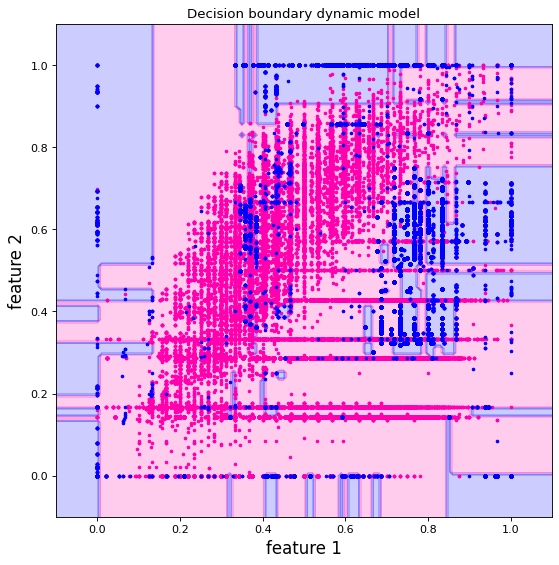

windows number 93
the len of 1000 new records appended to static data set is  361066 



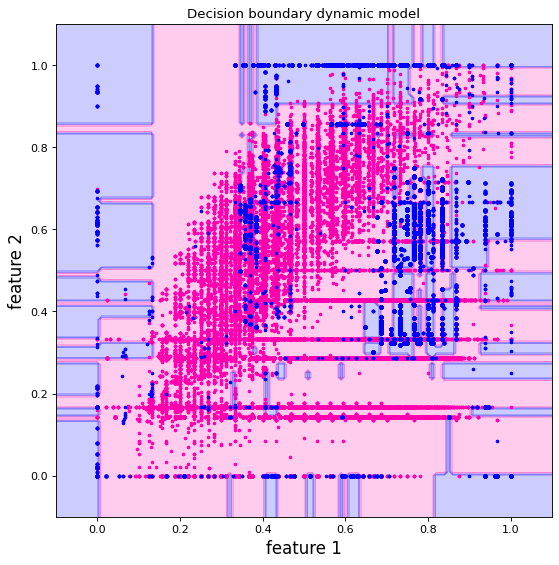

windows number 94
the len of 1000 new records appended to static data set is  362066 



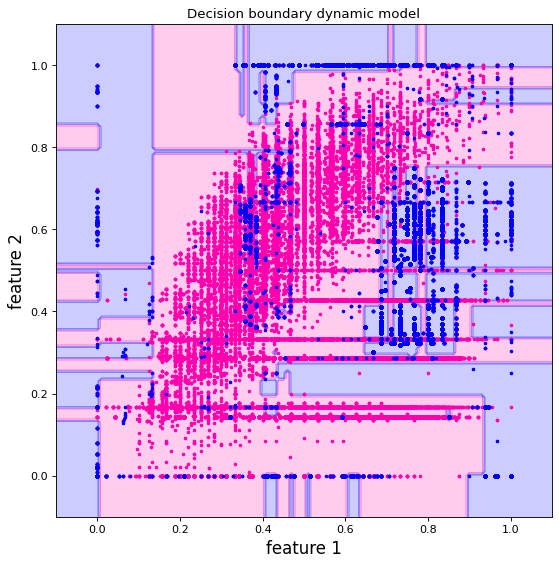

windows number 95
the len of 1000 new records appended to static data set is  363066 



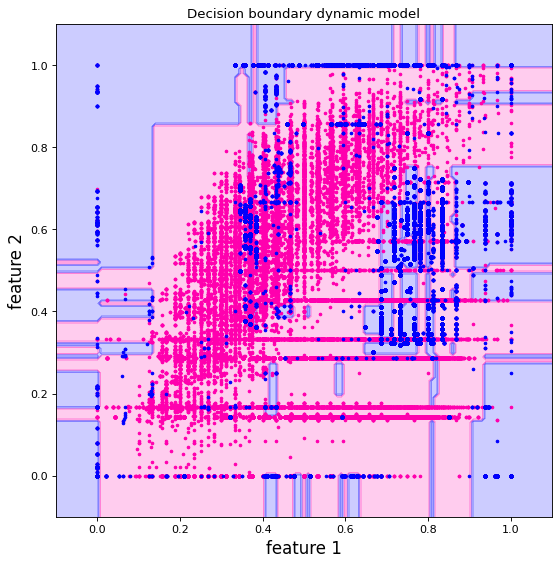

windows number 96
the len of 1000 new records appended to static data set is  364066 



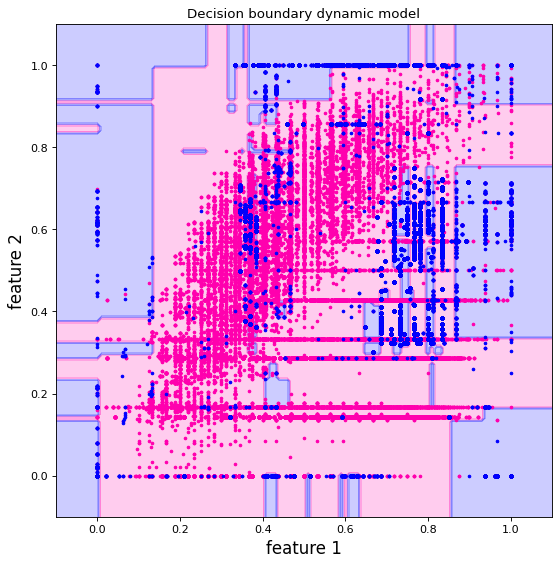

windows number 97
the len of 1000 new records appended to static data set is  365066 



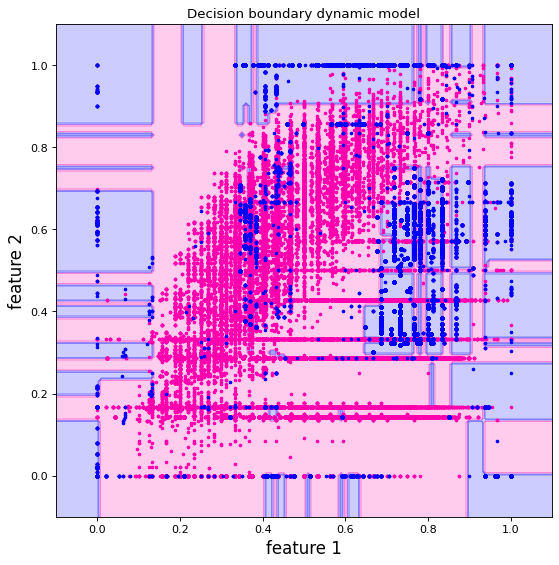

windows number 98
the len of 1000 new records appended to static data set is  366066 



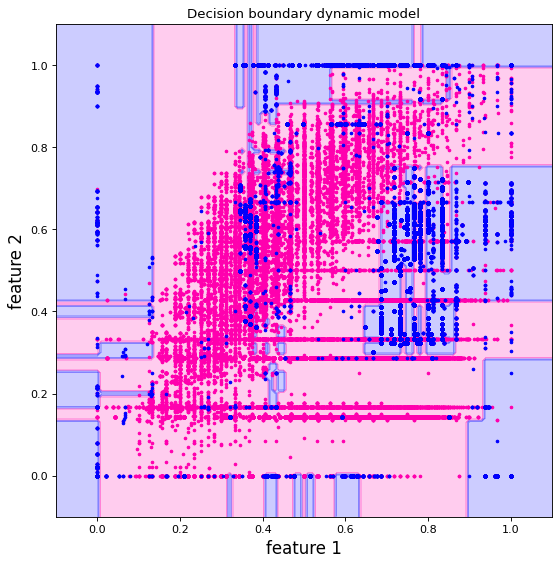

windows number 99
the len of 1000 new records appended to static data set is  367066 



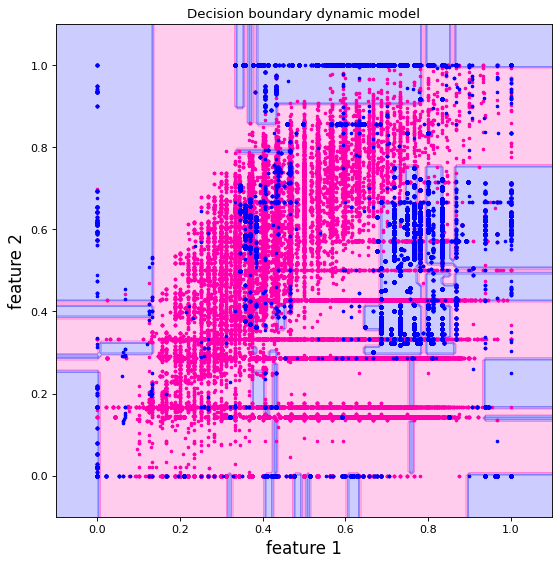

windows number 100
the len of 1000 new records appended to static data set is  368066 



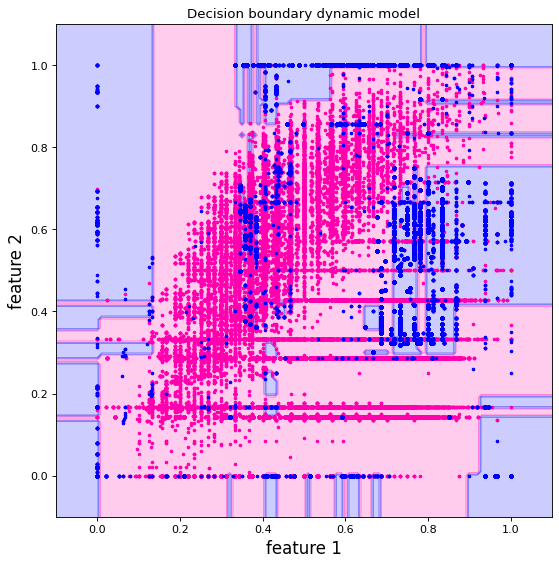

windows number 101
the len of 1000 new records appended to static data set is  369066 



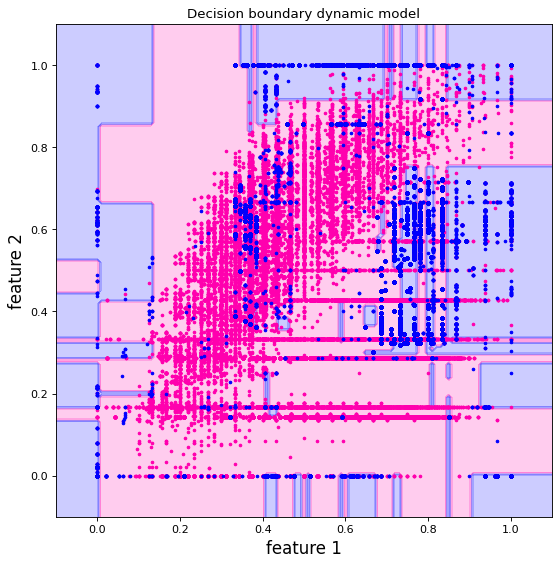

windows number 102
the len of 1000 new records appended to static data set is  370066 



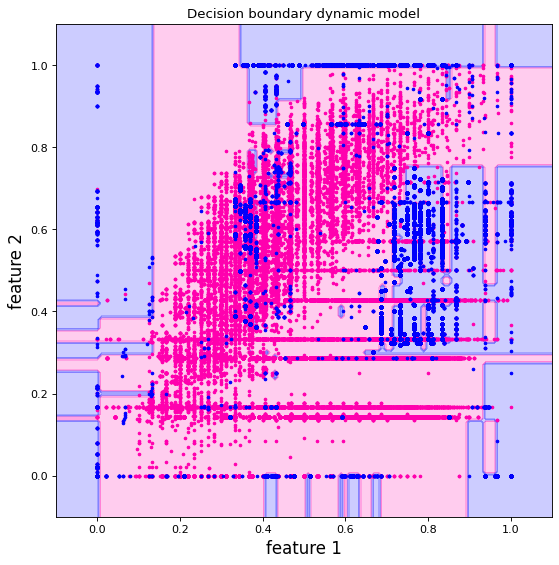

windows number 103
the len of 1000 new records appended to static data set is  371066 



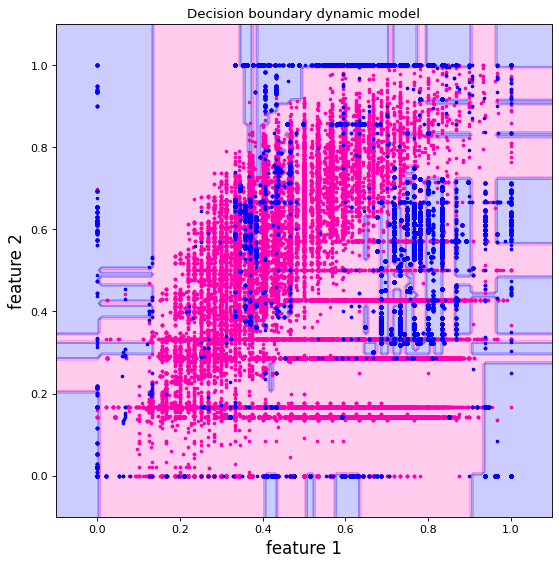

windows number 104
the len of 1000 new records appended to static data set is  372066 



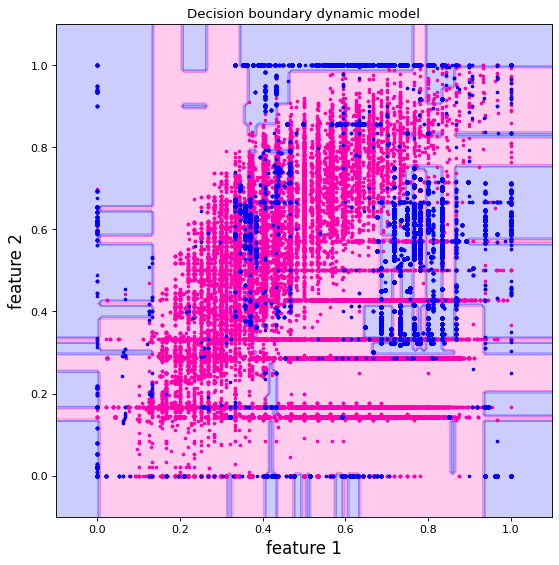

windows number 105
the len of 1000 new records appended to static data set is  373066 



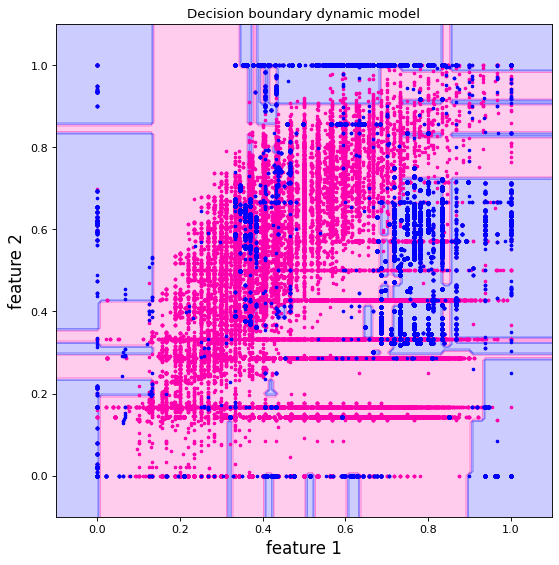

windows number 106
the len of 1000 new records appended to static data set is  374066 



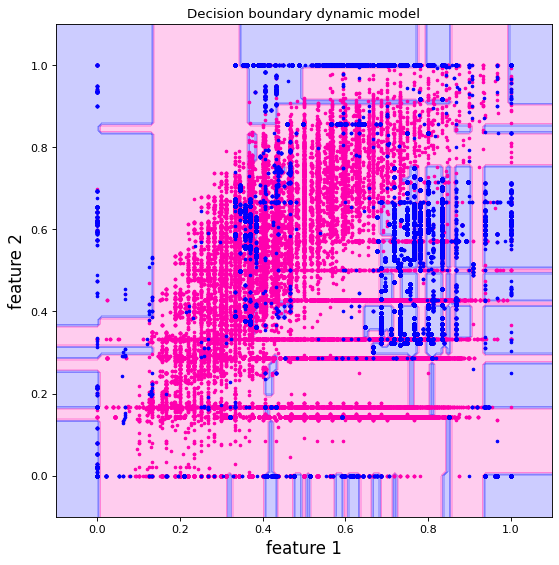

windows number 107
the len of 1000 new records appended to static data set is  375066 



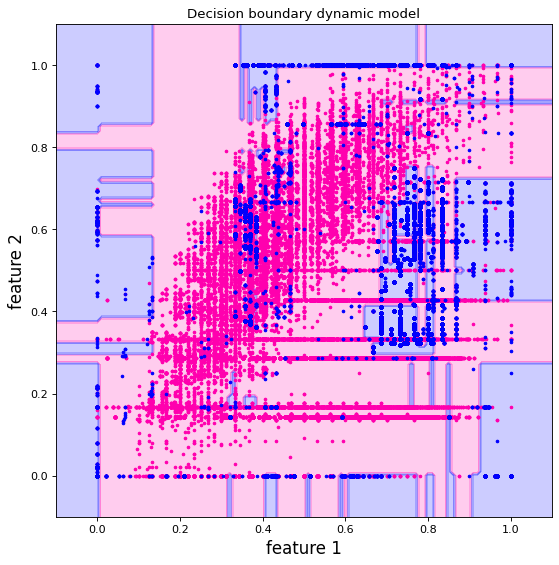

windows number 108
the len of 1000 new records appended to static data set is  376066 



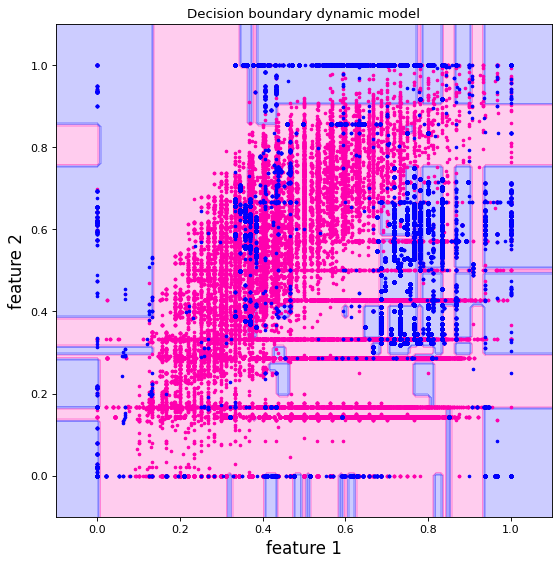

windows number 109
the len of 1000 new records appended to static data set is  377066 



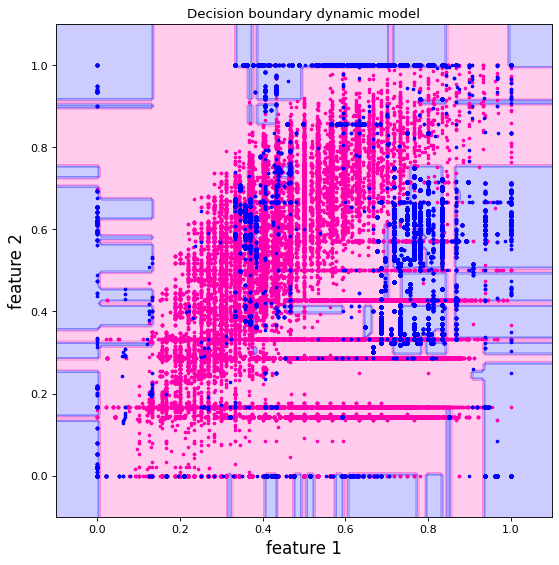

windows number 110
the len of 1000 new records appended to static data set is  378066 



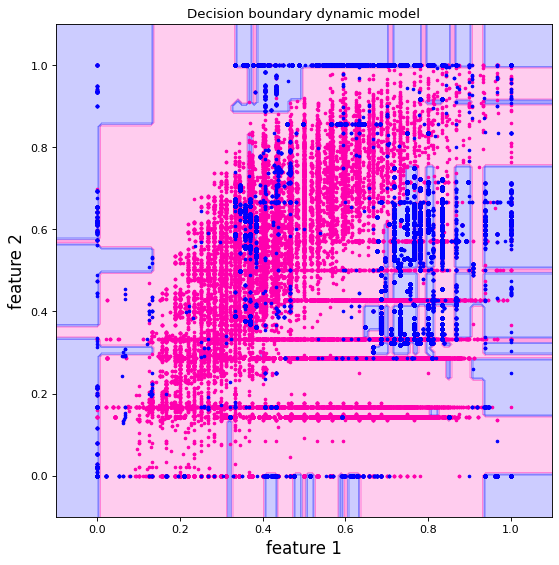

windows number 111
the len of 1000 new records appended to static data set is  379066 



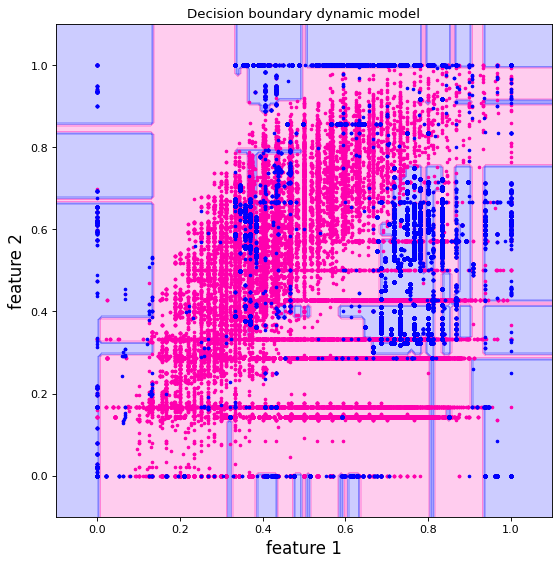

windows number 112
the len of 1000 new records appended to static data set is  380066 



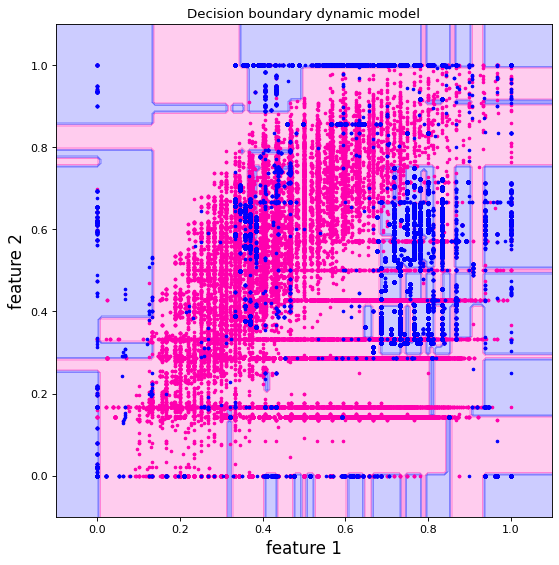

windows number 113
the len of 1000 new records appended to static data set is  381066 



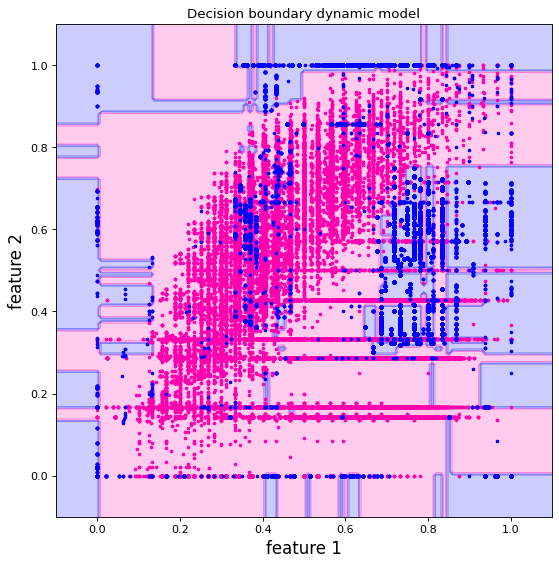

windows number 114
the len of 1000 new records appended to static data set is  382066 



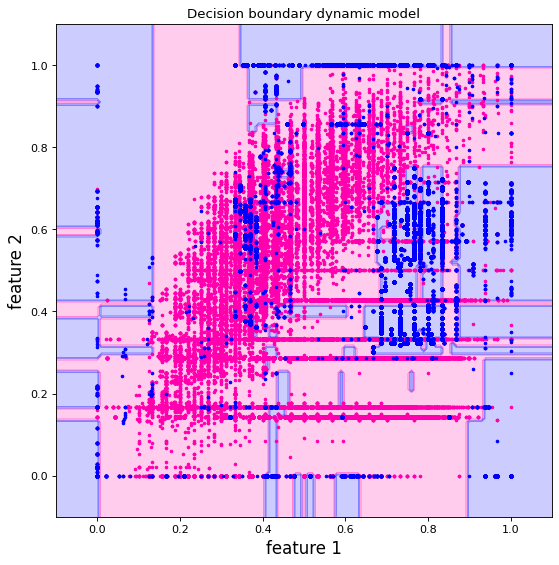

windows number 115
the len of 1000 new records appended to static data set is  383066 



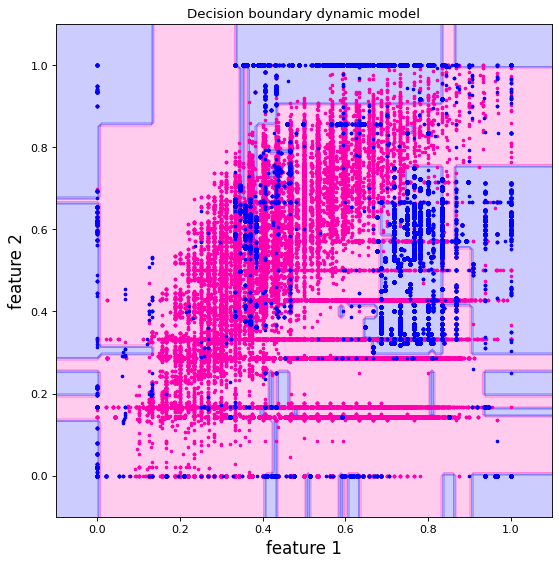

windows number 116
the len of 1000 new records appended to static data set is  384066 



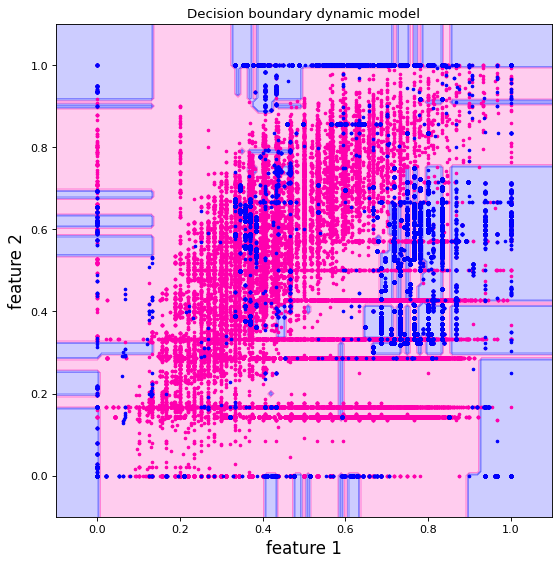

windows number 117
the len of 1000 new records appended to static data set is  385066 



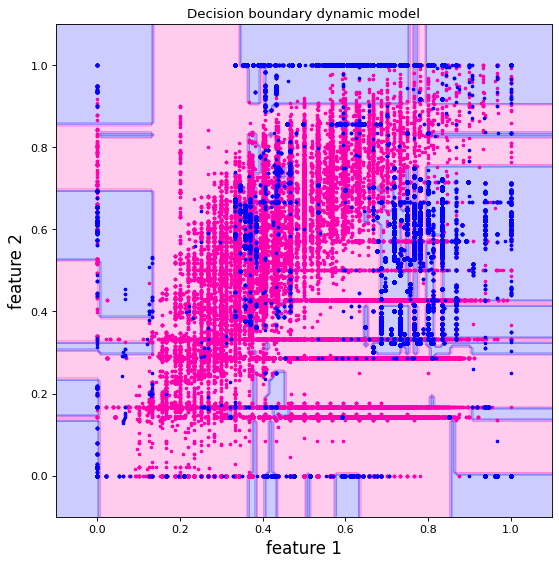

windows number 118
the len of 1000 new records appended to static data set is  386066 



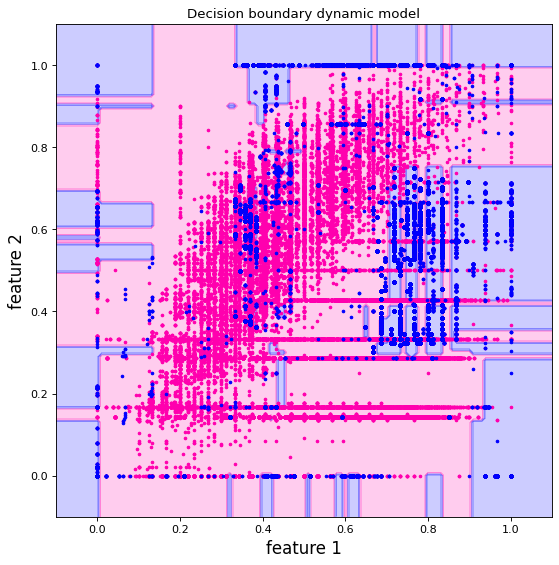

windows number 119
the len of 1000 new records appended to static data set is  387066 



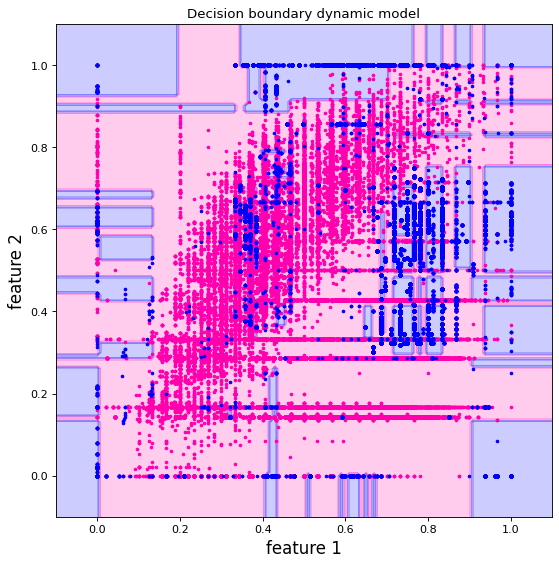

windows number 120
the len of 1000 new records appended to static data set is  388066 



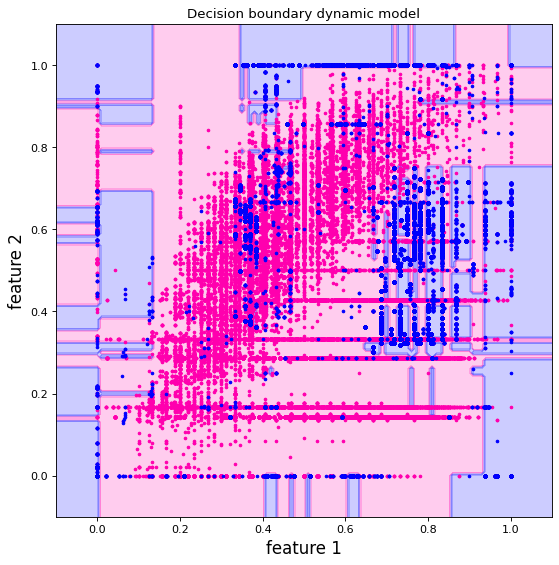

windows number 121
the len of 1000 new records appended to static data set is  389066 



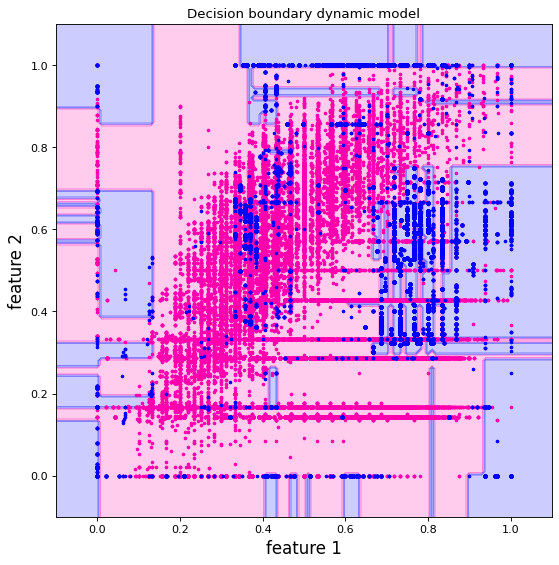

windows number 122
the len of 1000 new records appended to static data set is  390066 



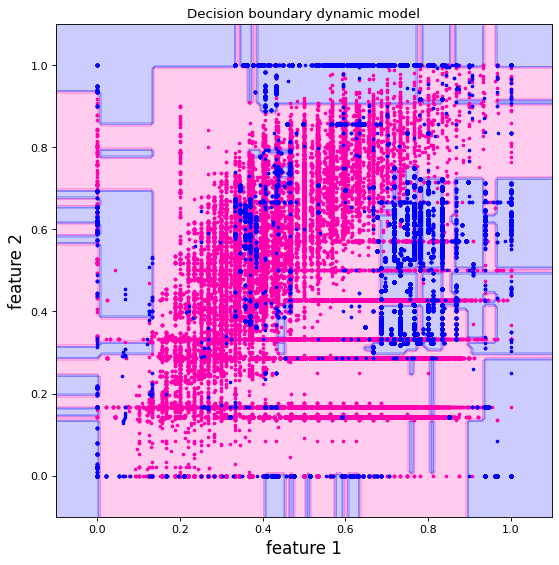

windows number 123
the len of 1000 new records appended to static data set is  391066 



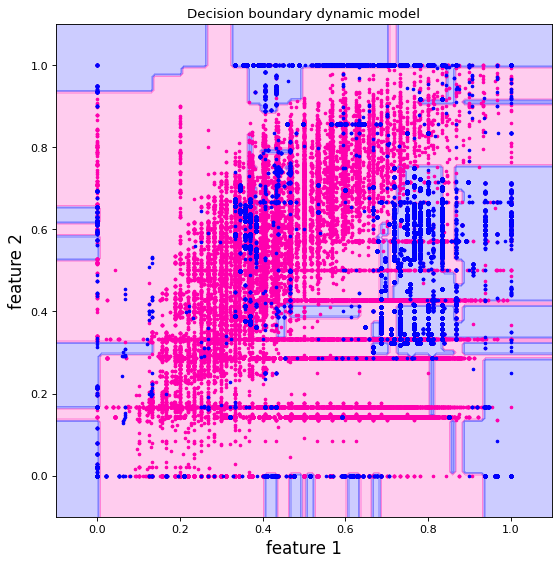

windows number 124
the len of 1000 new records appended to static data set is  392066 



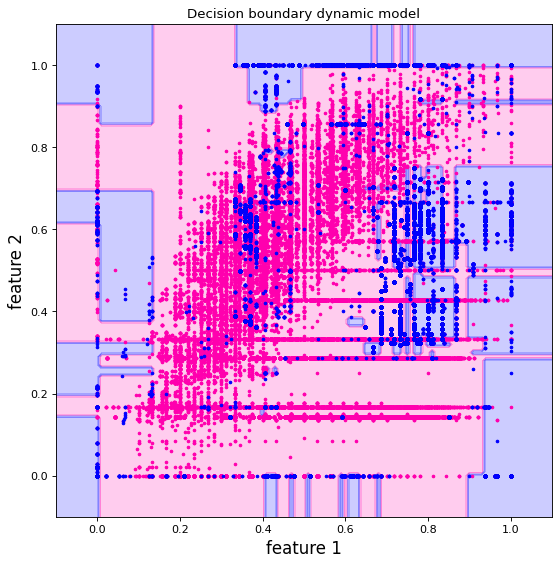

windows number 125
the len of 1000 new records appended to static data set is  393066 



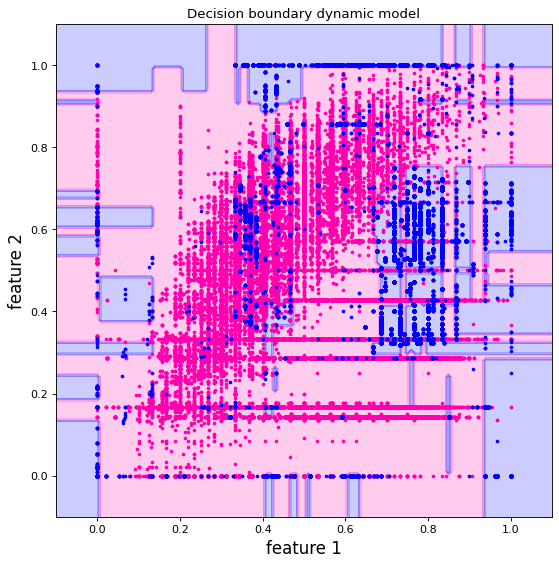

windows number 126
the len of 1000 new records appended to static data set is  394066 



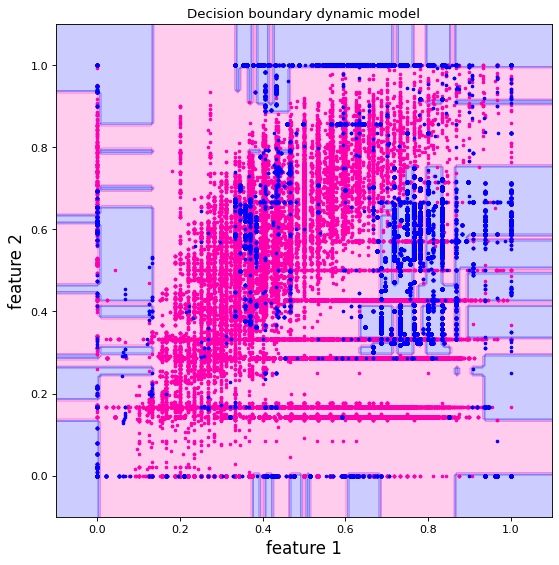

windows number 127
the len of 1000 new records appended to static data set is  395066 



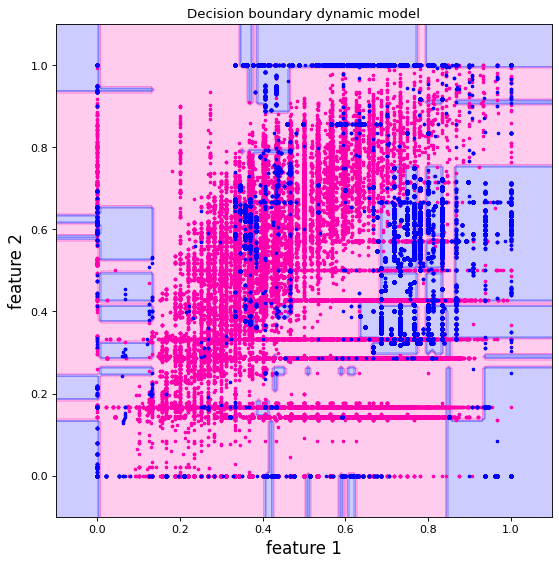

windows number 128
the len of 1000 new records appended to static data set is  396066 



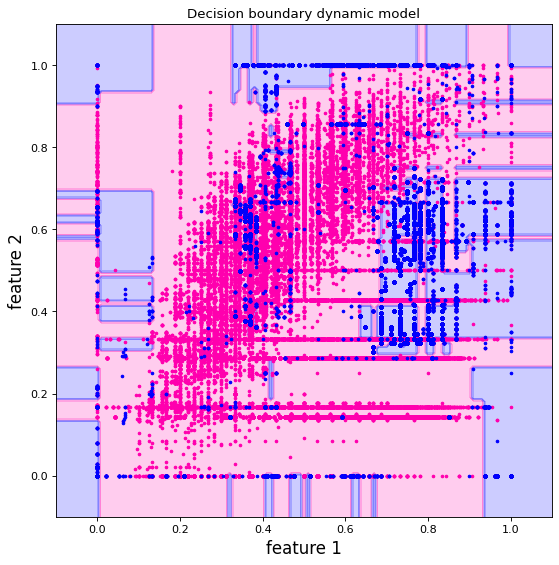

windows number 129
the len of 1000 new records appended to static data set is  397066 



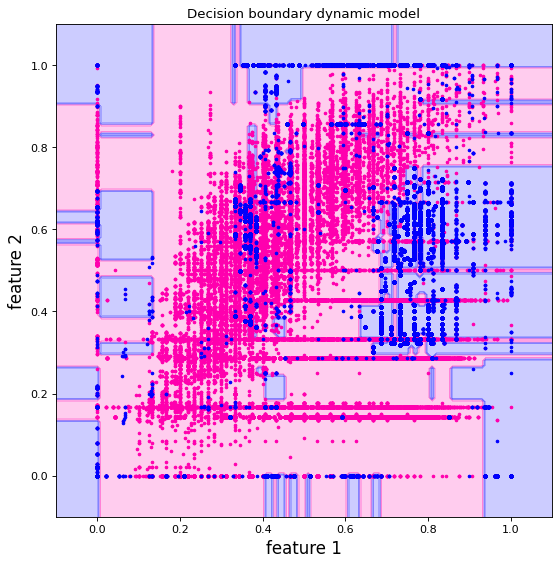

windows number 130
the len of 1000 new records appended to static data set is  398066 



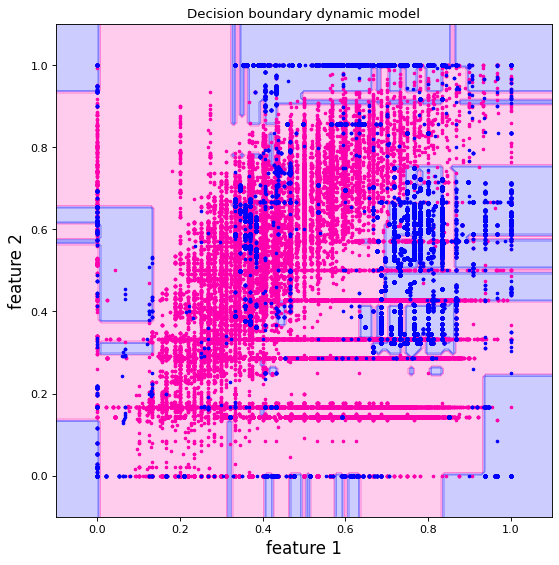

windows number 131
the len of 1000 new records appended to static data set is  399066 



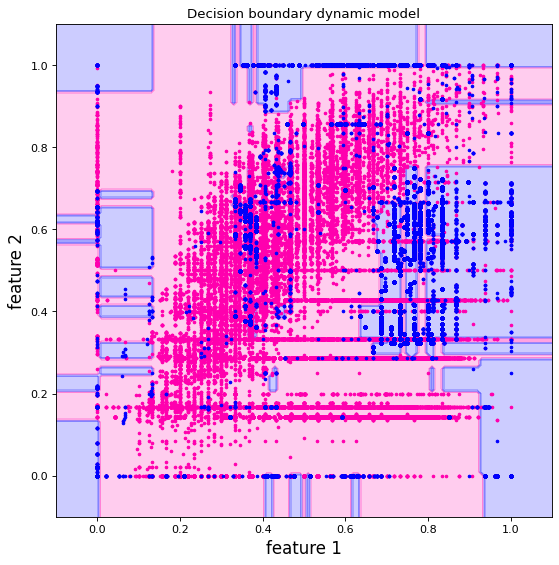

windows number 132
the len of 1000 new records appended to static data set is  400066 



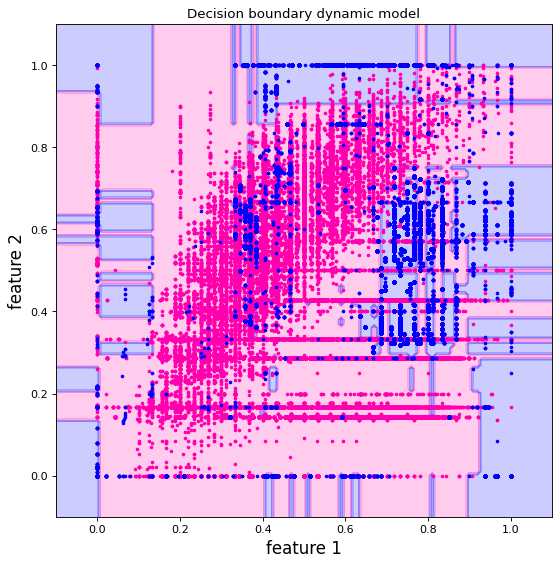

windows number 133
the len of 1000 new records appended to static data set is  401066 



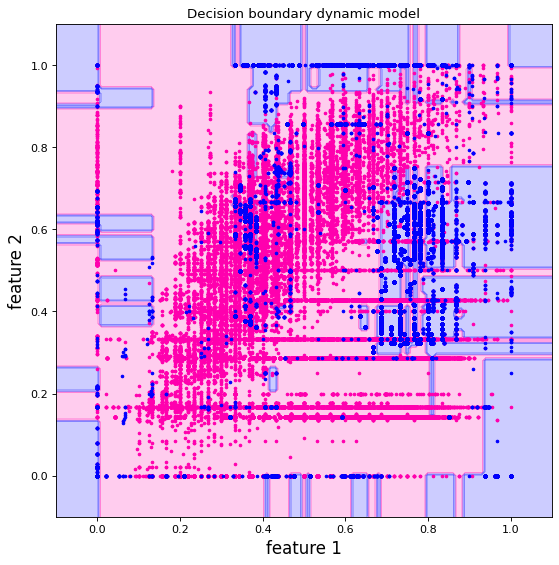

windows number 134
the len of 1000 new records appended to static data set is  402066 



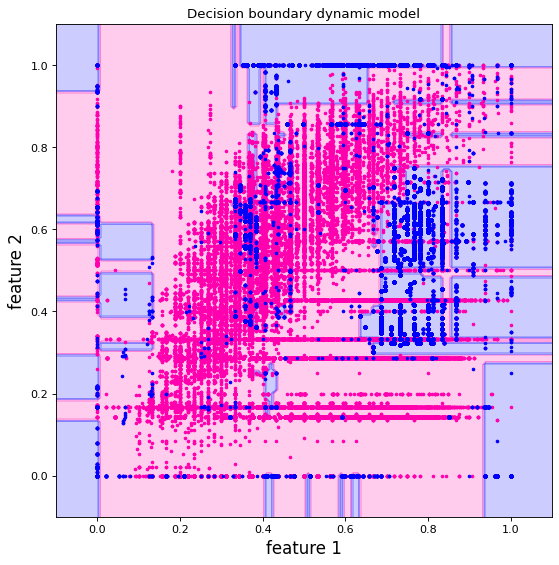

windows number 135
the len of 1000 new records appended to static data set is  403066 



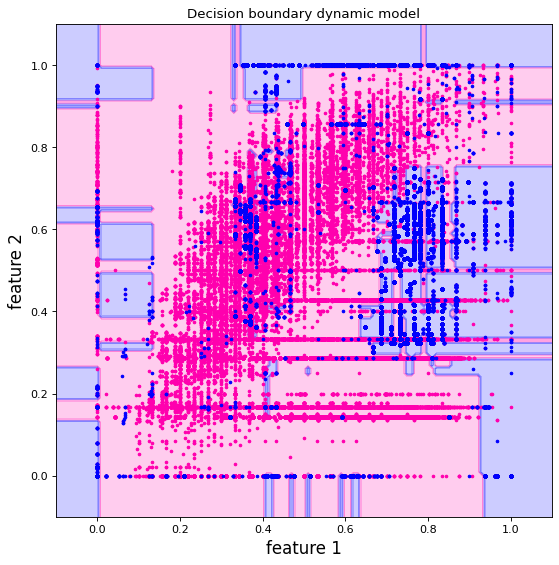

windows number 136
the len of 1000 new records appended to static data set is  404066 



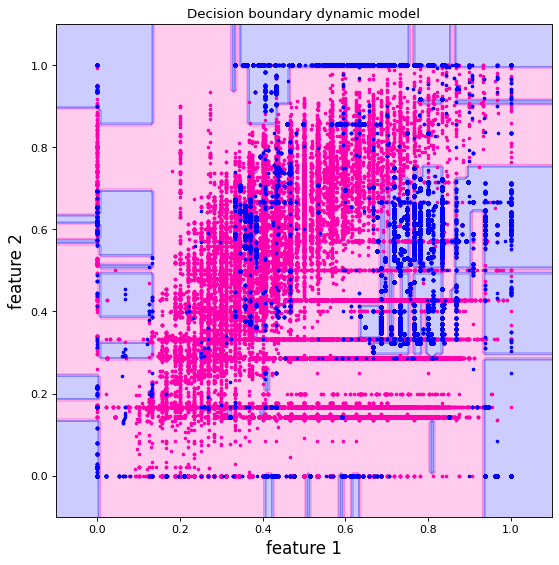

windows number 137
the len of 1000 new records appended to static data set is  405066 



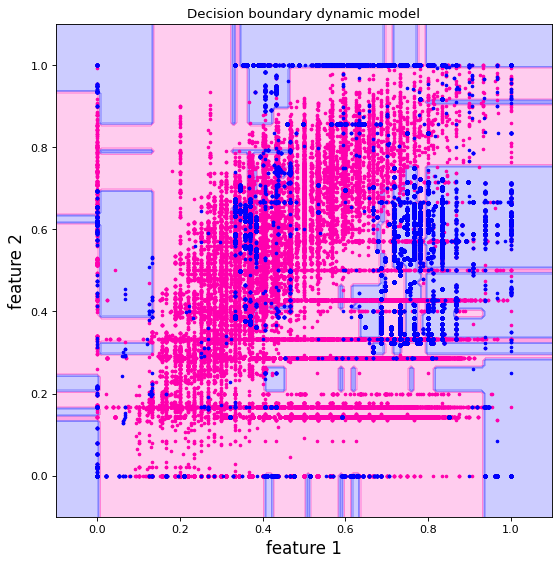

windows number 138
the len of 1000 new records appended to static data set is  406066 



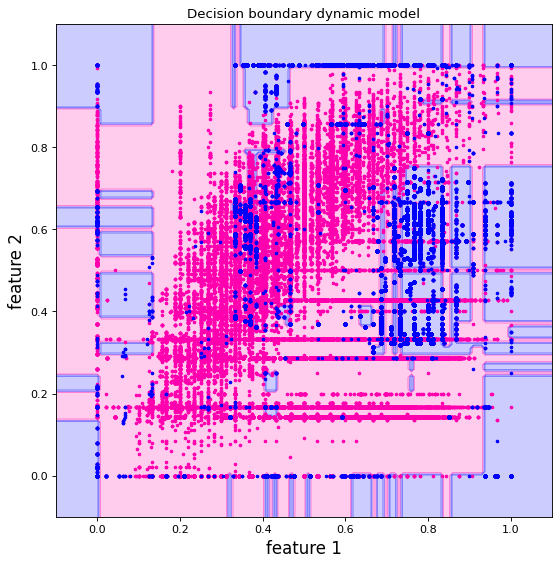

windows number 139
the len of 1000 new records appended to static data set is  407066 



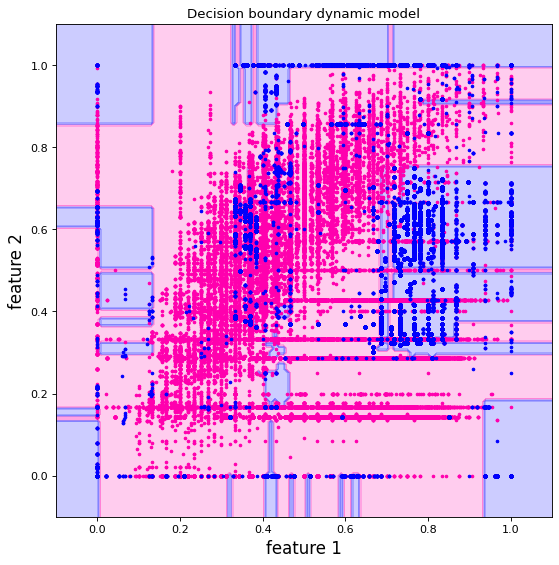

windows number 140
the len of 1000 new records appended to static data set is  408066 



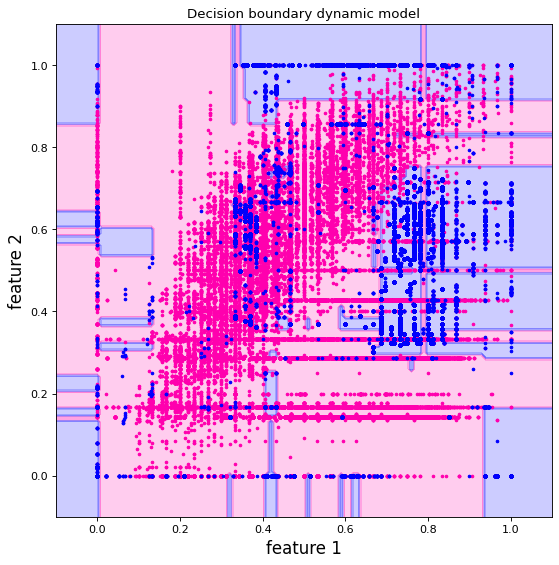

windows number 141
the len of 1000 new records appended to static data set is  409066 



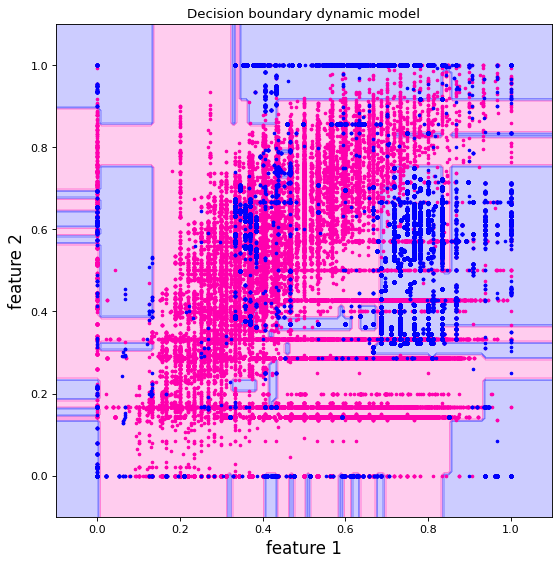

windows number 142
the len of 1000 new records appended to static data set is  410066 



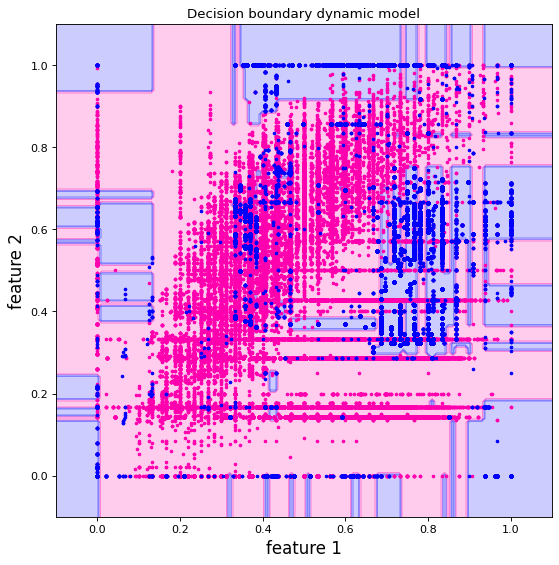

windows number 143
the len of 1000 new records appended to static data set is  411066 



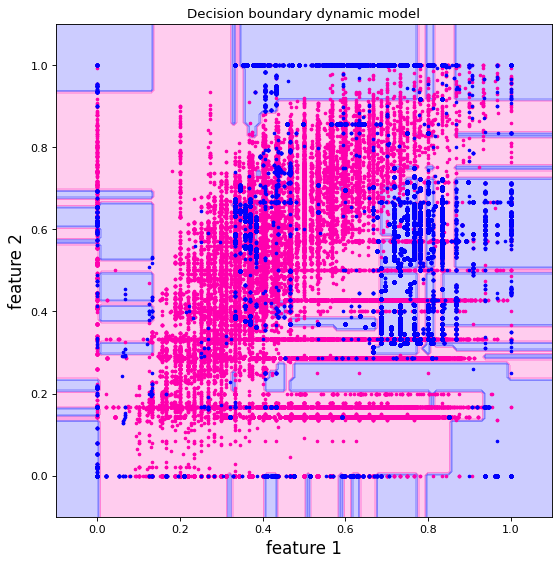

windows number 144
the len of 1000 new records appended to static data set is  412066 



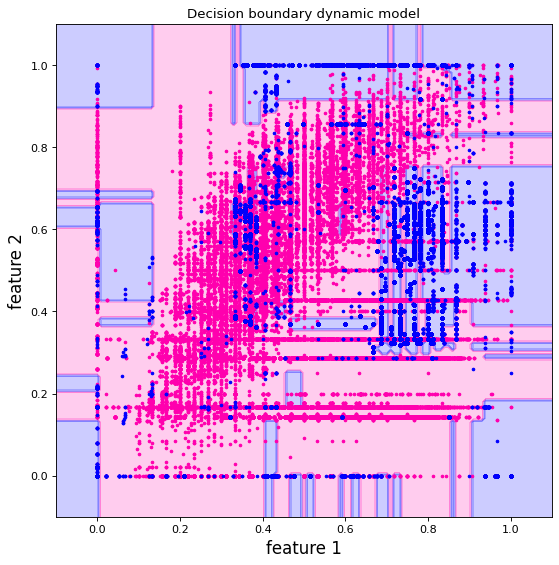

windows number 145
the len of 1000 new records appended to static data set is  413066 



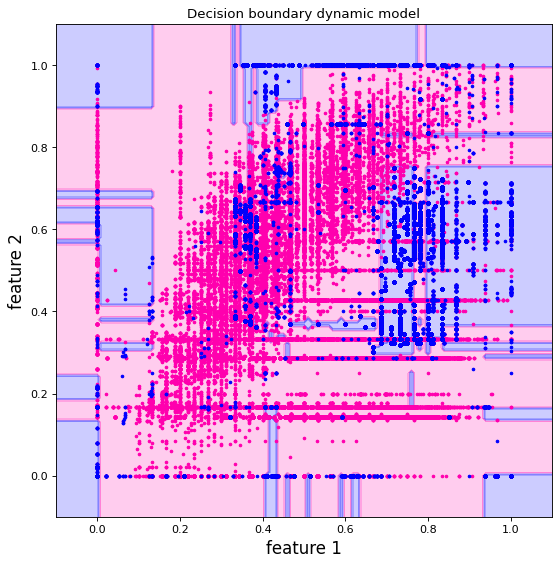

windows number 146
the len of 1000 new records appended to static data set is  414066 



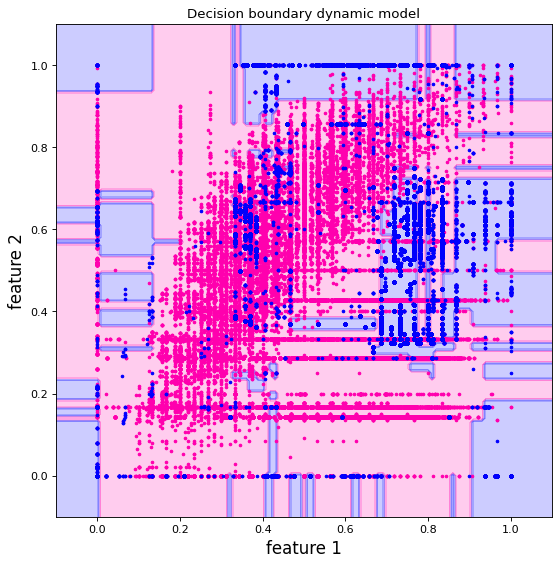

windows number 147
the len of 1000 new records appended to static data set is  415066 



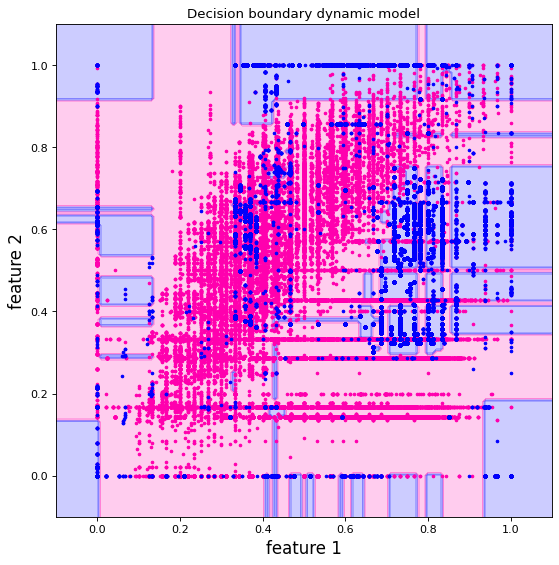

windows number 148
the len of 1000 new records appended to static data set is  416066 



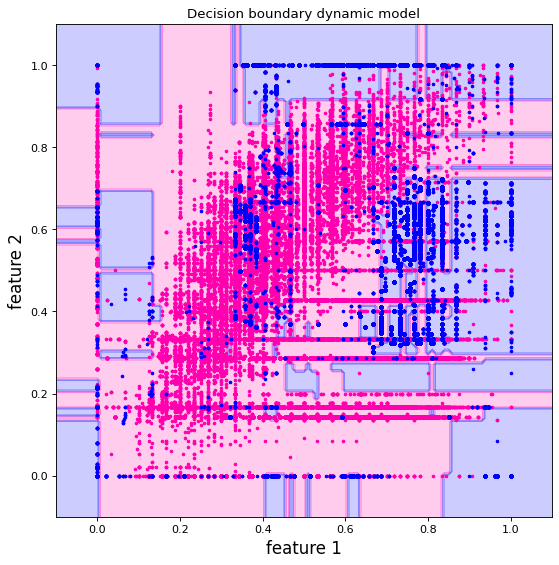

windows number 149
the len of 1000 new records appended to static data set is  417066 



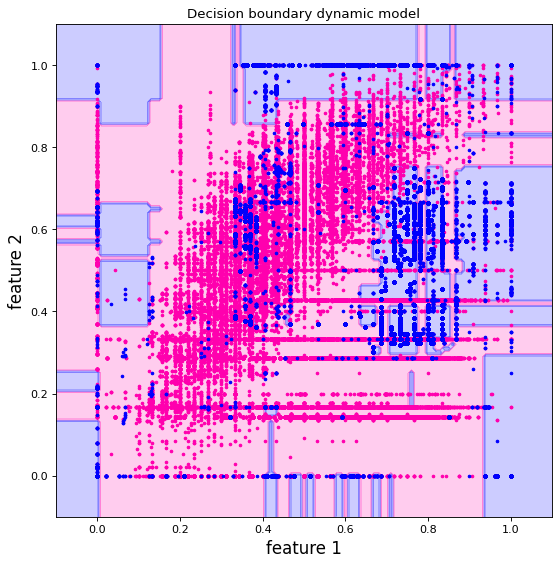

windows number 150
the len of 1000 new records appended to static data set is  418066 



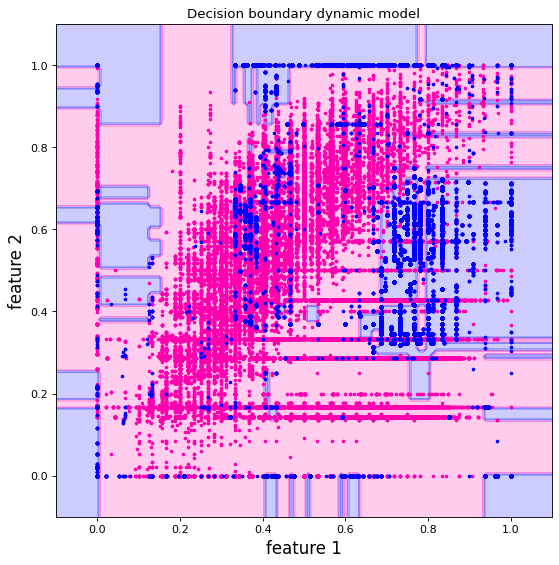

windows number 151
the len of 1000 new records appended to static data set is  419066 



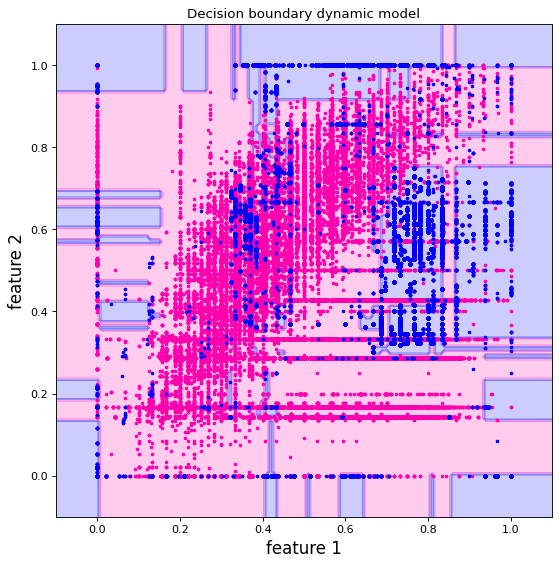

windows number 152
the len of 1000 new records appended to static data set is  420066 



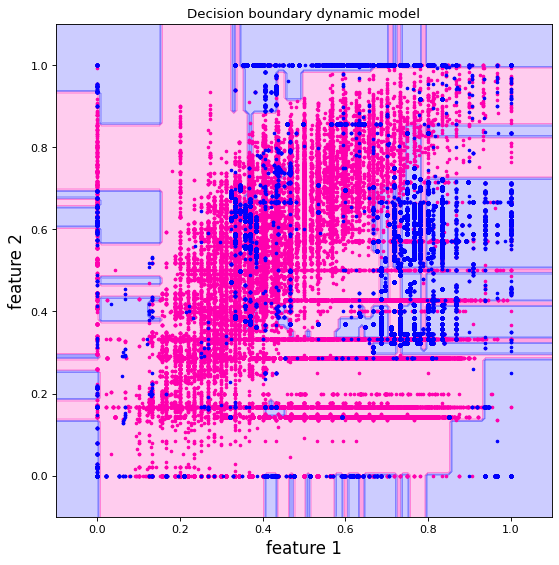

windows number 153
the len of 1000 new records appended to static data set is  421066 



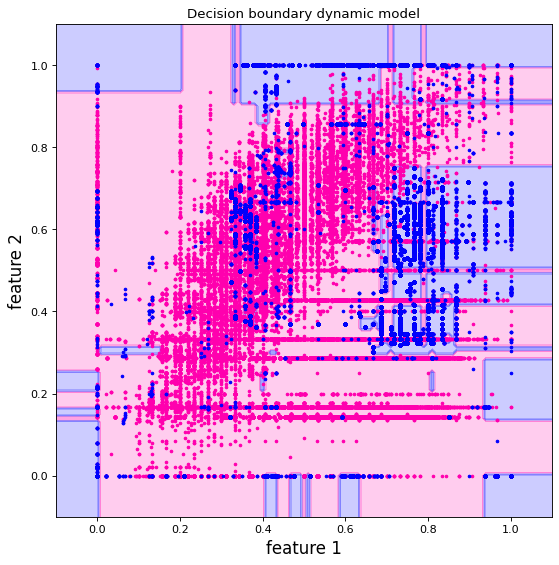

windows number 154
the len of 1000 new records appended to static data set is  422066 



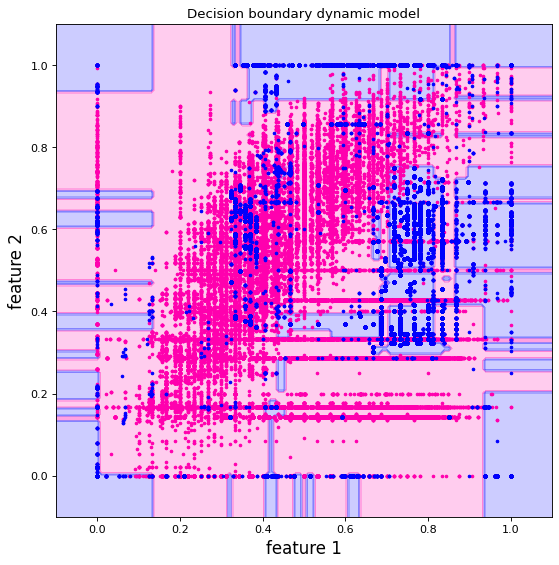

windows number 155
the len of 1000 new records appended to static data set is  423066 



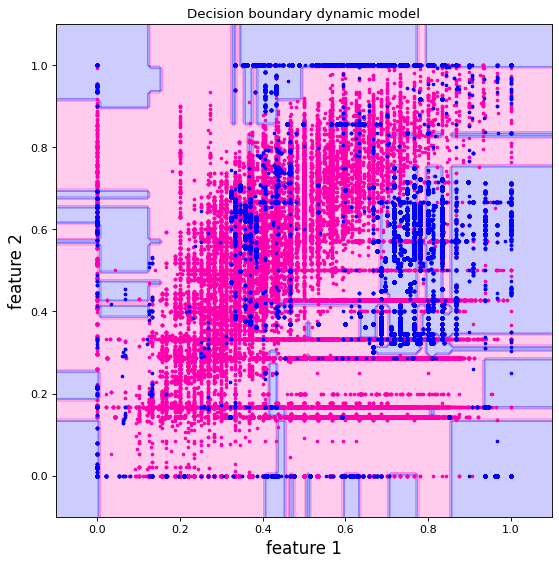

windows number 156
the len of 1000 new records appended to static data set is  424066 



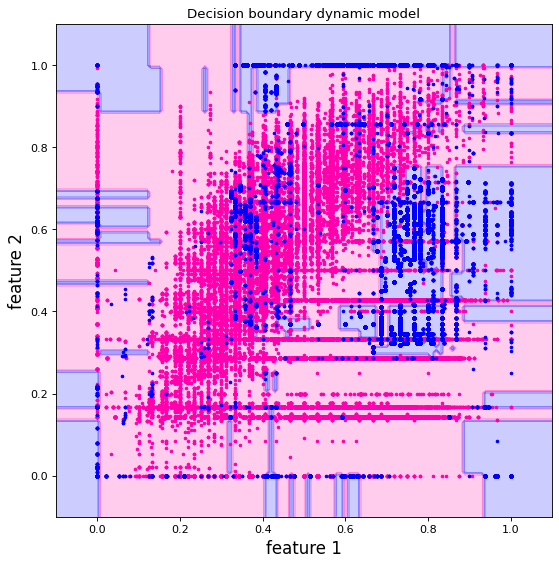

windows number 157
the len of 1000 new records appended to static data set is  425066 



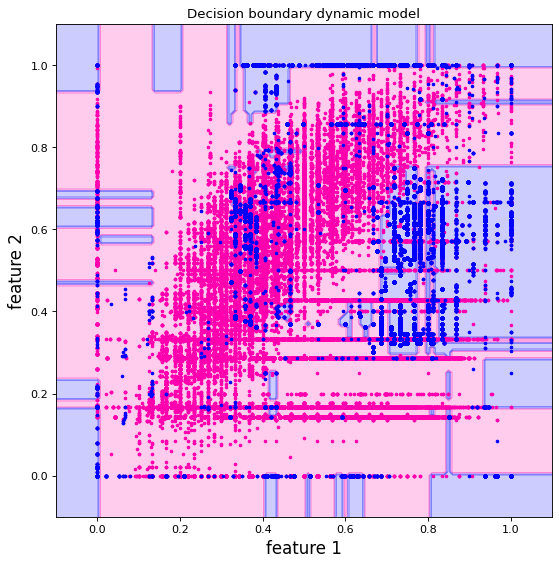

windows number 158
the len of 1000 new records appended to static data set is  426066 



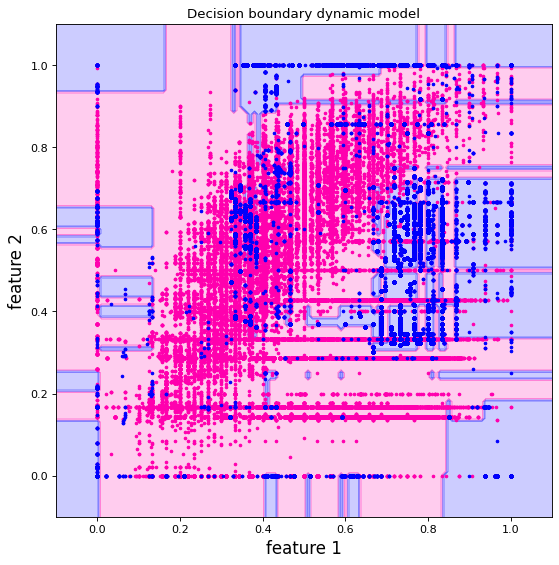

windows number 159
the len of 1000 new records appended to static data set is  427066 



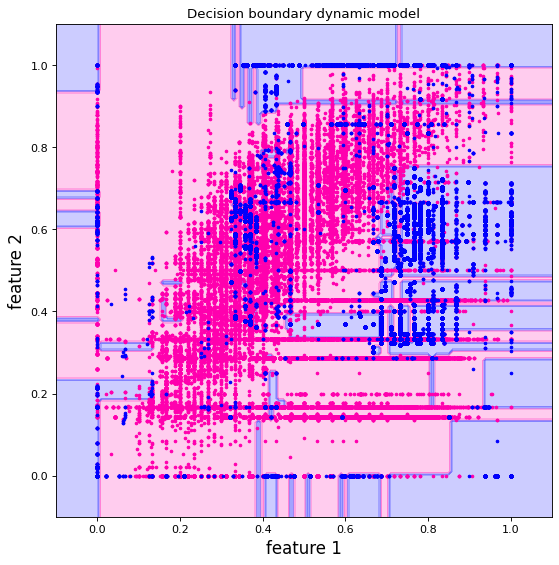

windows number 160
the len of 1000 new records appended to static data set is  428066 



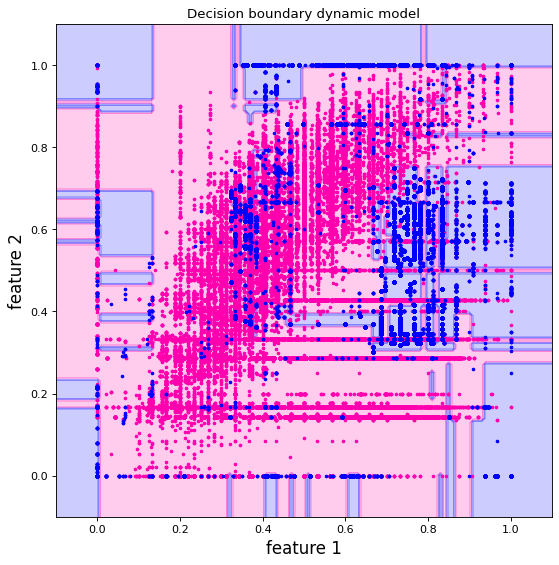

windows number 161
the len of 1000 new records appended to static data set is  429066 



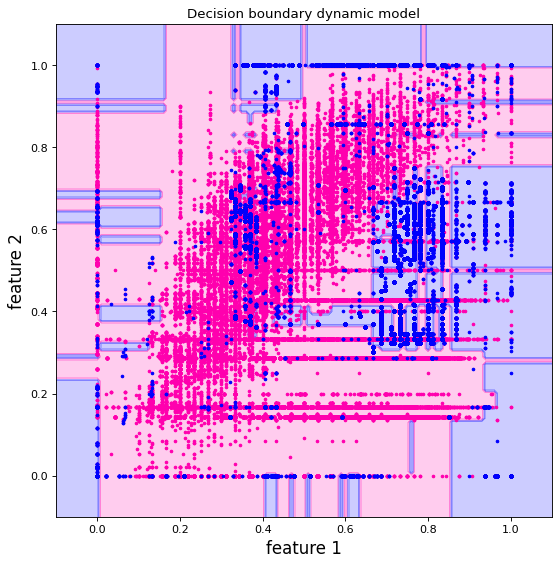

windows number 162
the len of 1000 new records appended to static data set is  430066 



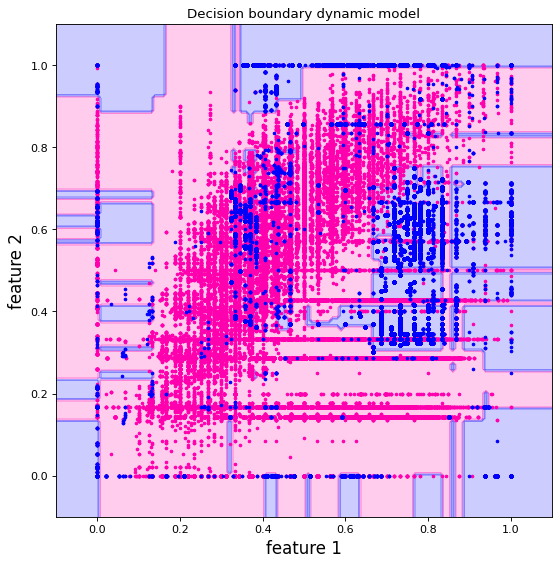

windows number 163
the len of 1000 new records appended to static data set is  431066 



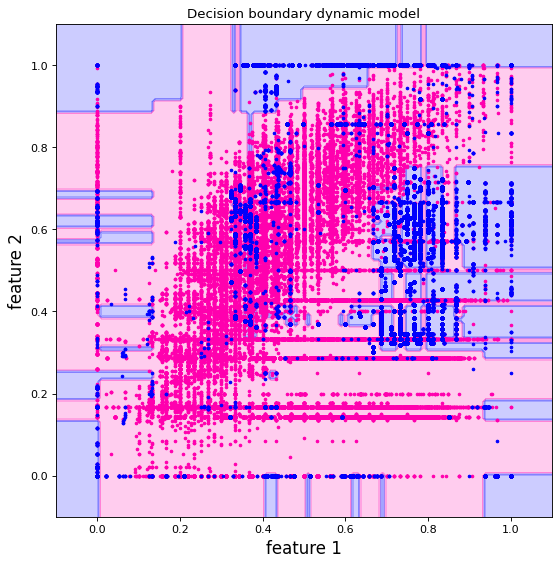

windows number 164
the len of 1000 new records appended to static data set is  432066 



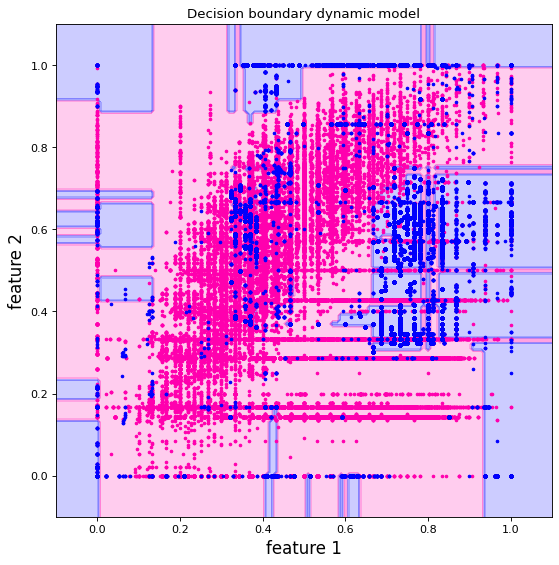

windows number 165
the len of 1000 new records appended to static data set is  433066 



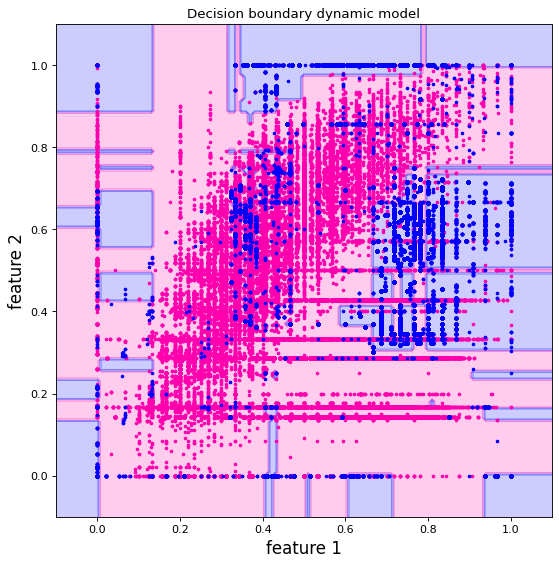

windows number 166
the len of 1000 new records appended to static data set is  434066 



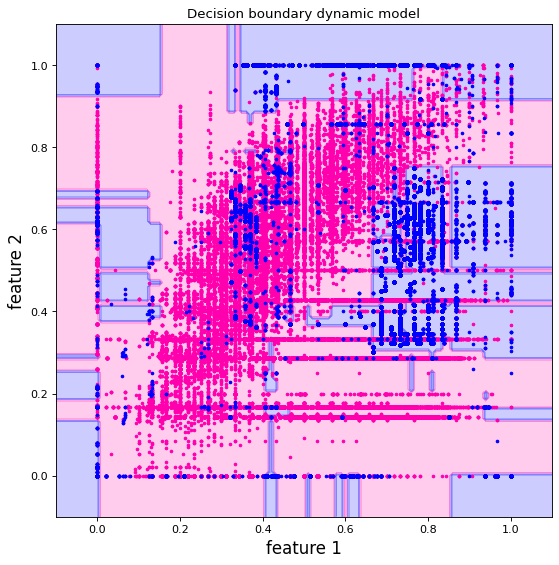

windows number 167
the len of 1000 new records appended to static data set is  435066 



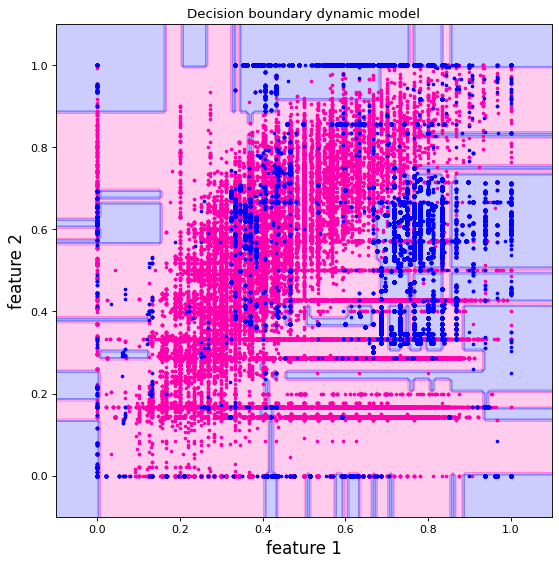

windows number 168
the len of 1000 new records appended to static data set is  436066 



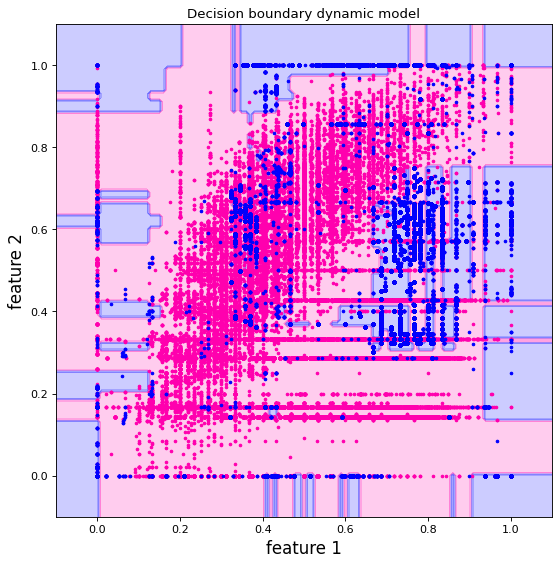

windows number 169
the len of 1000 new records appended to static data set is  437066 



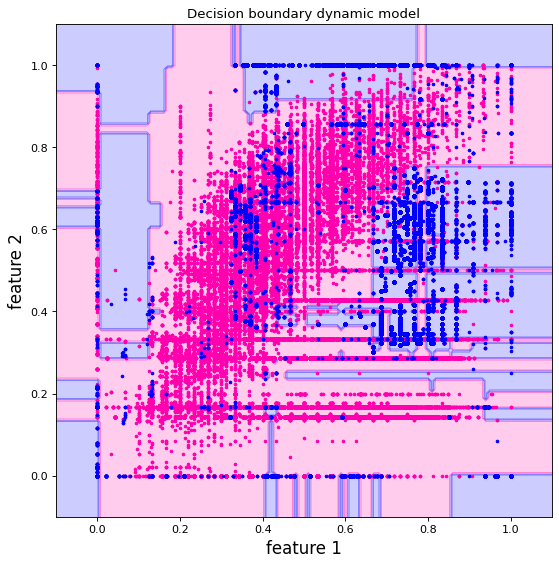

windows number 170
the len of 1000 new records appended to static data set is  438066 



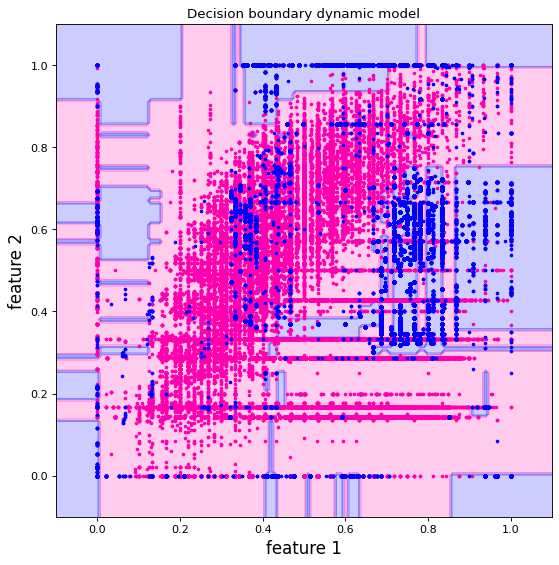

windows number 171
the len of 1000 new records appended to static data set is  439066 



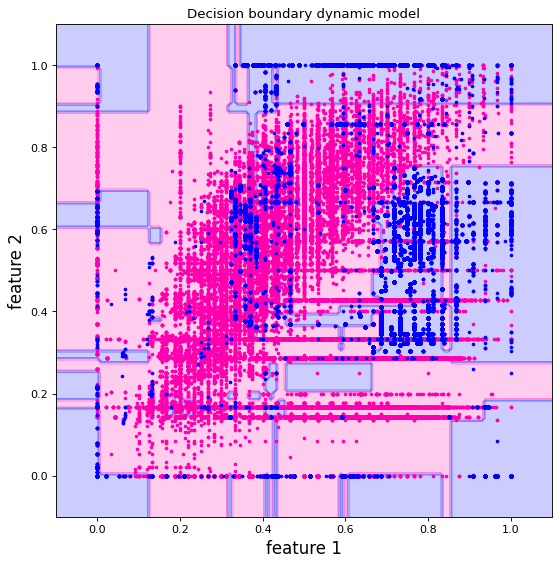

windows number 172
the len of 1000 new records appended to static data set is  440066 



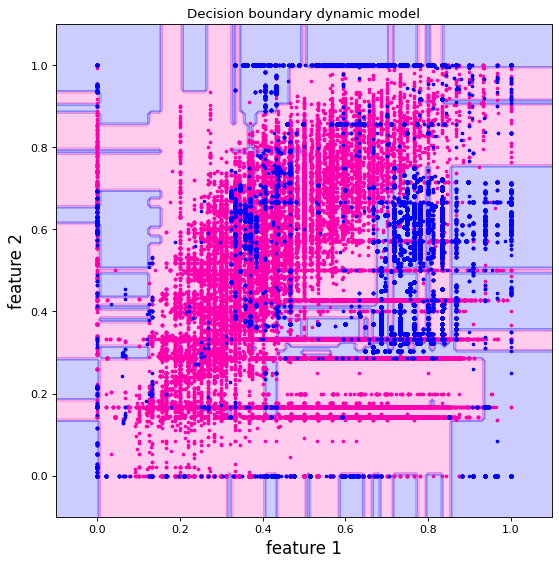

windows number 173
the len of 1000 new records appended to static data set is  441066 



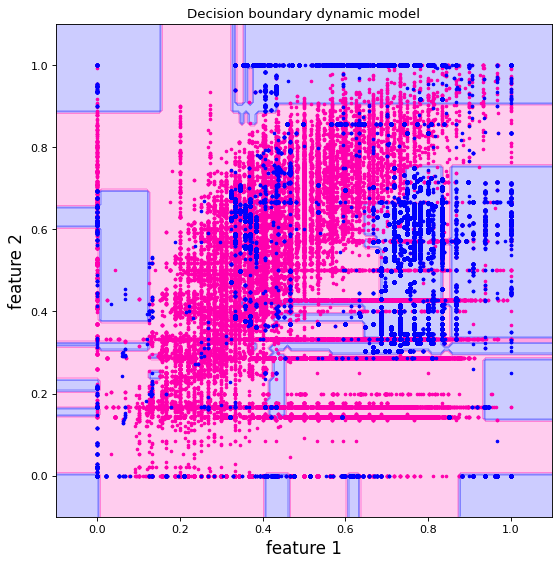

windows number 174
the len of 1000 new records appended to static data set is  442066 



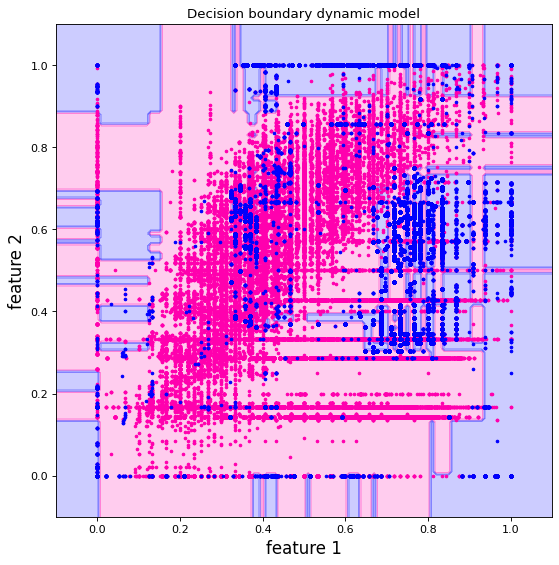

windows number 175
the len of 1000 new records appended to static data set is  443066 



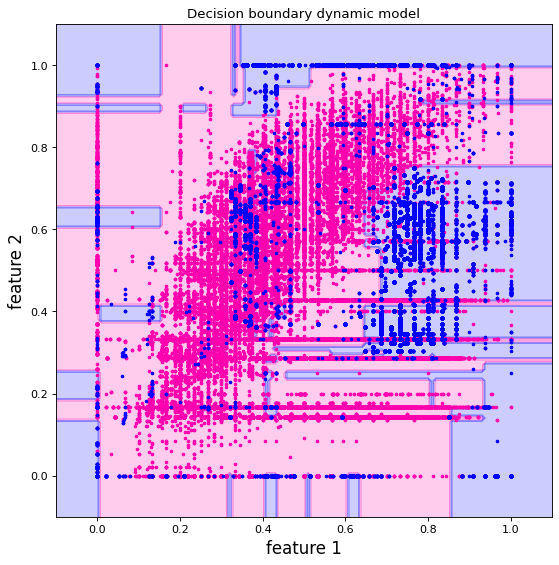

windows number 176
the len of 1000 new records appended to static data set is  444066 



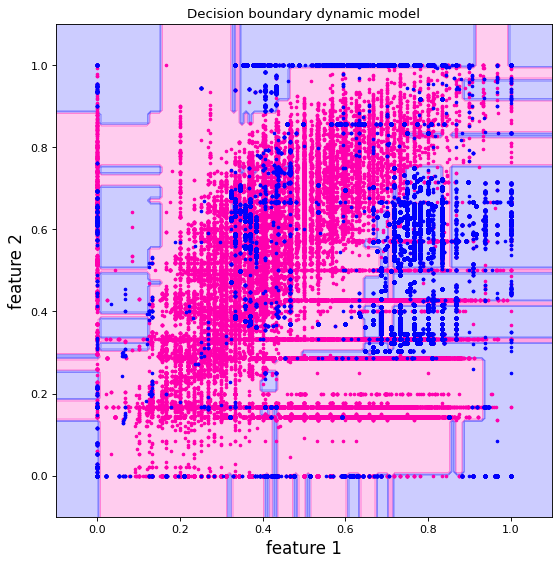

windows number 177
the len of 1000 new records appended to static data set is  445066 



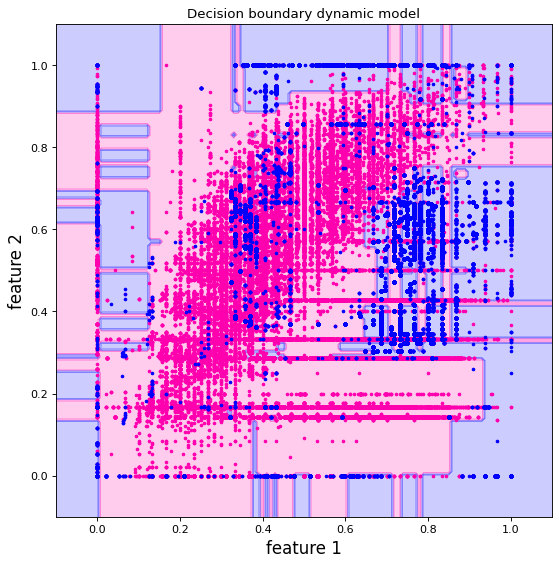

windows number 178
the len of 1000 new records appended to static data set is  446066 



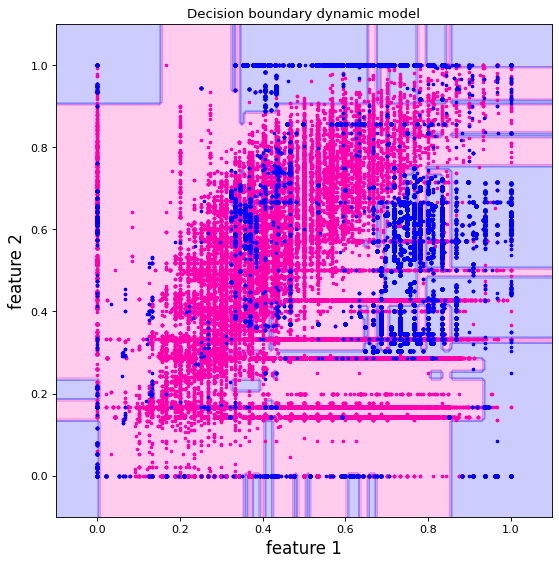

windows number 179
the len of 1000 new records appended to static data set is  447066 



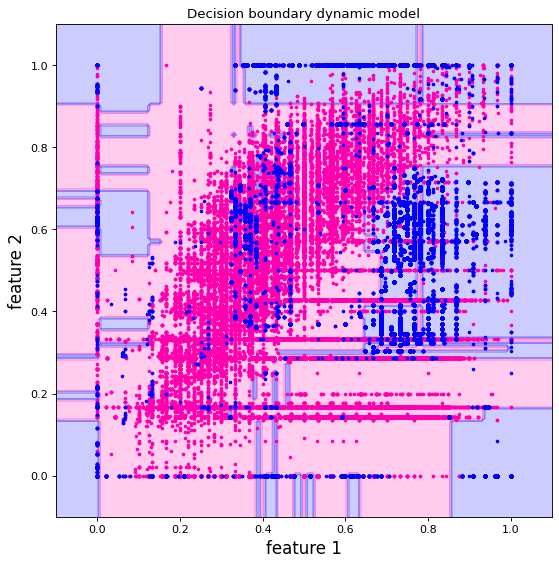

windows number 180
the len of 1000 new records appended to static data set is  448066 



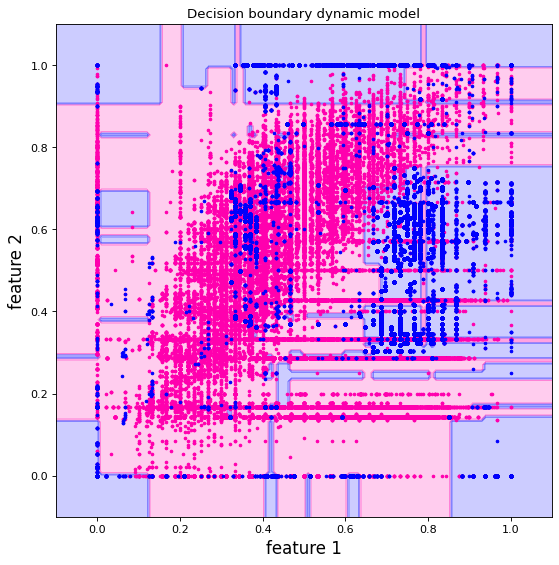

windows number 181
the len of 1000 new records appended to static data set is  449066 



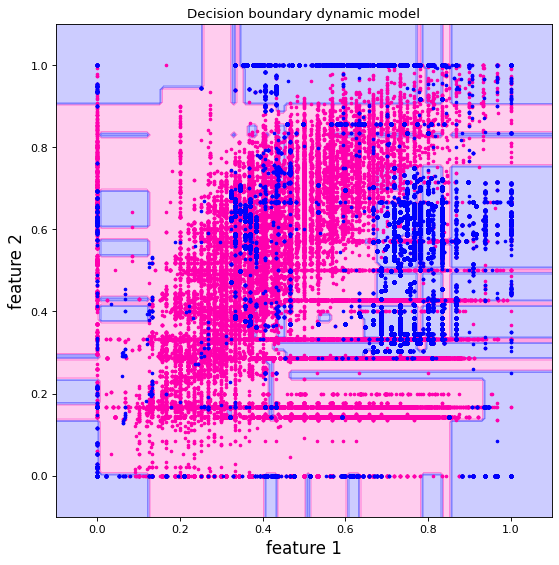

windows number 182
the len of 1000 new records appended to static data set is  450066 



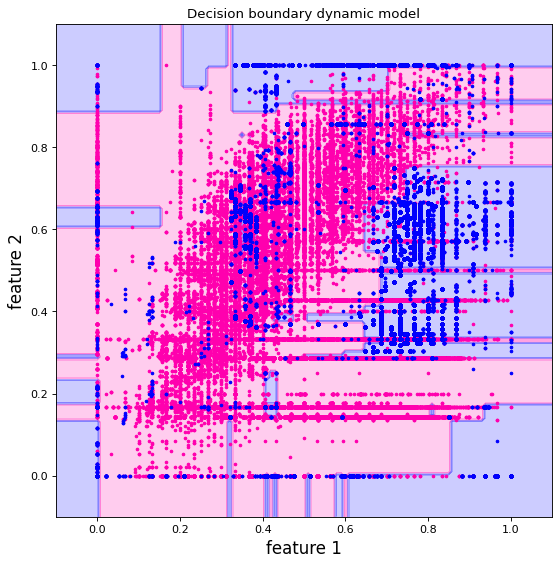

windows number 183
the len of 1000 new records appended to static data set is  451066 



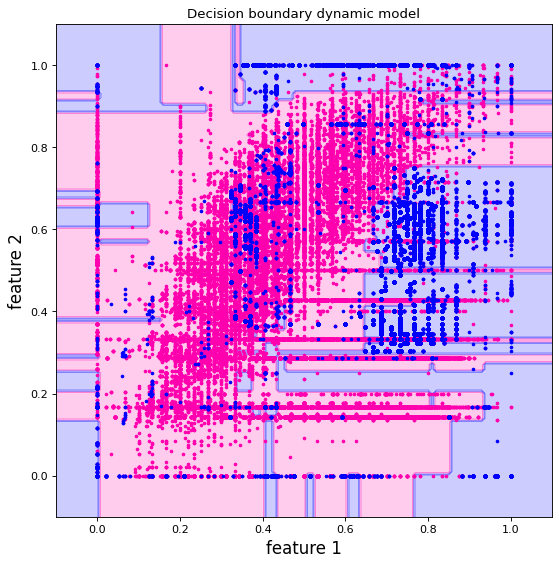

windows number 184
the len of 1000 new records appended to static data set is  452066 



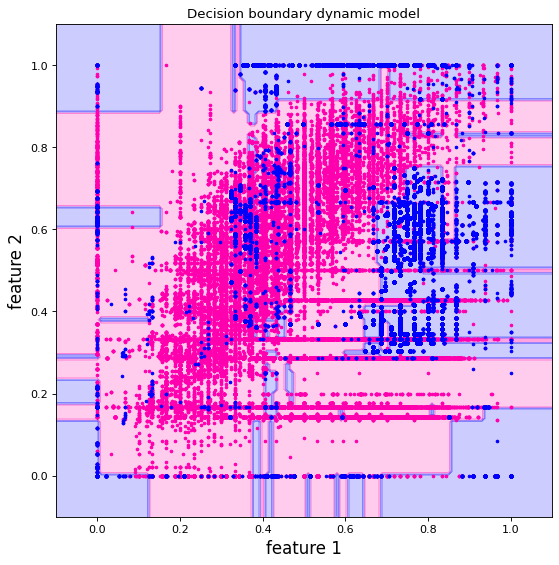

windows number 185
the len of 1000 new records appended to static data set is  453066 



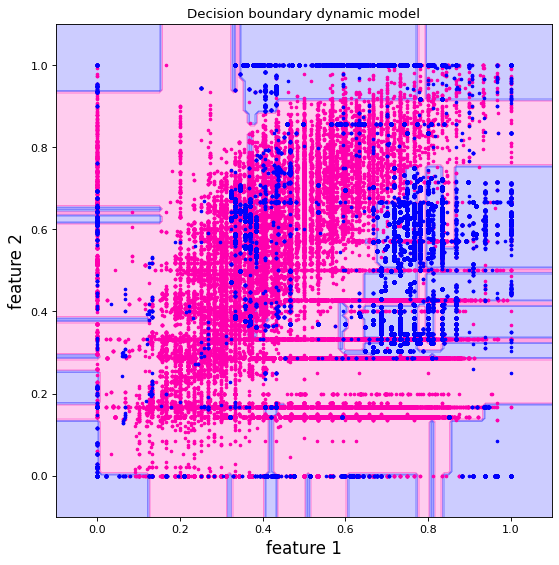

windows number 186
the len of 1000 new records appended to static data set is  454066 



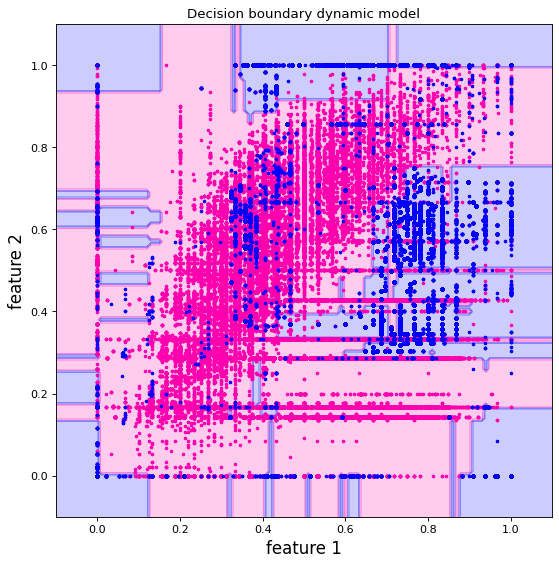

windows number 187
the len of 1000 new records appended to static data set is  455066 



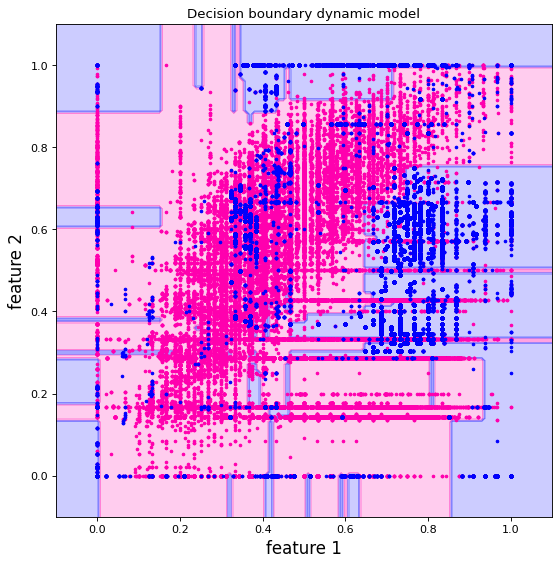

windows number 188
the len of 1000 new records appended to static data set is  456066 



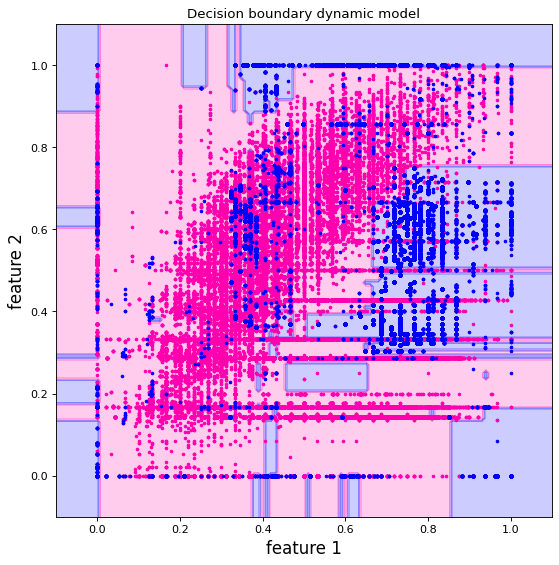

windows number 189
the len of 1000 new records appended to static data set is  457066 



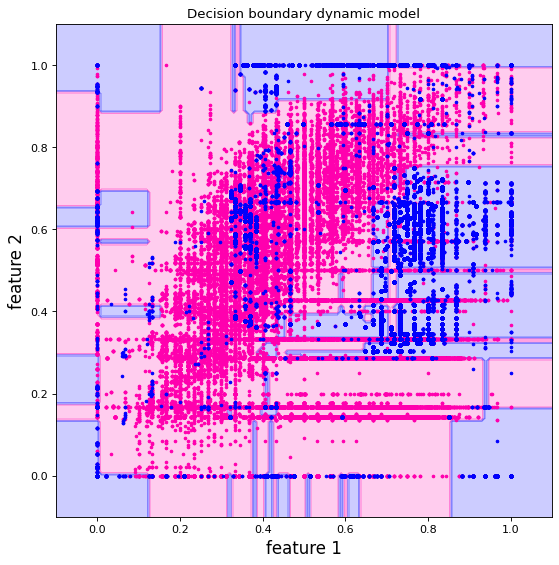

windows number 190
the len of 1000 new records appended to static data set is  458066 



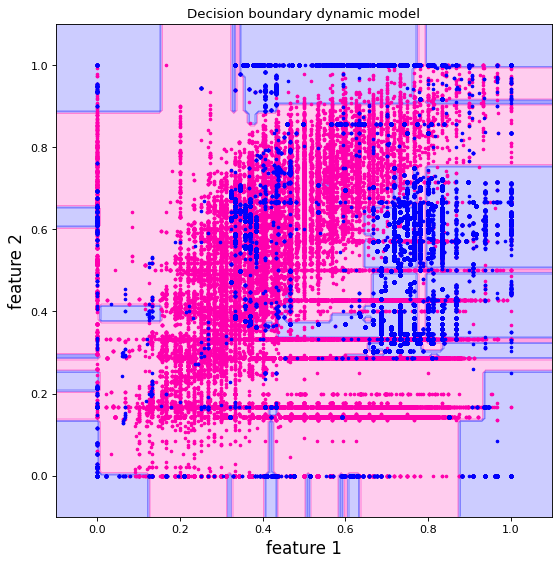

windows number 191
the len of 1000 new records appended to static data set is  459066 



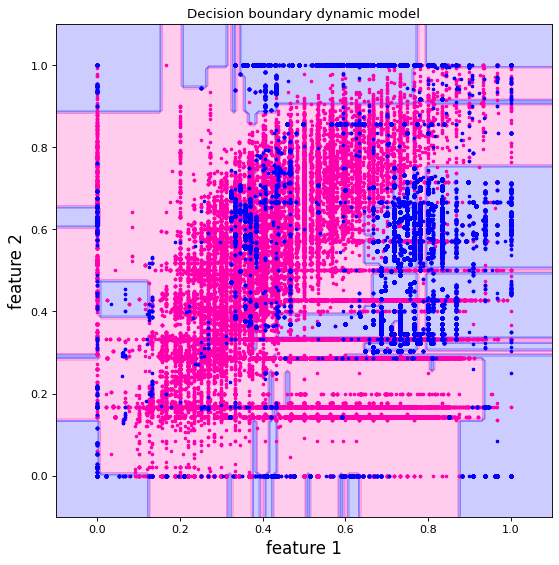

windows number 192
the len of 1000 new records appended to static data set is  460066 



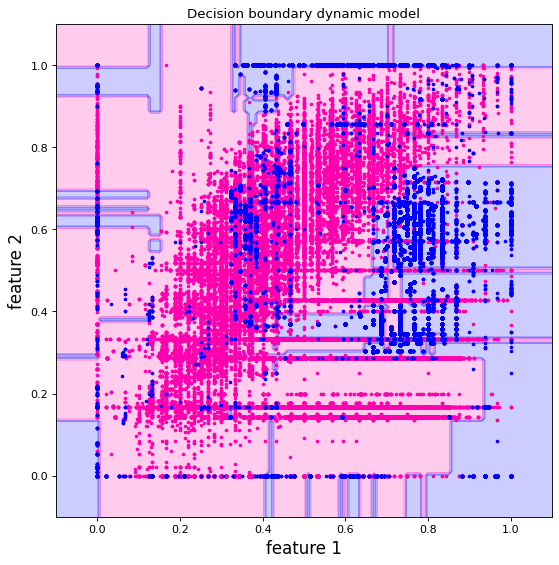

windows number 193
the len of 1000 new records appended to static data set is  461066 



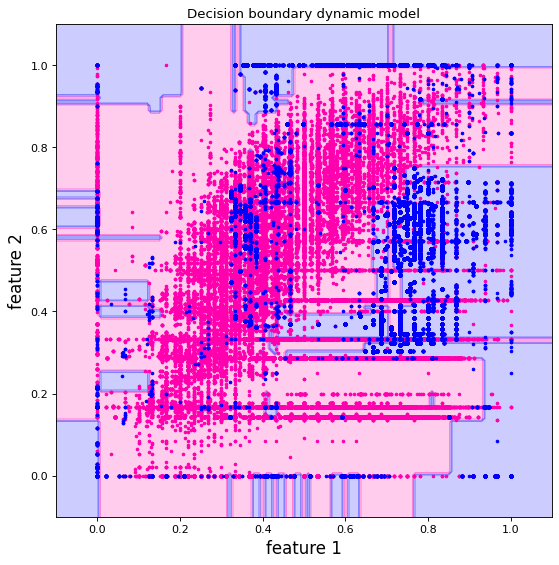

windows number 194
the len of 1000 new records appended to static data set is  462066 



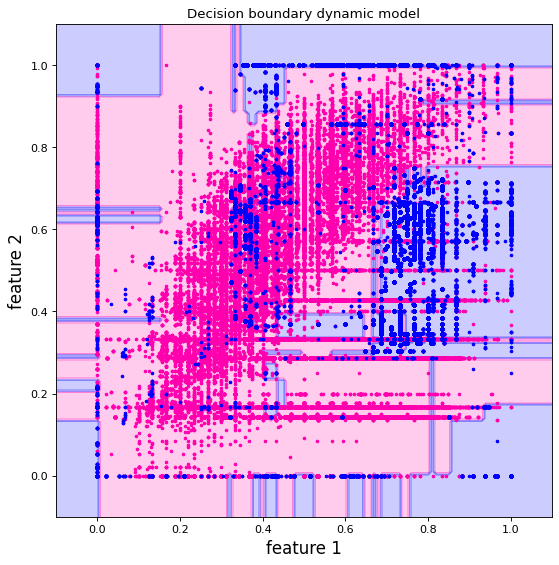

windows number 195
the len of 1000 new records appended to static data set is  463066 



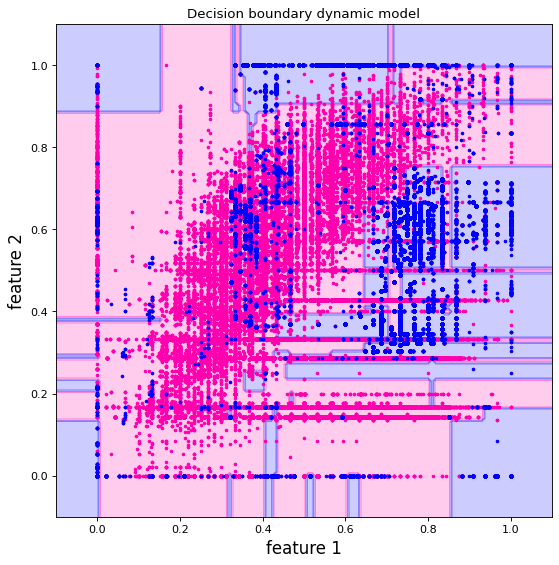

windows number 196
the len of 1000 new records appended to static data set is  464066 



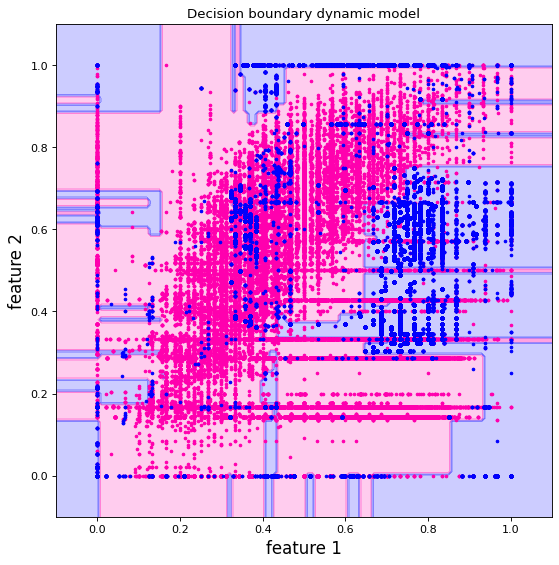

windows number 197
the len of 1000 new records appended to static data set is  465066 



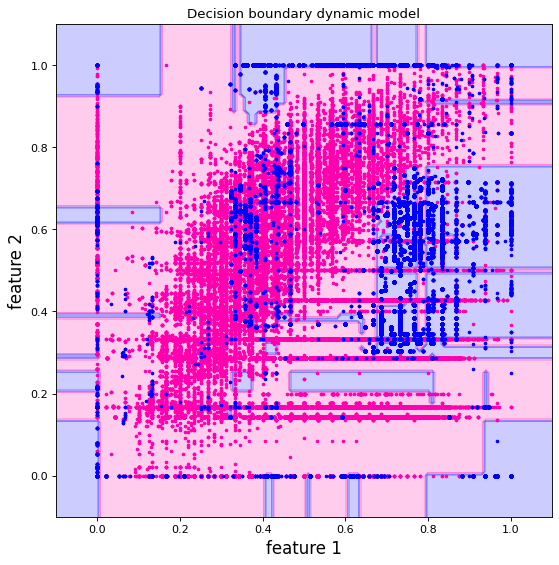

windows number 198
the len of 1000 new records appended to static data set is  466066 



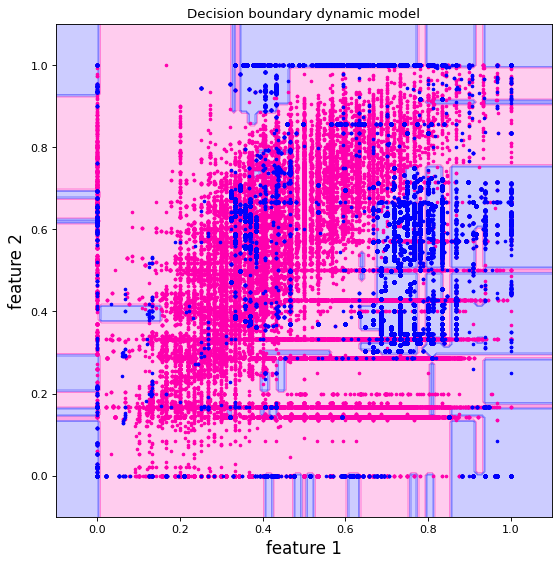

windows number 199
the len of 1000 new records appended to static data set is  467066 



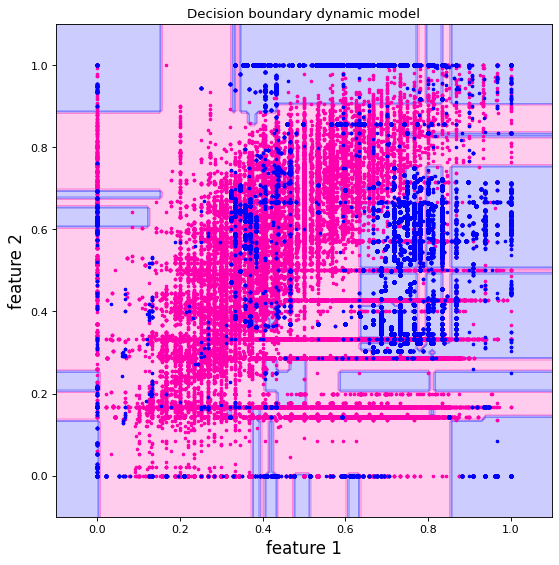

windows number 200
the len of 1000 new records appended to static data set is  468066 



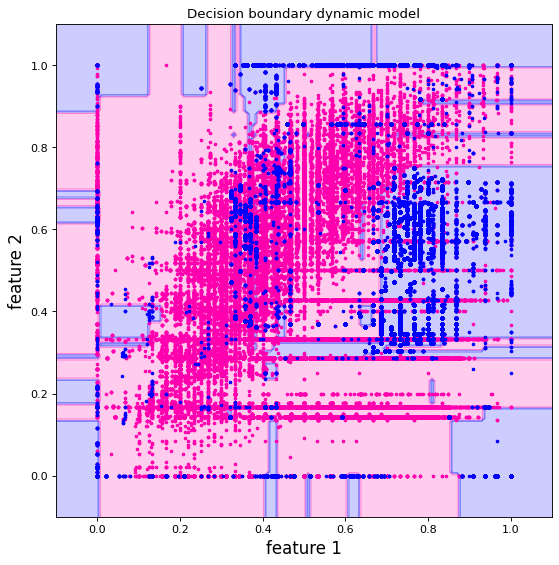

windows number 201
the len of 1000 new records appended to static data set is  469066 



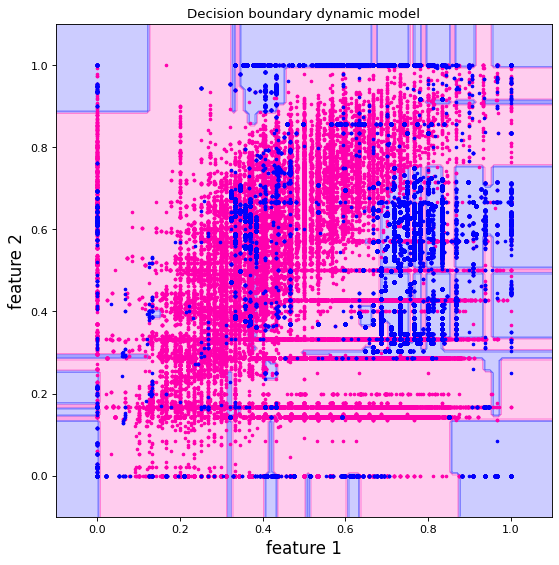

windows number 202
the len of 1000 new records appended to static data set is  470066 



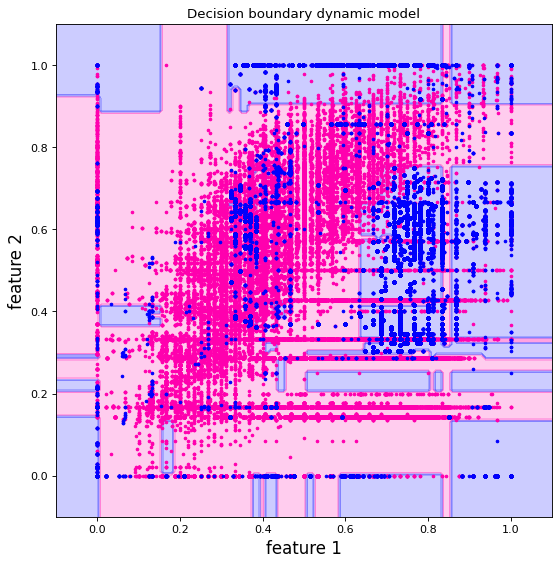

windows number 203
the len of 1000 new records appended to static data set is  471066 



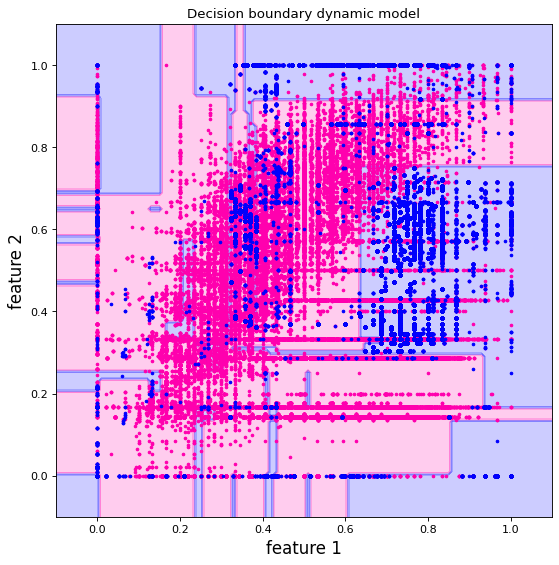

windows number 204
the len of 1000 new records appended to static data set is  472066 



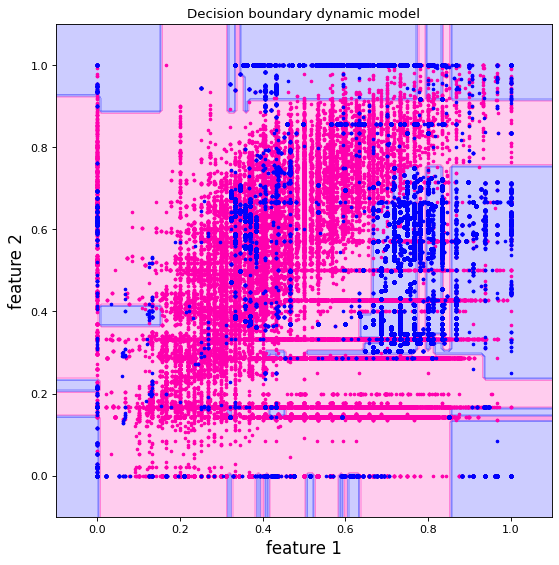

windows number 205
the len of 1000 new records appended to static data set is  473066 



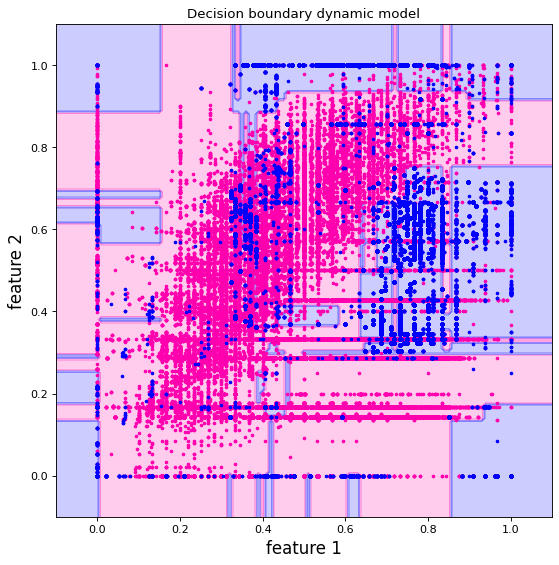

windows number 206
the len of 1000 new records appended to static data set is  474066 



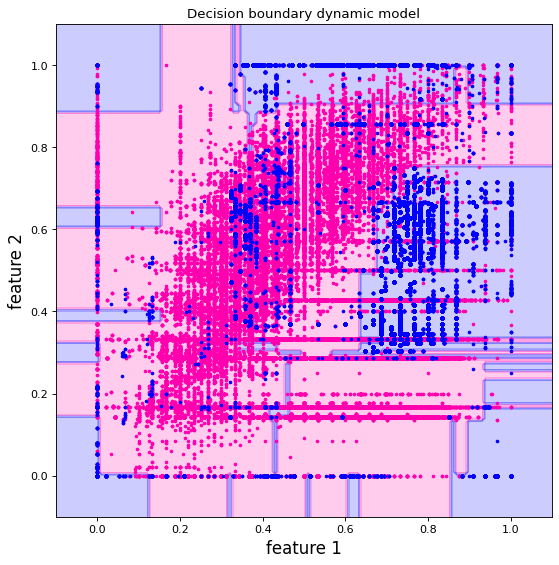

windows number 207
the len of 1000 new records appended to static data set is  475066 



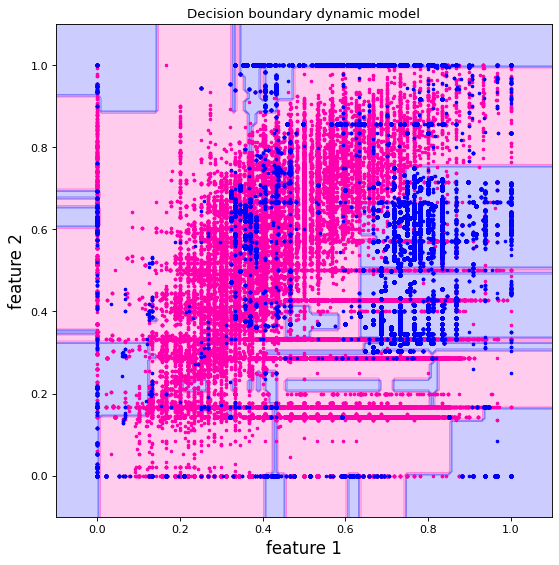

windows number 208
the len of 1000 new records appended to static data set is  476066 



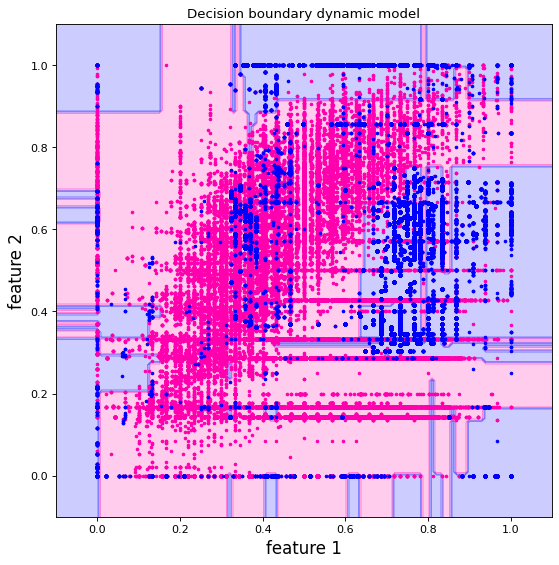

windows number 209
the len of 1000 new records appended to static data set is  477066 



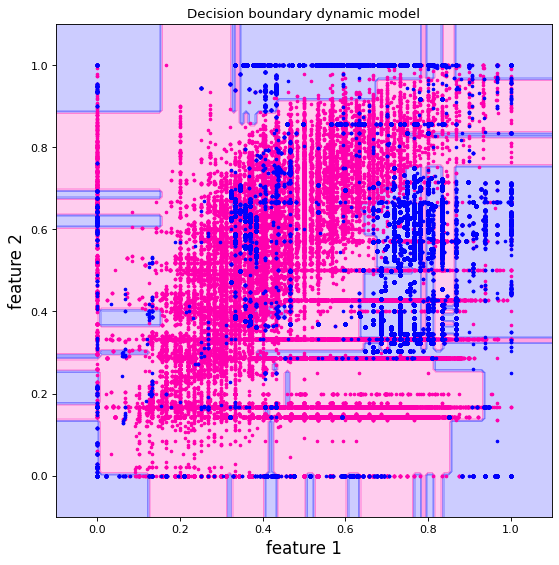

windows number 210
the len of 1000 new records appended to static data set is  478066 



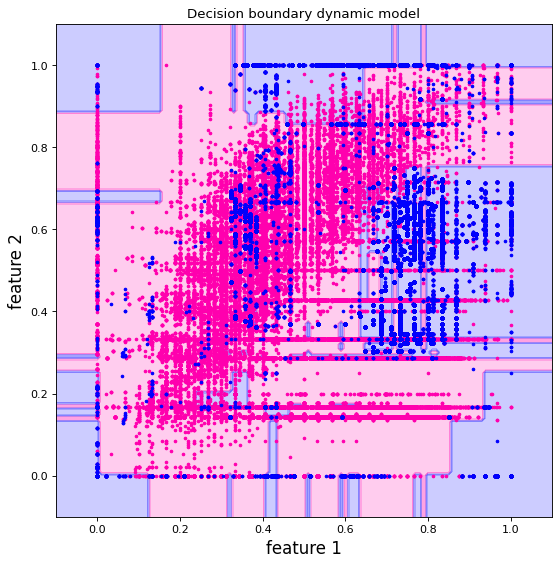

windows number 211
the len of 1000 new records appended to static data set is  479066 



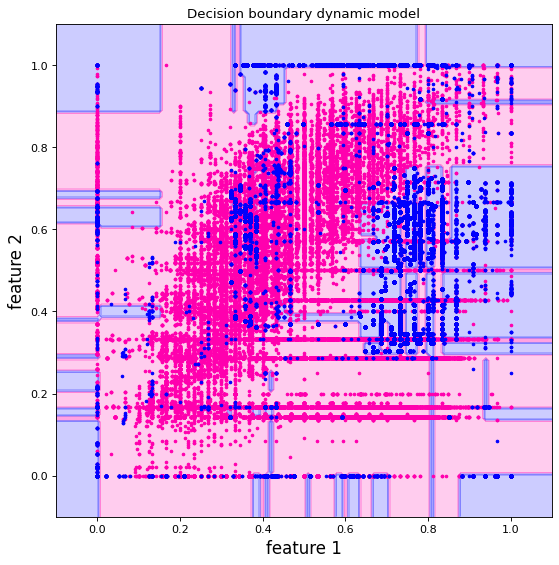

windows number 212
the len of 1000 new records appended to static data set is  480066 



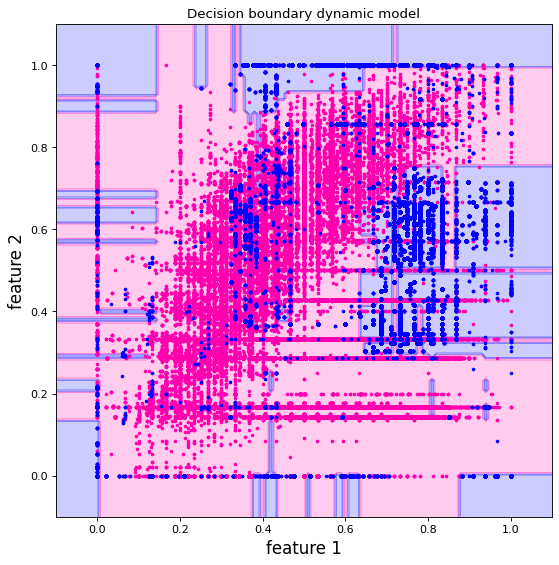

windows number 213
the len of 1000 new records appended to static data set is  481066 



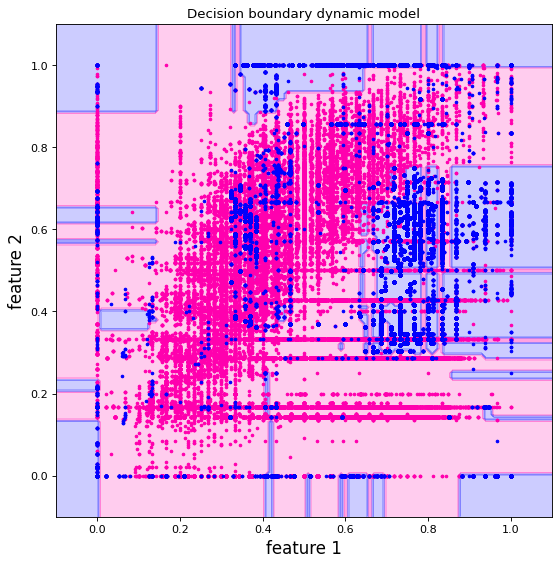

windows number 214
the len of 1000 new records appended to static data set is  482066 



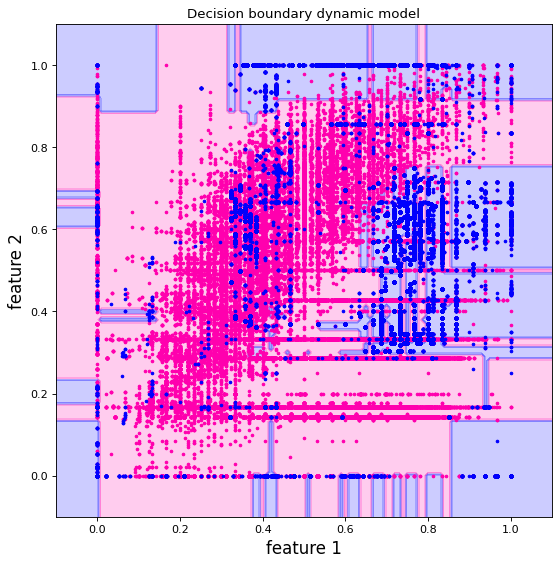

windows number 215
the len of 1000 new records appended to static data set is  483066 



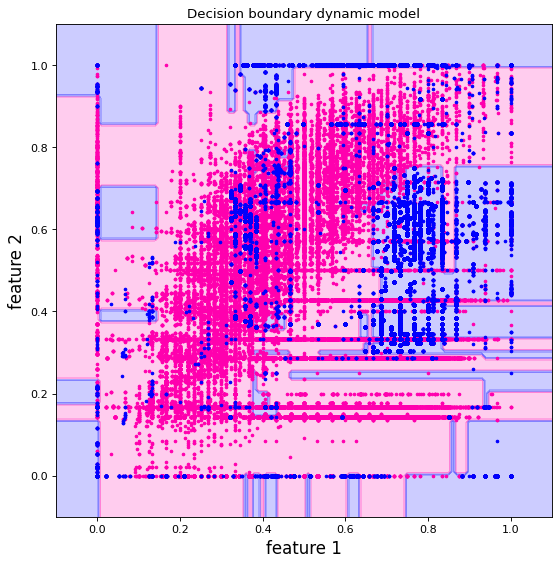

windows number 216
the len of 1000 new records appended to static data set is  484066 



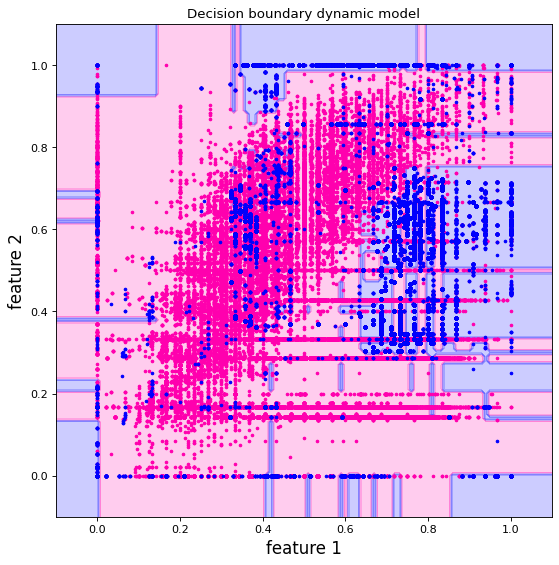

windows number 217
the len of 1000 new records appended to static data set is  485066 



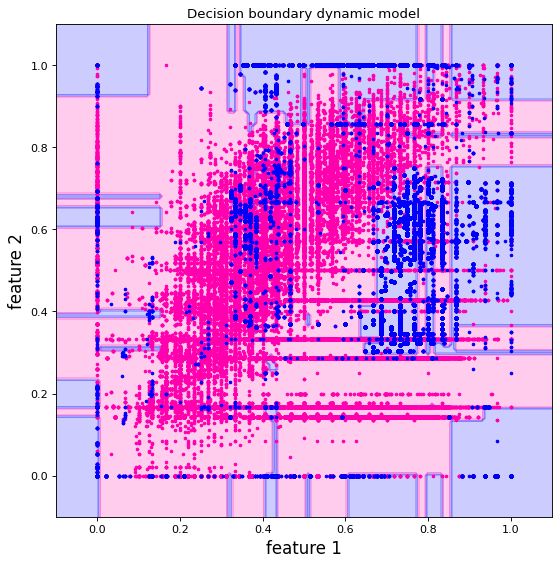

windows number 218
the len of 1000 new records appended to static data set is  486066 



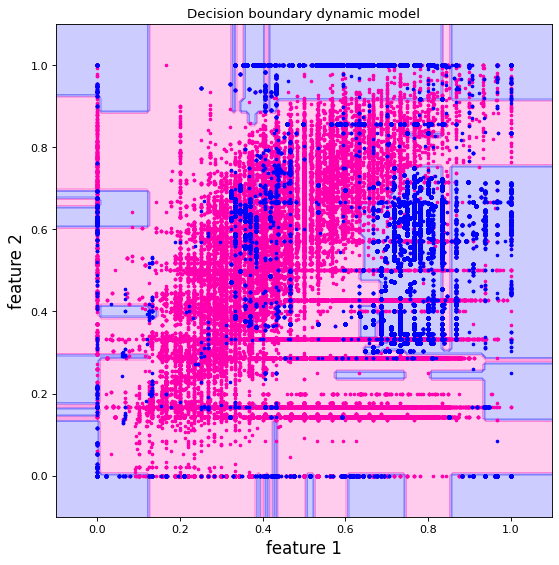

windows number 219
the len of 1000 new records appended to static data set is  487066 



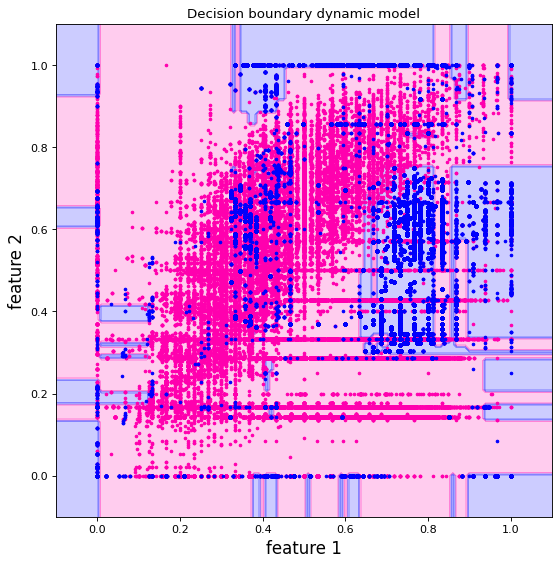

windows number 220
the len of 1000 new records appended to static data set is  488066 



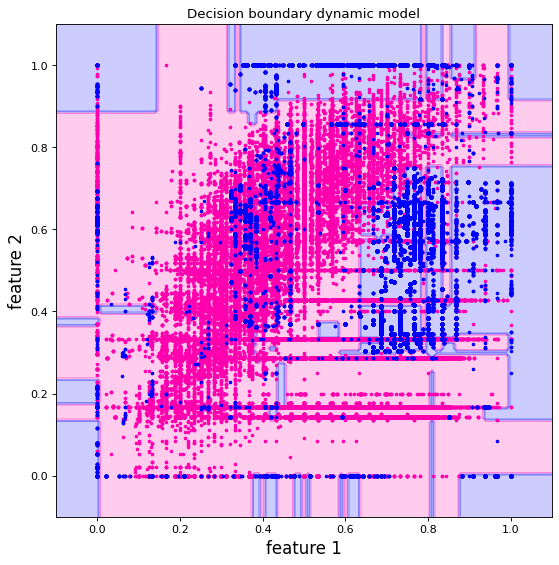

windows number 221
the len of 1000 new records appended to static data set is  489066 



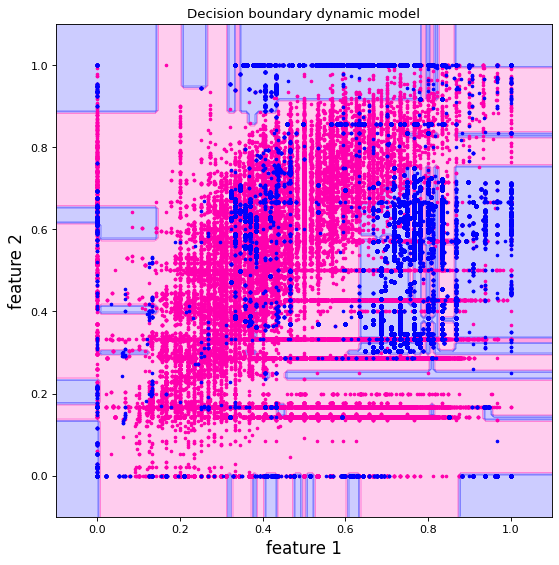

windows number 222
the len of 1000 new records appended to static data set is  490066 



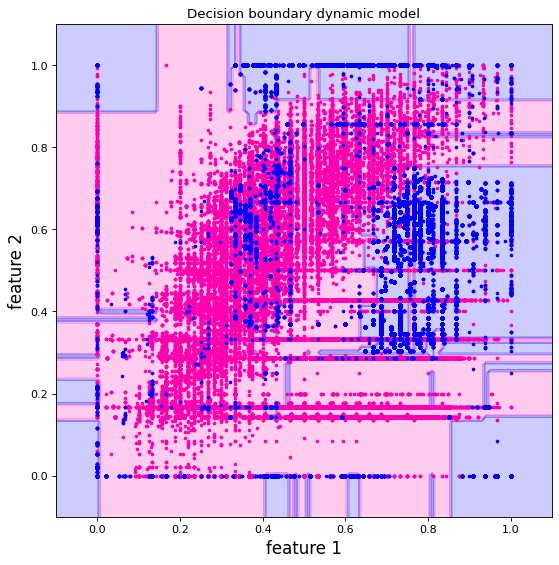

windows number 223
the len of 1000 new records appended to static data set is  491066 



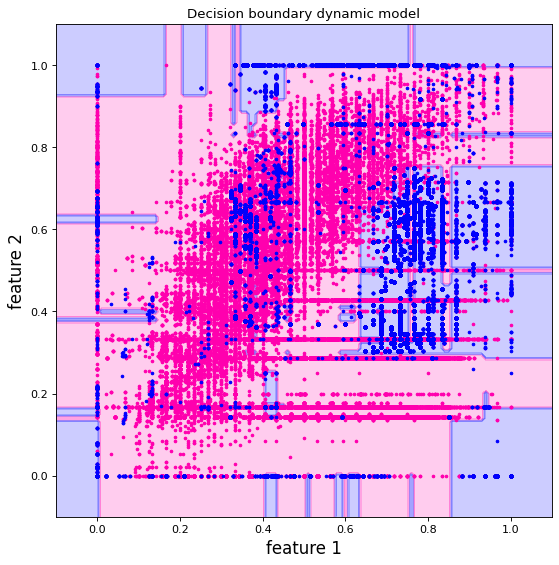

windows number 224
the len of 1000 new records appended to static data set is  492066 



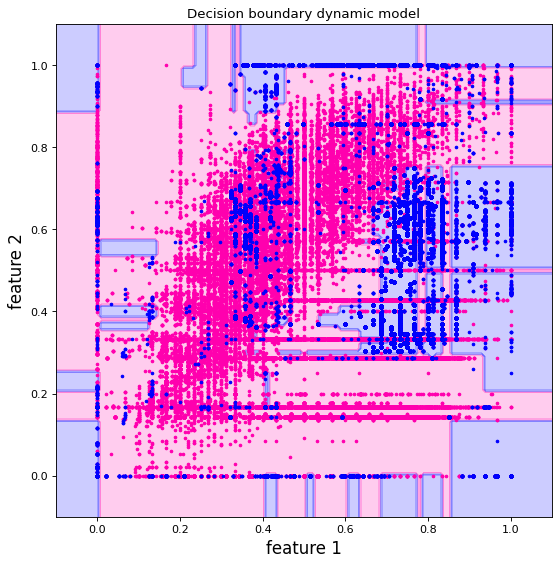

windows number 225
the len of 1000 new records appended to static data set is  493066 



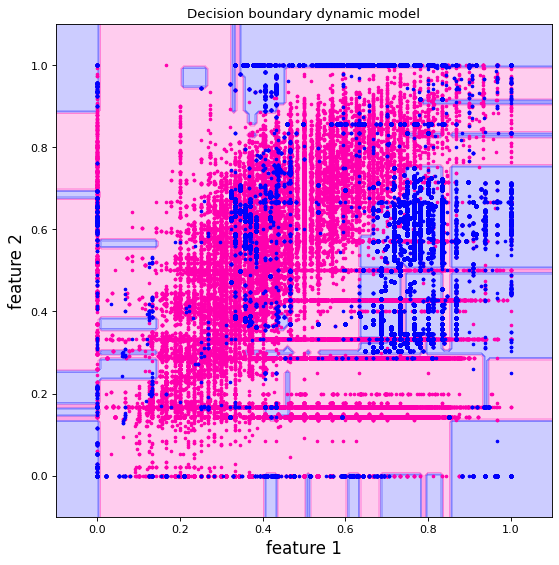

windows number 226
the len of 1000 new records appended to static data set is  494066 



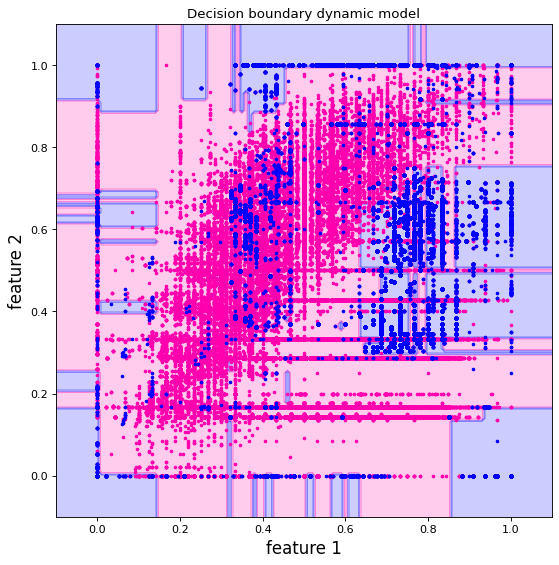

windows number 227
the len of 1000 new records appended to static data set is  495066 



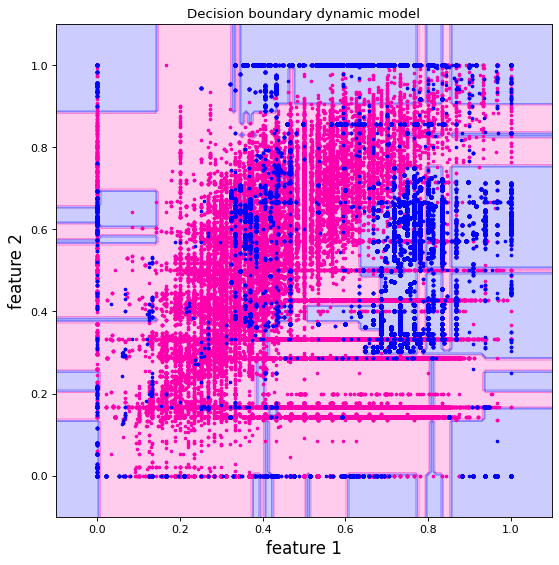

windows number 228
the len of 1000 new records appended to static data set is  496066 



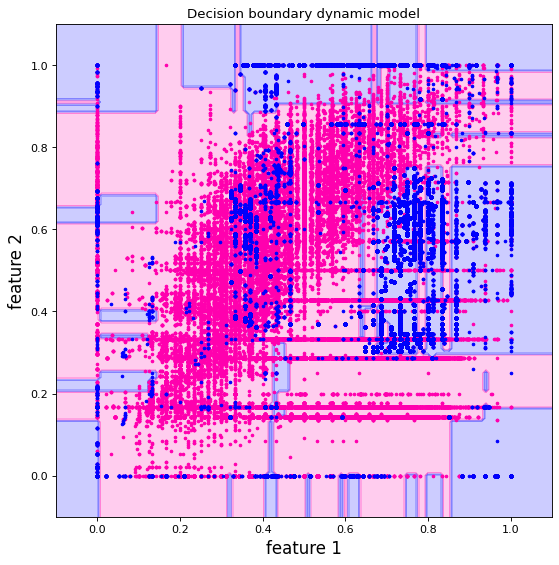

windows number 229
the len of 1000 new records appended to static data set is  497066 



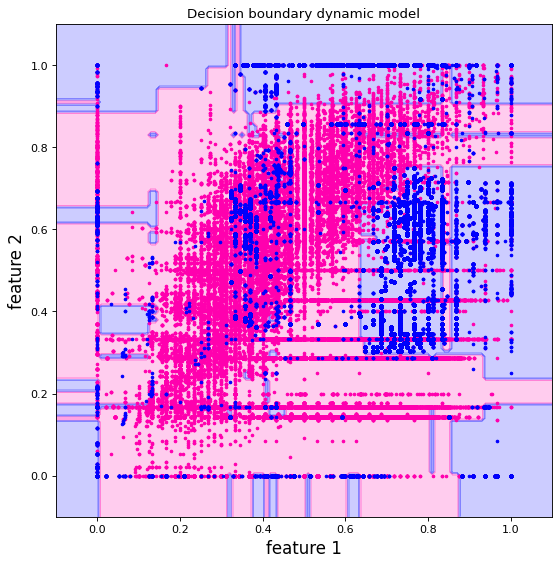

windows number 230
the len of 1000 new records appended to static data set is  498066 



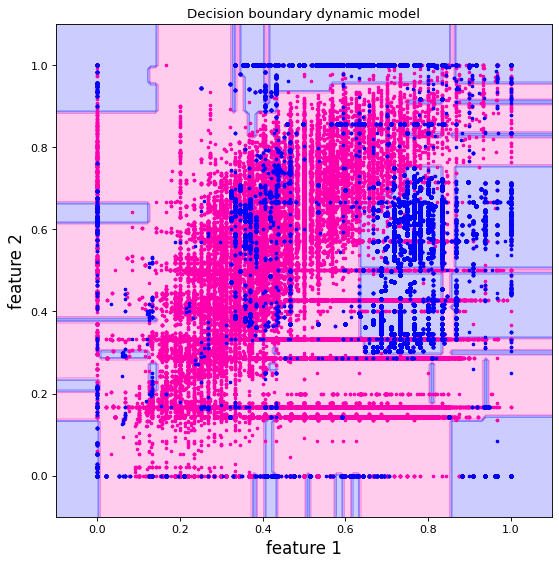

windows number 231
the len of 1000 new records appended to static data set is  499066 



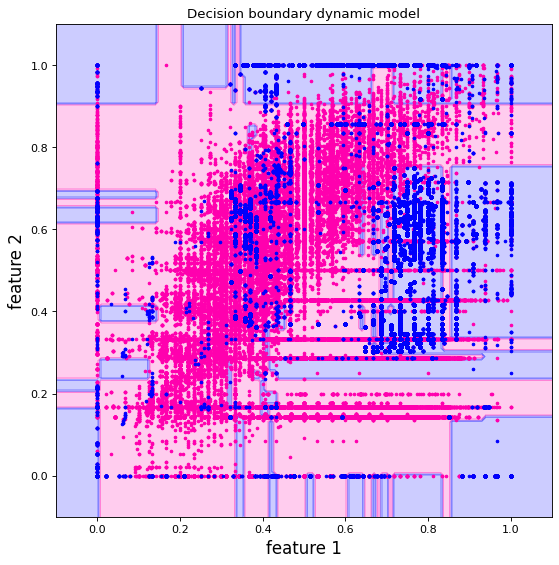

windows number 232
the len of 1000 new records appended to static data set is  500066 



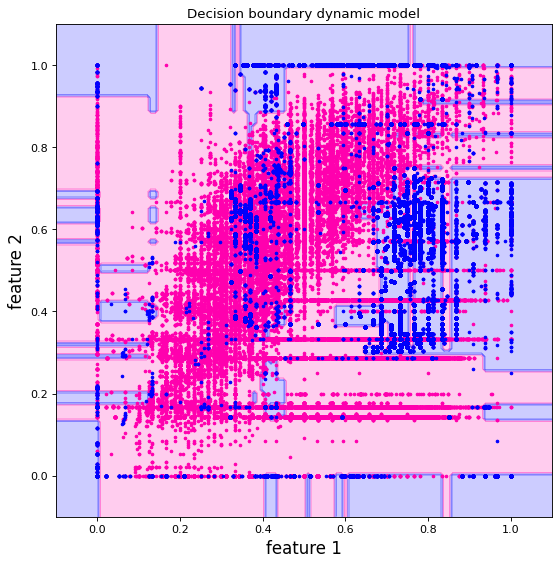

windows number 233
the len of 1000 new records appended to static data set is  501066 



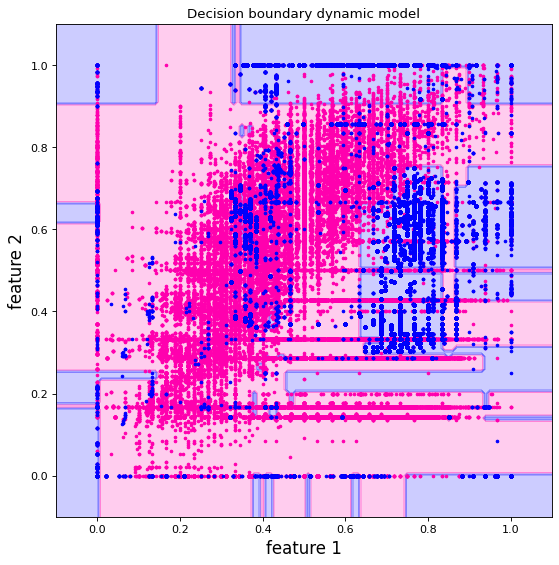

windows number 234
the len of 1000 new records appended to static data set is  502066 



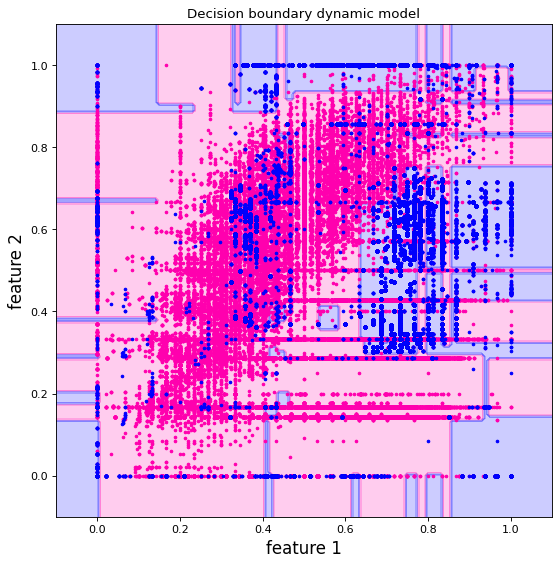

windows number 235
the len of 1000 new records appended to static data set is  503066 



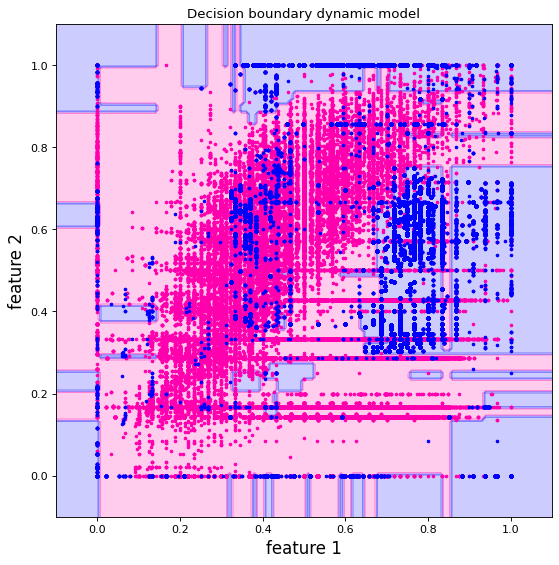

windows number 236
the len of 1000 new records appended to static data set is  504066 



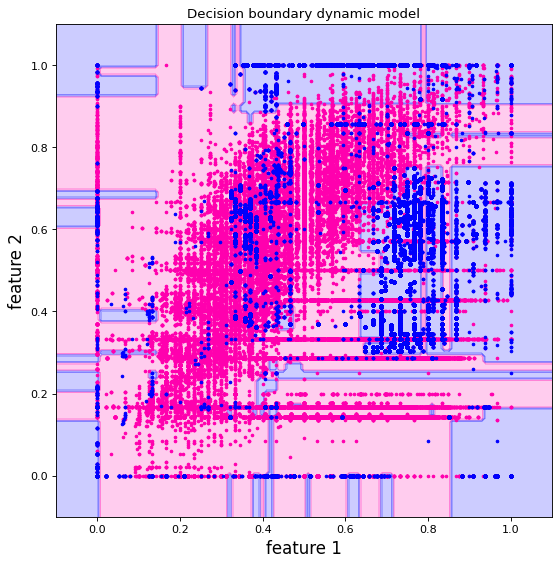

windows number 237
the len of 1000 new records appended to static data set is  505066 



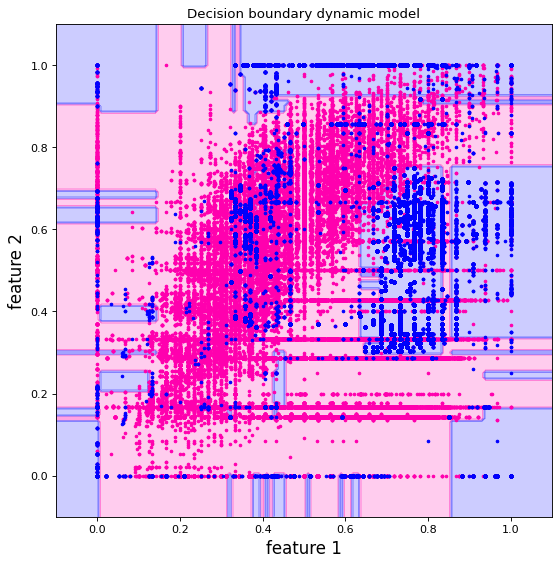

windows number 238
the len of 1000 new records appended to static data set is  506066 



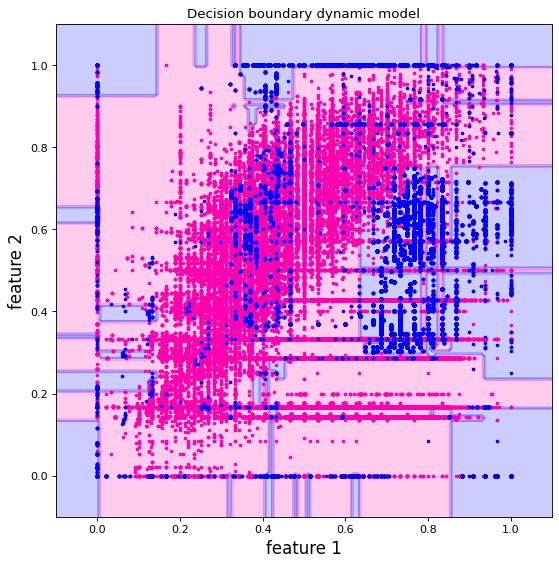

windows number 239
the len of 1000 new records appended to static data set is  507066 



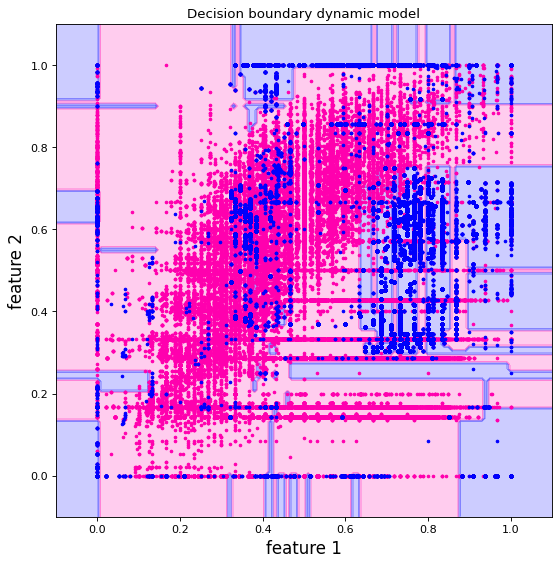

windows number 240
the len of 1000 new records appended to static data set is  508066 



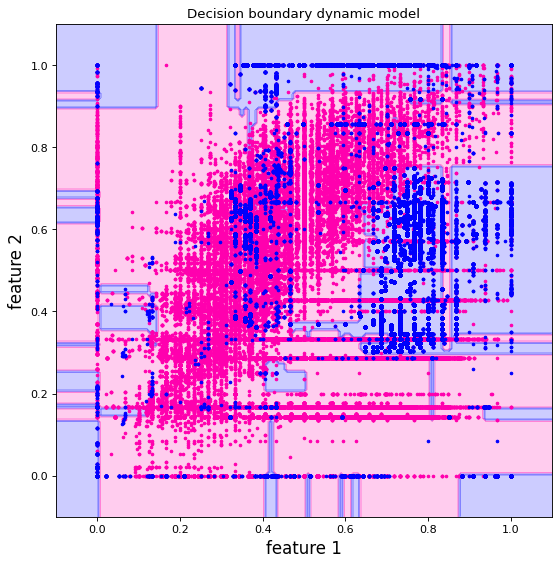

windows number 241
the len of 1000 new records appended to static data set is  509066 



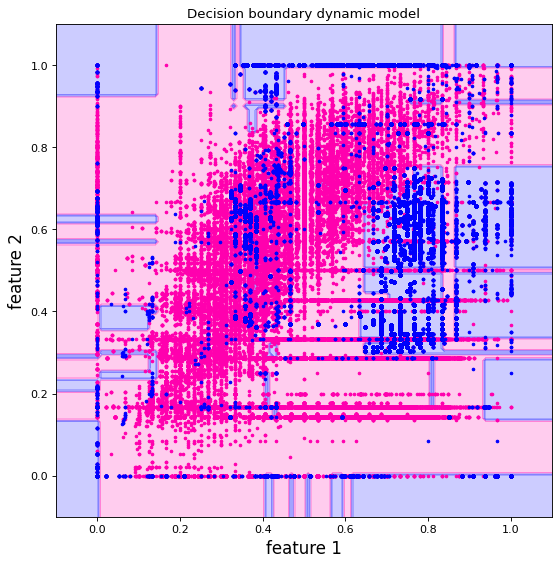

windows number 242
the len of 1000 new records appended to static data set is  510066 



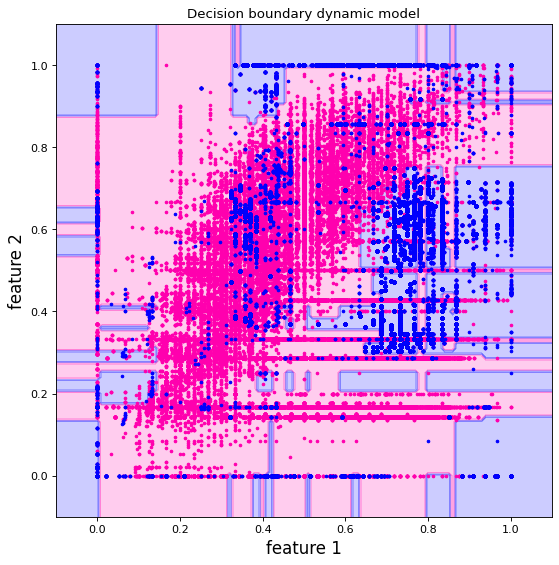

windows number 243
the len of 1000 new records appended to static data set is  511066 



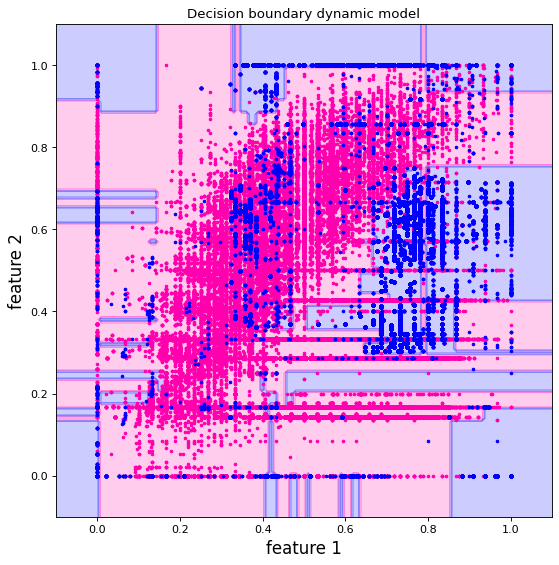

windows number 244
the len of 1000 new records appended to static data set is  512066 



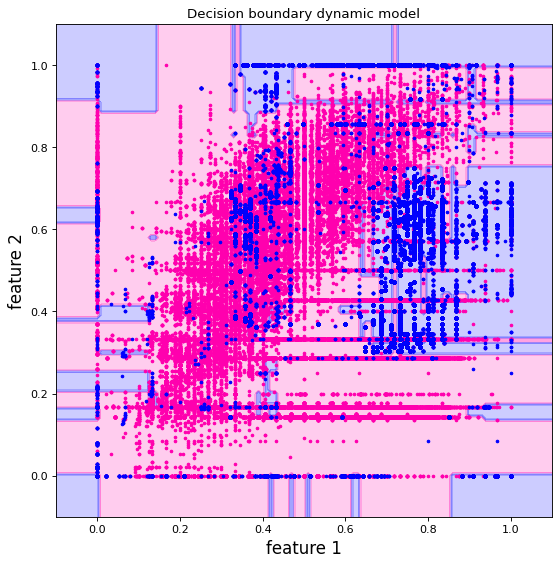

windows number 245
the len of 1000 new records appended to static data set is  513066 



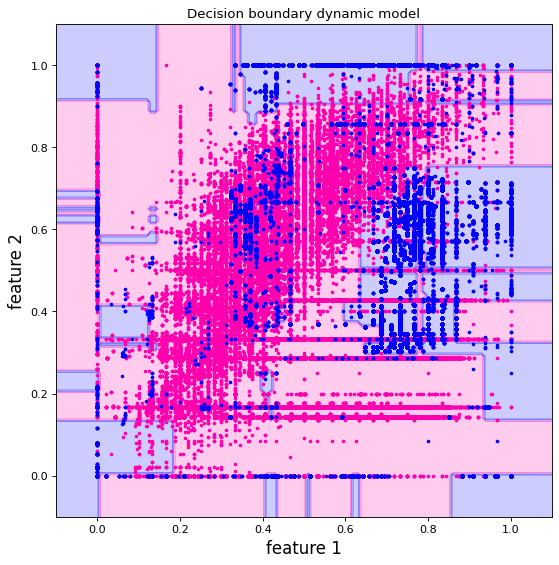

windows number 246
the len of 1000 new records appended to static data set is  514066 



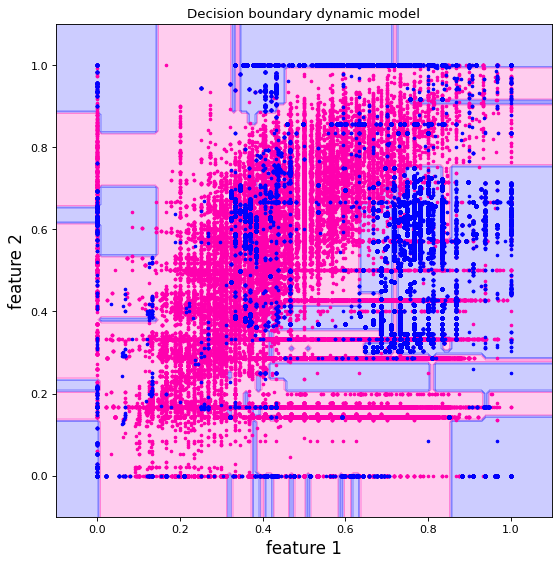

windows number 247
the len of 1000 new records appended to static data set is  515066 



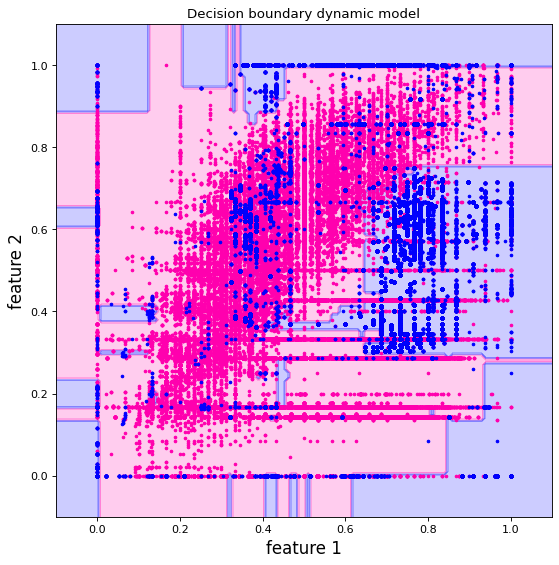

windows number 248
the len of 1000 new records appended to static data set is  516066 



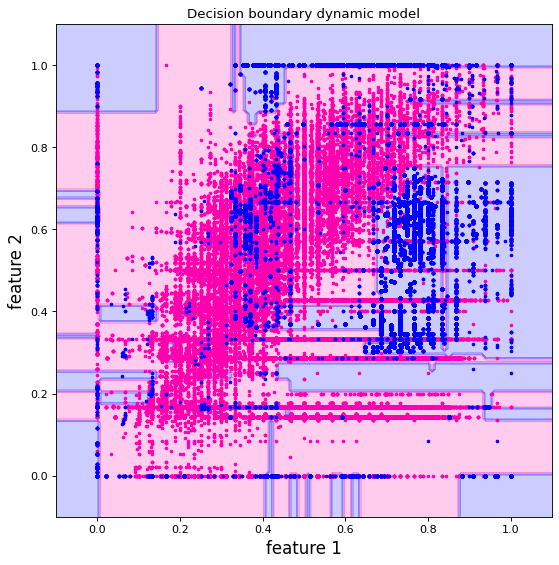

windows number 249
the len of 1000 new records appended to static data set is  517066 



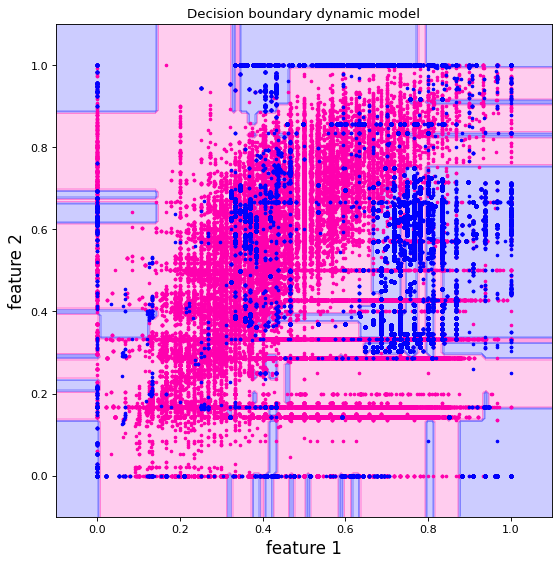

windows number 250
the len of 1000 new records appended to static data set is  518066 



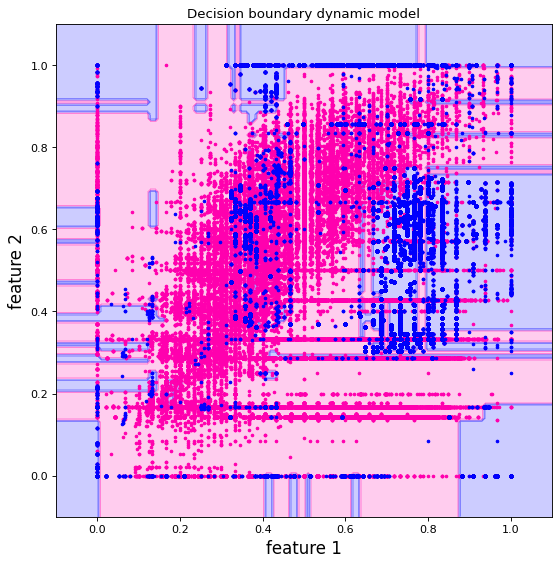

windows number 251
the len of 1000 new records appended to static data set is  519066 



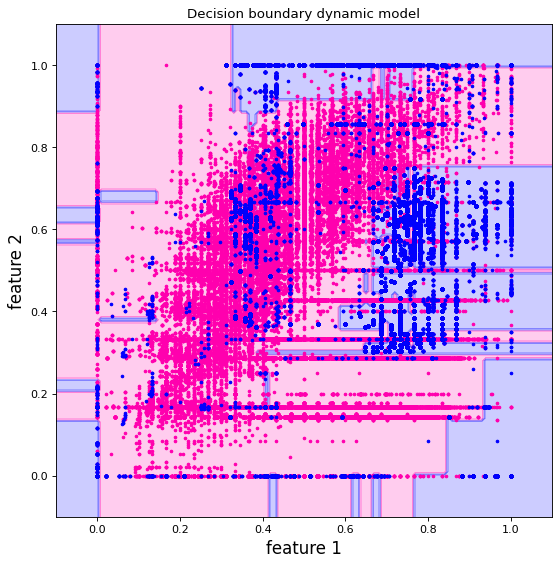

windows number 252
the len of 1000 new records appended to static data set is  520066 



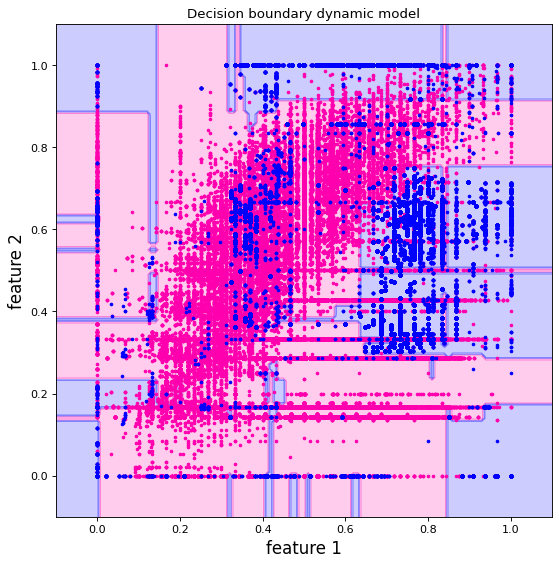

windows number 253
the len of 1000 new records appended to static data set is  521066 



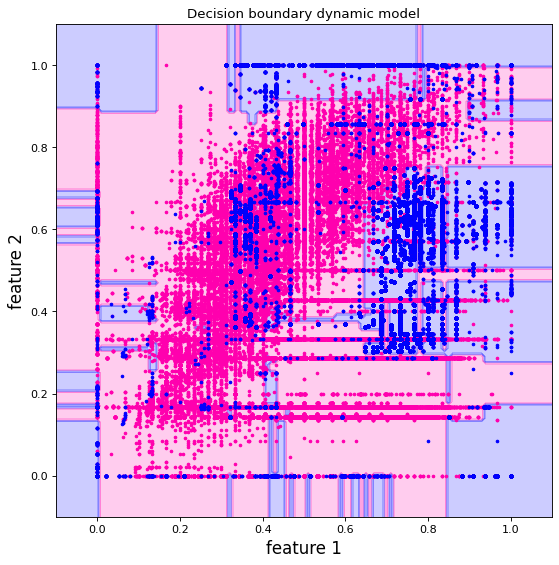

windows number 254
the len of 1000 new records appended to static data set is  522066 



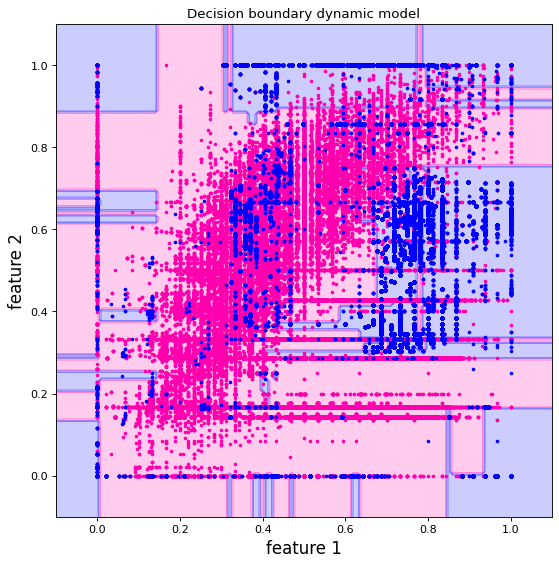

windows number 255
the len of 1000 new records appended to static data set is  523066 



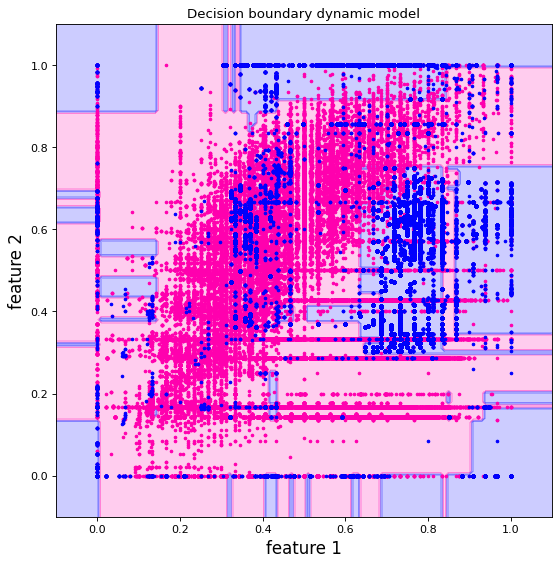

windows number 256
the len of 1000 new records appended to static data set is  524066 



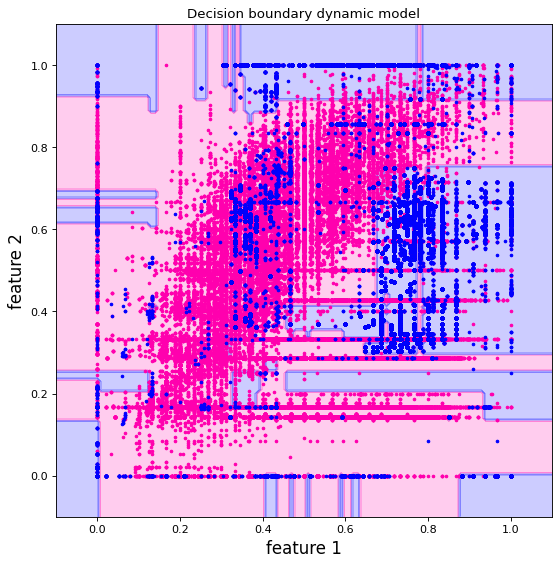

windows number 257
the len of 1000 new records appended to static data set is  525066 



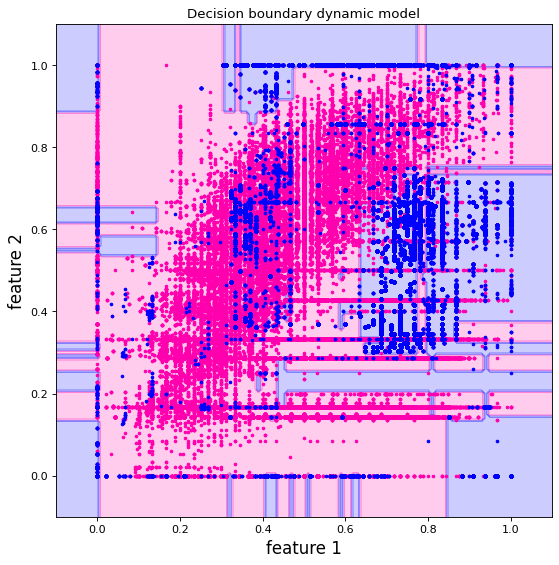

windows number 258
the len of 1000 new records appended to static data set is  526066 



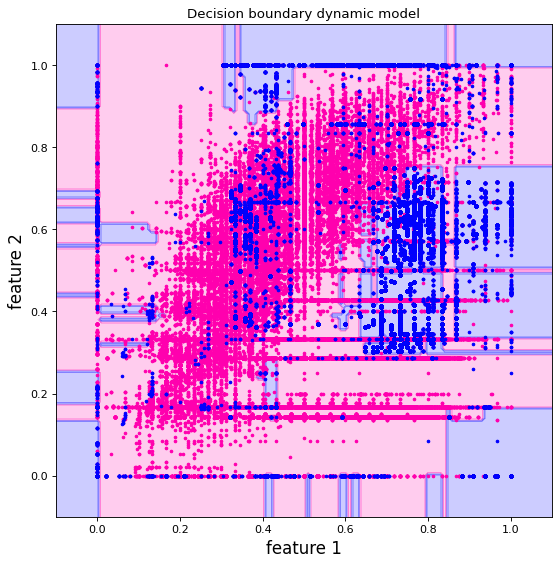

windows number 259
the len of 1000 new records appended to static data set is  527066 



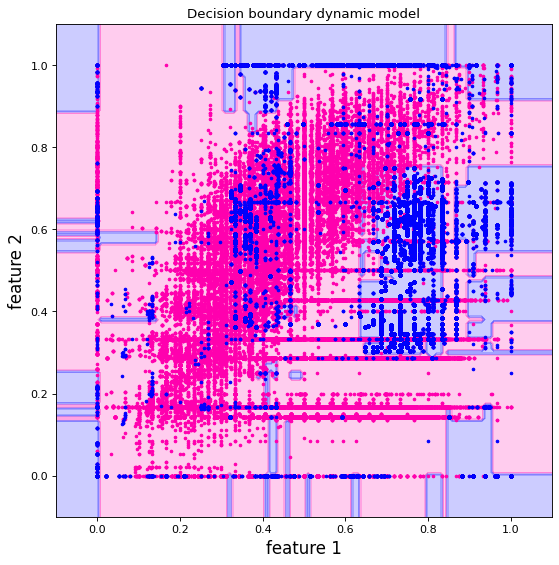

windows number 260
the len of 1000 new records appended to static data set is  528066 



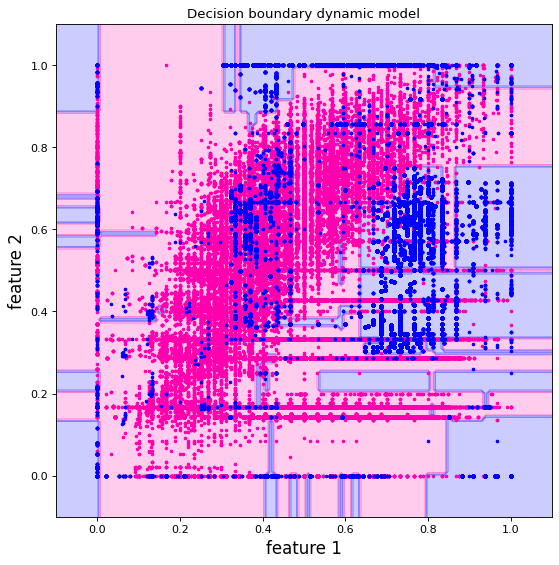

windows number 261
the len of 1000 new records appended to static data set is  529066 



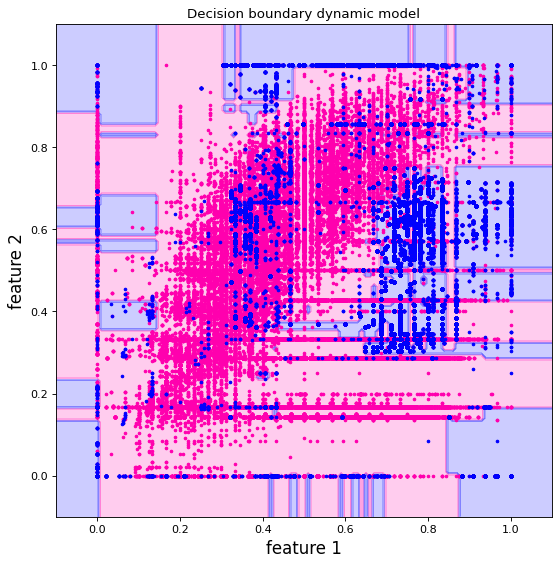

windows number 262
the len of 1000 new records appended to static data set is  530066 



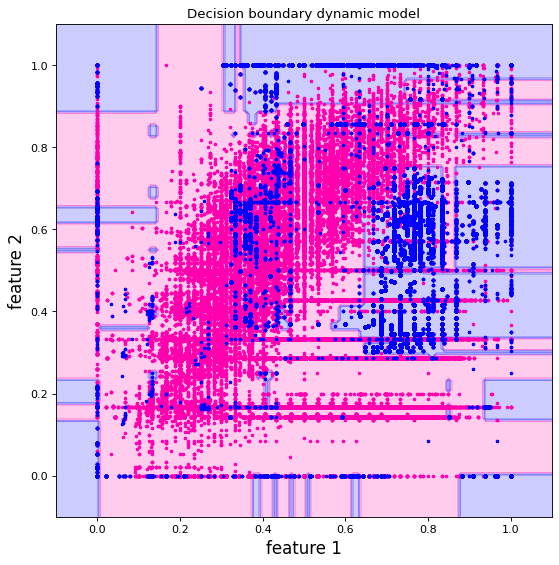

windows number 263
the len of 1000 new records appended to static data set is  531066 



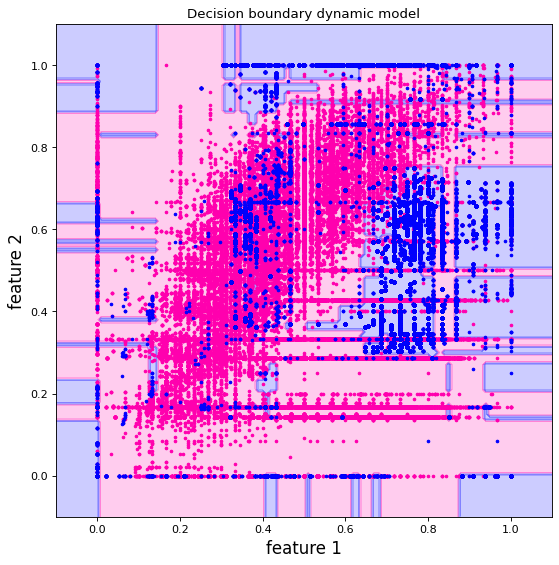

windows number 264
the len of 1000 new records appended to static data set is  532066 



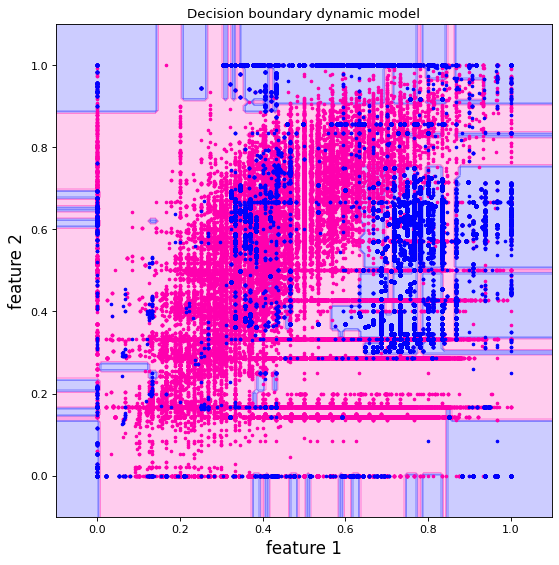

windows number 265
the len of 1000 new records appended to static data set is  533066 



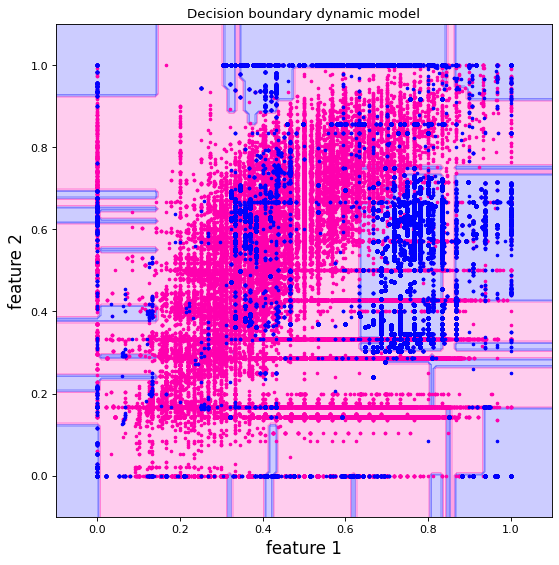

In [ ]:
Dynamic_accurices = []
Dynamic_f1_scores = []

copy_preprocessed_static_dataset = preprocessed_static_dataset.copy()

for iteration in range(265):
    new1000_records = append_1000_observations(iteration + 1)
    
    df_1000 =  bytes_to_df(new1000_records)
    
    preprocessed_df = Preprocessing_Pipeline(df_1000)
    
    copy_preprocessed_static_dataset = pd.concat([copy_preprocessed_static_dataset, preprocessed_df])
    print("the len of 1000 new records appended to static data set is ",len(copy_preprocessed_static_dataset), "\n")
    
    x = copy_preprocessed_static_dataset.iloc[:,0:2]
    y = copy_preprocessed_static_dataset.iloc[:,5]
   
    dynamic_model.fit(x,y)
    dynamic_preds = dynamic_model.predict(x)
    
    Dynamic_accurices.append(accuracy_score(y,dynamic_preds))
    Dynamic_f1_scores.append(f1_score(y, dynamic_preds, average="macro"))
    
    ListOfClasses = GetListOfClasses(2, x, y)
    
    Boundaries(pd.DataFrame(x),dynamic_model,'dynamic_model', 2)
    PlotDataPoints(2,colorsOptions ,ListOfClasses, "feature 1", "feature 2" ,[0,1] ,5, "Decision boundary dynamic model")
    img_name = "image_" + str(iteration) +"_.png"
    plt.savefig(img_name)
    plt.show()

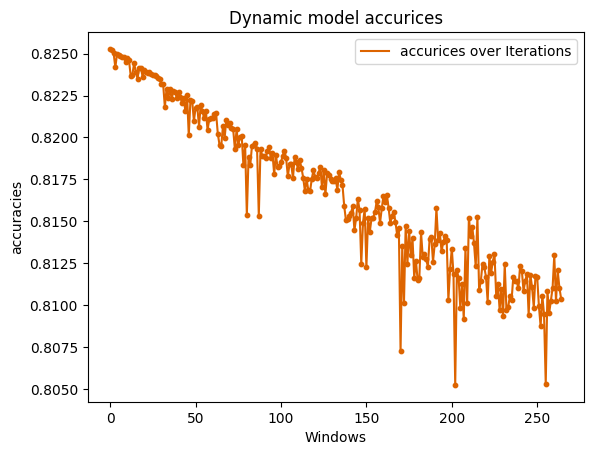

In [ ]:
Plot(range(265),Dynamic_accurices,"accurices over Iterations", "#DD6400", "o", 10, "Windows", "accuracies", "Dynamic model accurices")
plt.show()

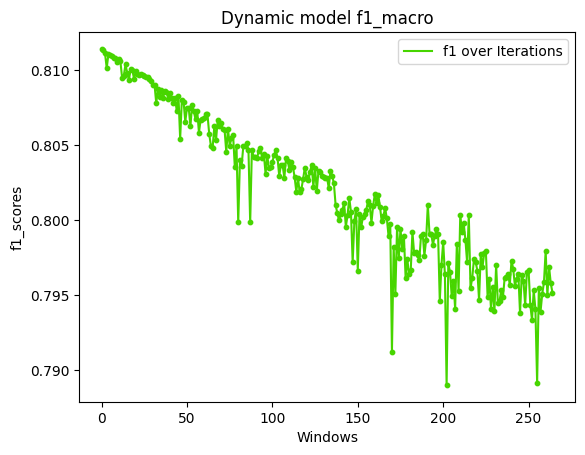

In [ ]:
Plot(range(265),Dynamic_f1_scores,"f1 over Iterations", "#47D500", "o", 10, "Windows", "f1_scores", "Dynamic model f1_macro")
plt.show()

In [ ]:
consumer = KafkaConsumer(
    'ml-raw-dns',
    bootstrap_servers="localhost:9092",
    auto_offset_reset='earliest',
    enable_auto_commit=False
)

## <font color='#18A558'>***Retraining the Dynamic model on the original features from preprocessed dataset of static and kafka.***</font>
---

## <font color='#18A558'>***And comparing the results of both Dynamic and Static model***</font>
---

In [ ]:
Dynamic_accurices = []
Dynamic_f1_scores = []

Static_accurices = []
Static_f1_scores = []

copy_preprocessed_static_dataset = preprocessed_static_dataset.copy()

for iteration in range(265):
    new1000_records = append_1000_observations(iteration + 1)
    
    df_1000 =  bytes_to_df(new1000_records)
    
    preprocessed_df = Preprocessing_Pipeline(df_1000)
    
    copy_preprocessed_static_dataset = pd.concat([copy_preprocessed_static_dataset, preprocessed_df])
    print("the len of 1000 new records appended to static data set is ",len(copy_preprocessed_static_dataset), "\n")
    
    x = copy_preprocessed_static_dataset.iloc[:,0:5]
    y = copy_preprocessed_static_dataset.iloc[:,5]
   
    dynamic_model.fit(x,y)
    dynamic_preds = dynamic_model.predict(x)
    
    Dynamic_accurices.append(accuracy_score(y,dynamic_preds))
    Dynamic_f1_scores.append(f1_score(y, dynamic_preds, average="macro"))
    
    
    static_preds = static_model.predict(x)
    Static_accurices.append(accuracy_score(y,static_preds))
    Static_f1_scores.append(f1_score(y, static_preds, average="macro"))

windows number 1
the len of 1000 new records appended to static data set is  269066 

windows number 2
the len of 1000 new records appended to static data set is  270066 

windows number 3
the len of 1000 new records appended to static data set is  271066 

windows number 4
the len of 1000 new records appended to static data set is  272066 

windows number 5
the len of 1000 new records appended to static data set is  273066 

windows number 6
the len of 1000 new records appended to static data set is  274066 

windows number 7
the len of 1000 new records appended to static data set is  275066 

windows number 8
the len of 1000 new records appended to static data set is  276066 

windows number 9
the len of 1000 new records appended to static data set is  277066 

windows number 10
the len of 1000 new records appended to static data set is  278066 

windows number 11
the len of 1000 new records appended to static data set is  279066 

windows number 12
the len of 1000 new records append

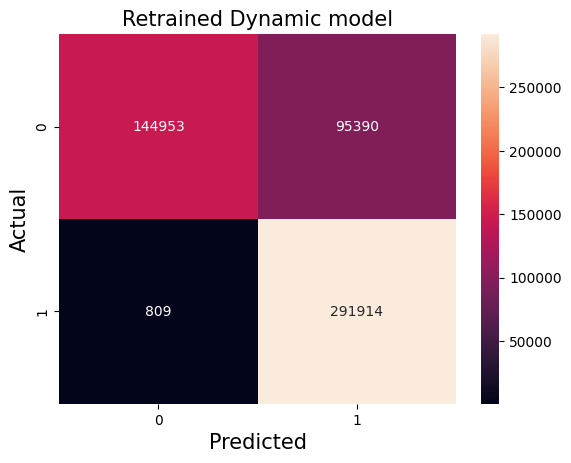

              precision    recall  f1-score   support

         0.0       0.99      0.60      0.75    240343
         1.0       0.75      1.00      0.86    292723

    accuracy                           0.82    533066
   macro avg       0.87      0.80      0.80    533066
weighted avg       0.86      0.82      0.81    533066



In [ ]:
dynamic_preds = dynamic_model.predict(x)
dynamic_cm = ConfusionMatrix(y, dynamic_preds)
PLOT_ConfusionMatrix(dynamic_cm, "Retrained Dynamic model")
dynamic_report = classification_report(y, dynamic_preds)
print(dynamic_report)

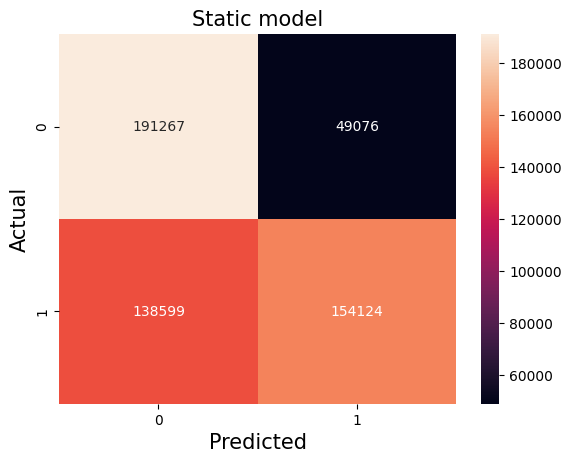

              precision    recall  f1-score   support

         0.0       0.58      0.80      0.67    240343
         1.0       0.76      0.53      0.62    292723

    accuracy                           0.65    533066
   macro avg       0.67      0.66      0.65    533066
weighted avg       0.68      0.65      0.64    533066



In [ ]:
static_preds = static_model.predict(x)
static_cm = ConfusionMatrix(y, static_preds)
PLOT_ConfusionMatrix(static_cm, "Static model")
static_report = classification_report(y, static_preds)
print(static_report)

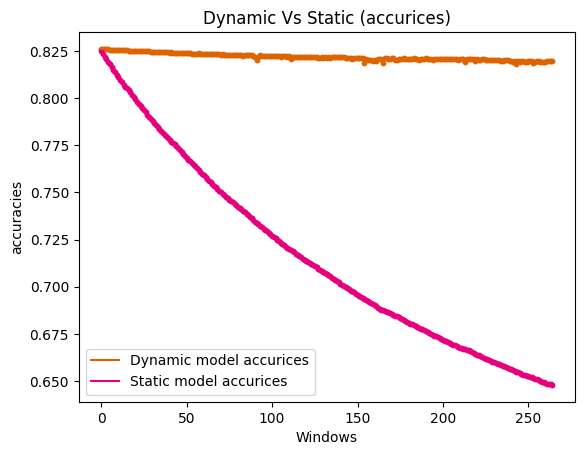

In [ ]:
Plot(range(265),Dynamic_accurices,"Dynamic model accurices", "#DD6400", "o", 10, "Windows", "accuracies", "Dynamic Vs Static (accurices)")
Plot(range(265),Static_accurices,"Static model accurices", "#E7007B", "o", 10, "Windows", "accuracies", "Dynamic Vs Static (accurices)")
plt.show()

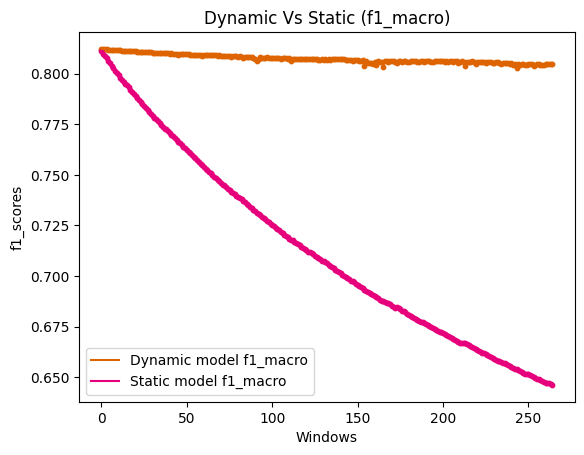

In [ ]:
Plot(range(265),Dynamic_f1_scores,"Dynamic model f1_macro", "#DD6400", "o", 10, "Windows", "f1_scores", "Dynamic Vs Static (f1_macro)")
Plot(range(265),Static_f1_scores,"Static model f1_macro", "#E7007B", "o", 10, "Windows", "f1_scores", "Dynamic Vs Static (f1_macro)")
plt.show()